In [1]:
import numpy as np
import matplotlib.pyplot as plt
import healpy as hp
from tqdm import tqdm

### Constants

In [2]:
c = 299792458.
day_s = 86400.
Om_Earth = 2*np.pi/day_s
print(Om_Earth)

7.27220521664304e-05


### Detectors information
The general coordinate system is WGS-84 Earth Model, described in the documentation of [lal_detector](https://lscsoft.docs.ligo.org/lalsuite/lal/group___l_a_l_detectors__h.html),  
and the document [T980044](https://dcc.ligo.org/public/0002/T980044/001/T980044-10.pdf).

In [3]:
#LIGO-Hanford, LIGO-Livingston, Virgo
#https://dcc.ligo.org/public/0072/P000006/000/P000006-D.pdf
#https://journals.aps.org/prd/pdf/10.1103/PhysRevD.63.042003

u_H = np.array([-0.223891216, 0.799830697, 0.556905359])
v_H = np.array([-0.913978490, 0.0260953206, -0.404922650])
L_H = 4000
x_H = np.array([-2161414.92635999, -3834695.17889000, 4600350.22664000])

u_L = np.array([-0.954574615, -0.141579994, -0.262187738])
v_L = np.array([0.297740169, -0.487910627, -0.820544948])
L_L = 4000
x_L = np.array([-74276.04472380, -5496283.71970999, 3224257.01744000])

u_V = np.array([-0.7005, 0.2085, 0.6826])
v_V = np.array([-0.0538, -0.9691, 0.2408])
L_V = 3000
x_V = np.array([4546374., 842990., 4378577.])

#KAGRA
u_K = np.array([-0.3759040, -0.8361583, 0.3994189])
v_K = np.array([0.7164378, 0.01114076, 0.6975620])
L_K_x = 2*1513.2535
L_K_y = 2*1511.611
L_K = (L_K_x + L_K_y)/2
x_K = np.array([-3777336.024, 3484898.411, 3765313.697])

#LIGO-India
#https://dcc.ligo.org/DocDB/0167/T2000158/001/LIO_coordinateSystem.pdf->currently commented
u_I = np.array([0.38496278183, -0.39387275094, 0.83466634811])
v_I = np.array([0.89838844906, -0.04722636126, -0.43665531647])
L_I = 4000
x_I = np.array([1.34897115479e6, 5.85742826577e6, 2.12756925209e6])

#is the one in lal the most updated one?-> nope this is a place-holder
#u_I = np.array([-9.72097635269165039e-01, 2.34576612710952759e-01, -4.23695567519644101e-08])
#v_I = np.array([-5.76756671071052551e-02, -2.39010959863662720e-01, 9.69302475452423096e-01])
#L_I = 4000
#x_I = np.array([1450526.82294155, 6011058.39047265, 1558018.27884102])

#GEO600 #see below
x_G = np.array([3.856310e6, 0.666599e6, 5.019641e6])
u_G = np.array([-0.6261, -0.5522, 0.5506])
v_G = np.array([-0.4453, 0.8665, 0.2255])
L_G = 600

In [4]:
def n_hat(theta, phi):
    ct = np.cos(theta)
    st = np.sin(theta)
    cp = np.cos(phi)
    sp = np.sin(phi)
    
    n_x = st*cp
    n_y = st*sp
    n_z = ct

    return np.squeeze([n_x, n_y, n_z])#.T

def vector_earth_rotation_old(x0, t, t0 = 0):
    x_t = x0[0]*np.cos(Om_Earth*(t-t0)) - x0[1]*np.sin(Om_Earth*(t-t0))
    y_t = x0[0]*np.sin(Om_Earth*(t-t0)) + x0[1]*np.cos(Om_Earth*(t-t0))
    try:
        z_t = [x0[2]]*len(t)
    except TypeError:
        z_t = x0[2]
    #rot_matrix = [[np.cos(Om_Earth*(t-t0)), -np.sin(Om_Earth*(t-t0)), 0.]\
    #             [np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), 0.]\
    #             [0., 0., 1.]]
    return np.array([x_t, y_t, z_t]).T

def vector_earth_rotation(x0, t, t0 = 0):
    try:
        t = np.array(t)
        rot_matrix = [[np.cos(Om_Earth*(np.array(t)-t0)), np.sin(Om_Earth*(t-t0)), np.zeros(len(t))],\
                     [-np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), np.zeros(len(t))],\
                     [np.zeros(len(t)), np.zeros(len(t)), np.ones(len(t))]]
        return np.einsum("ij..., j", np.transpose(rot_matrix, axes =(1,0,2)), x0)
    except TypeError:
        rot_matrix = [[np.cos(Om_Earth*(t-t0)), np.sin(Om_Earth*(t-t0)), 0.],\
                     [-np.sin(Om_Earth*(t-t0)), np.cos(Om_Earth*(t-t0)), 0.],\
                     [0., 0., 1.]]
        return np.einsum("ij, j", np.transpose(rot_matrix), x0)
    #print(np.shape(rot_matrix))
    
    #return np.einsum("ij..., j", rot_matrix, x0)
    

#%timeit vector_earth_rotation_old(np.array([1,0,0]), t=np.arange(0,100000), t0 = 0)
#%timeit vector_earth_rotation(np.array([1,0,0]), t=np.arange(0,100000), t0 = 0)
#24 ms ± 3.54 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)
#13.1 ms ± 538 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
#print(vector_earth_rotation_old(np.array([1,1,1]), t=np.arange(0,100000), t0 = 0))
#print(vector_earth_rotation(np.array([1,1,1]), t=np.arange(0,100000), t0 = 0))

In [5]:
np.shape(vector_earth_rotation(np.array([1,1,1]), t=np.arange(0,10), t0 = 0))

(10, 3)

In [6]:
def time_delay(x1 = x_H, x2 = x_L, nside = 8, t=0, t0=0):
    theta, phi = hp.pix2ang(nside, range(0, hp.nside2npix(nside)))
    #print(np.shape( n_hat(theta, phi)), np.shape(vector_earth_rotation(x1-x2, t, t0 = 0)))
    return np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c
                     
def simple_fisher(x1 = x_H, x2 = x_L, t=0, f = 1, nside = 8, t0=0):
    theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))
    orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #orf2 = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #print(np.shape(orf))
    fisher_t = np.einsum("...i,...j",np.conjugate(orf), orf)
    if np.shape(fisher_t)[0]!= hp.nside2npix(nside):
        fisher_t = np.sum(fisher_t, axis = 0)
    return fisher_t

def simple_dirty_injection(x1 = x_H, x2 = x_L, t=0, f = 1, nside = 8, t0=0, injection = None):
    #print(f)
    theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))
    orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    #orf2 = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x1-x2, t, t0), n_hat(theta, phi))/c)
    dirty_t = np.einsum("...i,...j, j",np.conjugate(orf), orf, injection)
    if np.shape(dirty_t)[0]!= hp.nside2npix(nside):
        dirty_t = np.sum(dirty_t, axis = 0)
    return dirty_t   

In [7]:
from numba import jit, njit, prange

@njit
def simple_fisher_numba_single_time_delay(orf = [0], orf_star = [0]):
    #Numpy beats this
    """
    Time delay is a sky map of orf with shape (12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf))] for j in range(len(orf_star))]
    for i in range(0, len(orf_star)):
        for j in range(0, len(orf)):
            #print(fisher[i][j], orf_star[j]*orf[i])
            fisher[i][j] = orf_star[i]*orf[j]
            #print(fisher[i][j])
        #return fisher
    return fisher

@njit
def simple_fisher_numba_multiple_time_delay(orf = [0. +0.j], orf_star = [0.+0.j]):
    #This push memory issue to higher nside 
    #It seems to outperform numpy, but difference in the imaginary part!
    """
    Time delay is a sky map of orf with shape (ntimes, 12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf[0]))] for j in range(len(orf_star[0]))]
    #print(np.shape(fisher))
    for t in range(0, len(orf_star)):
        for i in range(0, len(orf[t])):
            for j in range(0, len(orf[t])):
                fisher[i][j] += orf_star[t][i]*orf[t][j]
    return fisher

@njit(parallel = True)
def simple_fisher_numba_multiple_time_delay_prange(orf = [0. +0.j], orf_star = [0.+0.j]):
    #This push memory issue to higher nside 
    #It seems to outperform numpy, but difference in the imaginary part!
    """
    Time delay is a sky map of orf with shape (ntimes, 12*nside**2)
    """
    fisher = [[0.+0.j for i in range(len(orf[0]))] for j in range(len(orf_star[0]))]
    print(np.shape(fisher))
    for t in prange(0, len(orf_star)):
        for i in range(0, len(orf[t])):
            for j in range(0, len(orf[t])):
                fisher[i][j] += orf_star[t][i]*orf[t][j]
    return fisher

In [11]:
nside=16
f = 100
freqs = np.logspace(0,3, 100)
times = np.arange(0, day_s, 3600)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [12]:
orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
print(np.shape(orf))
print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

orf = orf.reshape(-1, *orf.shape[-1:])
orf_star = np.conjugate(orf)

(100, 24, 3072)
(2400, 3072)


In [10]:
%time HL_simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))

/home/delillo/.local/lib/python3.8/site-packages/numba/core/ir_utils.py:2152: NumbaPendingDeprecationWarning: 
Encountered the use of a type that is scheduled for deprecation: type 'reflected list' found for argument 'orf' of function 'simple_fisher_numba_multiple_time_delay'.

For more information visit https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-reflection-for-list-and-set-types

File "<ipython-input-7-9c9a2c9161e1>", line 19:
@njit
def simple_fisher_numba_multiple_time_delay(orf = [0. +0.j], orf_star = [0.+0.j]):
^

  warnings.warn(NumbaPendingDeprecationWarning(msg, loc=loc))
/home/delillo/.local/lib/python3.8/site-packages/numba/core/ir_utils.py:2152: NumbaPendingDeprecationWarning: 
Encountered the use of a type that is scheduled for deprecation: type 'reflected list' found for argument 'orf_star' of function 'simple_fisher_numba_multiple_time_delay'.

For more information visit https://numba.readthedocs.io/en/stable/reference/deprecation.html

CPU times: user 1.58 s, sys: 24.7 ms, total: 1.6 s
Wall time: 1.61 s


In [ ]:
#%time HL_simple_fisher_broad_numpy = np.sum([simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0)\
#                                                for f in tqdm(freqs)], axis = 0)

In [ ]:
np.savez(f"HL_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz", HL_simple_fisher_broad=HL_simple_fisher_broad)

## Point source

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

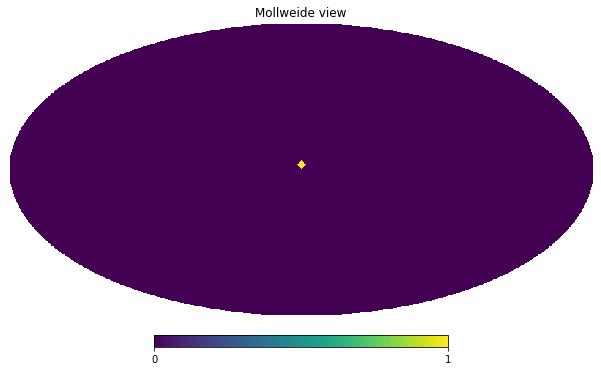

In [22]:
intensity = 1
source = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
#source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.2) & (phi==0.)]=intensity #ok for nside <=8
else:
    source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.05) & (phi==0.)]=intensity #ok for nside >32
#print(source[source ==intensity])

hp.mollview(source)

In [14]:
#HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [15]:
HL_simple_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source)

In [16]:
np.savez(f"HL_ideal_teardrop_nside{nside}_dirty_map_1_1000.npz", HL_simple_dirty_broad=HL_simple_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can

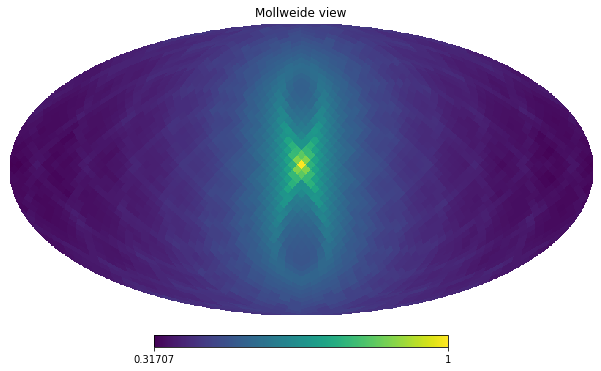

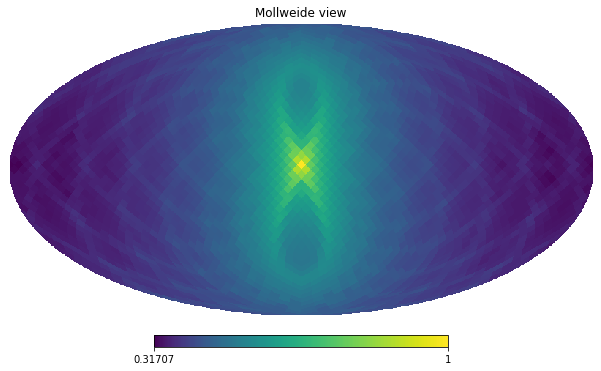

In [17]:
hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_ideal_teardrop_nside{nside}.svg")
plt.savefig(f"HL_ideal_teardrop_nside{nside}.pdf")
#plt.savefig(f"HL_ideal_teardrop_nside{nside}.eps")


hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro", norm="log")
plt.savefig(f"HL_ideal_teardrop_nside{nside}_log.svg")
plt.savefig(f"HL_ideal_teardrop_nside{nside}_log.pdf")
#plt.savefig(f"HL_ideal_teardrop_nside{nside}_log.eps")


## 3-point source

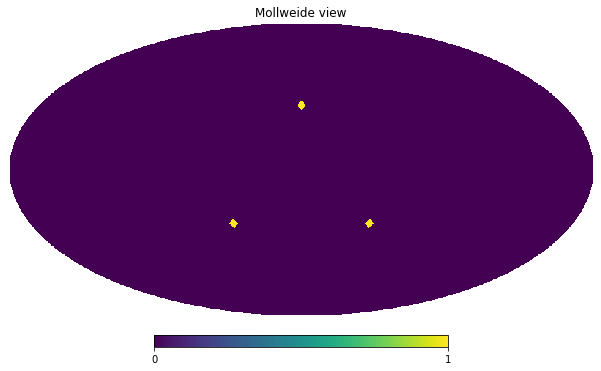

In [180]:
intensity = 1
source_triangle = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_triangle[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
else:
    source_triangle[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_triangle[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_triangle)

In [19]:
#HL_simple_triangle_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source_triangle)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [20]:
HL_simple_triangle_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_triangle)

In [21]:
np.savez(f"HL_ideal_triangle_nside{nside}_dirty_map_1_1000.npz", HL_simple_triangle_dirty_broad=HL_simple_triangle_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


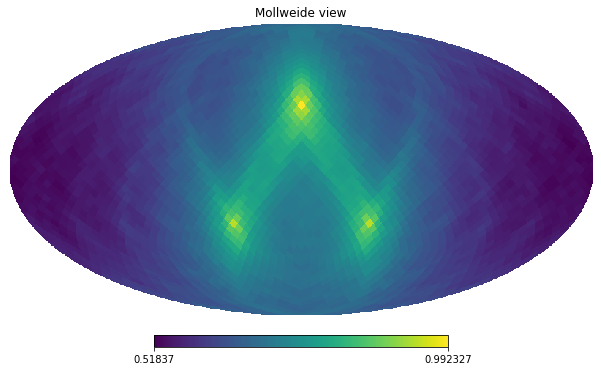

In [22]:
hp.mollview(HL_simple_triangle_dirty_broad/np.max(np.abs(HL_simple_triangle_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_ideal_triangle_nside{nside}.svg")
plt.savefig(f"HL_ideal_triangle_nside{nside}.pdf")
#plt.savefig(f"HL_ideal_triangle_nside{nside}.eps")

## 6-point source

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

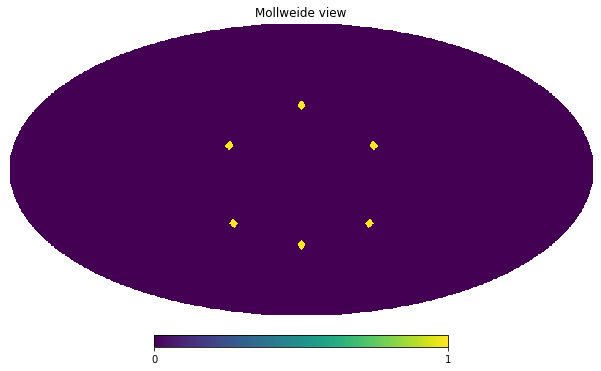

In [23]:
intensity = 1
source_star = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.1) & (phi==0.)]=intensity #ok for nside >8

else:
    source_star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_star)

In [24]:
#HL_simple_star_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source_star)\
#                                                for f in tqdm(np.logspace(0,3, 100))], axis = 0)

In [25]:
HL_simple_star_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_star)

In [26]:
np.savez(f"HL_ideal_star_nside{nside}_dirty_map_1_1000.npz", HL_simple_star_dirty_broad=HL_simple_star_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


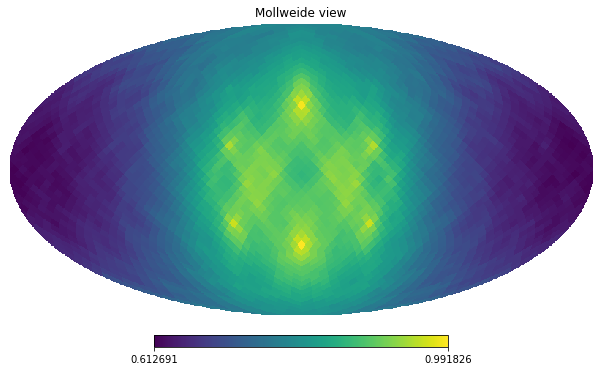

In [27]:
hp.mollview(HL_simple_star_dirty_broad/np.max(np.abs(HL_simple_star_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_ideal_star_nside{nside}.svg")
plt.savefig(f"HL_ideal_star_nside{nside}.pdf")
#plt.savefig(f"HL_ideal_triangle_nside{nside}.eps")

## Dragon ball

/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:922: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a reg

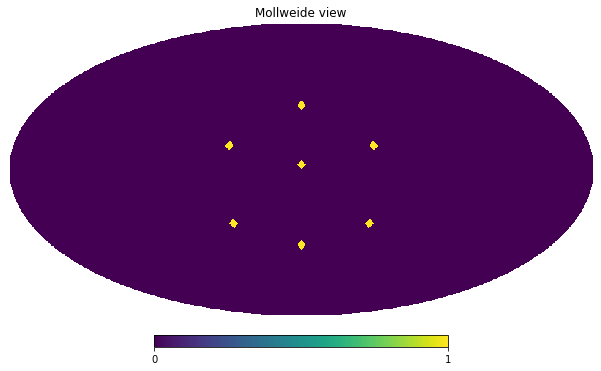

In [28]:
intensity = 1
source_7star = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
if nside<32:
    source_7star[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.1) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.1) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.1) & (phi==0.)]=intensity #ok for nside >8

else:
    source_7star[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)<np.pi/2.25) &(theta>np.pi/2.25-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_7star[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_7star)

In [29]:
HL_simple_7star_dirty_broad = np.einsum("ij, j", HL_simple_fisher_broad, source_7star)

In [30]:
np.savez(f"HL_ideal_7star_nside{nside}_dirty_map_1_1000.npz", HL_simple_7star_dirty_broad=HL_simple_7star_dirty_broad)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


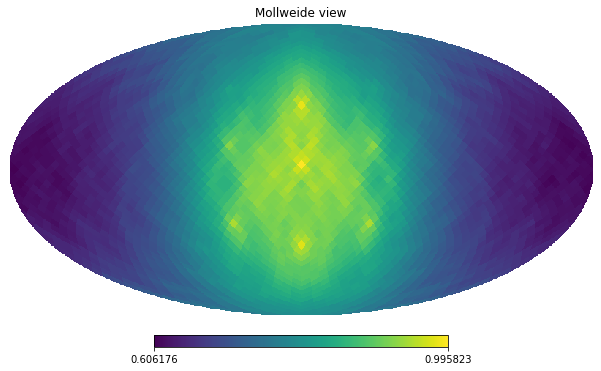

In [31]:
hp.mollview(HL_simple_7star_dirty_broad/np.max(np.abs(HL_simple_7star_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")
plt.savefig(f"HL_ideal_7star_nside{nside}.svg")
plt.savefig(f"HL_ideal_7star_nside{nside}.pdf")
#plt.savefig(f"HL_ideal_triangle_nside{nside}.eps")

[1.4454685  1.52911759 1.61247506 1.69612416 1.78066692 1.86676513]
[871 807 743 680 744 809 872 936]
[0.3436117  0.44178647 0.53996124 ... 2.35619449 3.92699082 5.49778714]


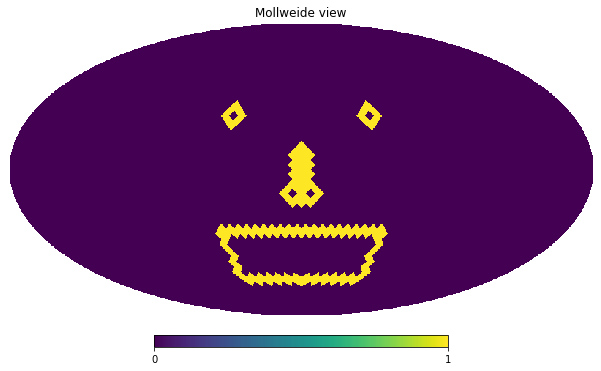

In [155]:
intensity = 1
source_smile = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
print(theta[(phi==0.) & (theta>1.4) & (theta<1.9)])
print(hp.get_all_neighbours(nside, 1.09467727, np.pi/4))
print(phi[(theta > 1.78066692-0.1) & (theta > 1.78066692+0.1)][3:])
if nside<32:
    source_smile[(phi==0.) & (theta>1.4) & (theta<1.9)]=intensity #ok for nside >8
    source_smile[hp.get_all_neighbours(nside, 1.09467727, np.pi/4)] = intensity
    source_smile[hp.get_all_neighbours(nside, 1.09467727, 7*np.pi/4)] = intensity
    source_smile[hp.get_all_neighbours(nside, [1.78066692, 1.78066692,1.69612416, 1.61247506, 1.52911759, 1.4454685],\
                                       [0.04908739, -0.04908739, 0, 0, 0, 0])] = intensity
    
    #source_smile[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    #source_smile[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    
    source_smile[(theta<np.pi-0.5)& (theta>2*np.pi/3) & ((phi<np.pi/4+0.2) | (phi>7*np.pi/4-0.2))] = intensity
    source_smile[(theta<np.pi-0.6)& (theta>2*np.pi/3+0.05) & ((phi<np.pi/4+0.1) | (phi>7*np.pi/4-0.1))] = 0

else:
    #source_smile[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_smile[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_smile[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_smile[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_smile[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_smile[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_smile)

[1.4454685  1.52911759 1.61247506 1.69612416 1.78066692 1.86676513]
[871 807 743 680 744 809 872 936]
[0.3436117  0.44178647 0.53996124 ... 2.35619449 3.92699082 5.49778714]


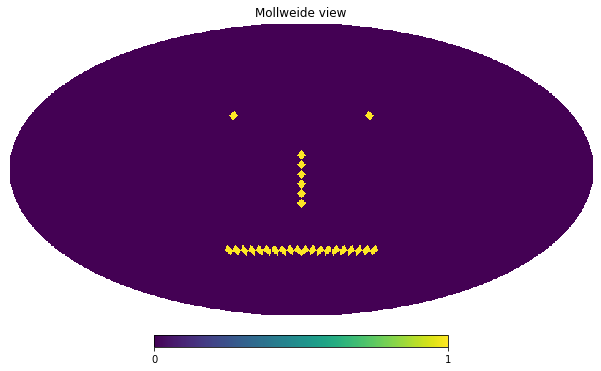

In [192]:
intensity = 1
source_smile2 = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
print(theta[(phi==0.) & (theta>1.4) & (theta<1.9)])
print(hp.get_all_neighbours(nside, 1.09467727, np.pi/4))
print(phi[(theta > 1.78066692-0.1) & (theta > 1.78066692+0.1)][3:])
if nside<32:
    source_smile2[(phi==0.) & (theta>1.4) & (theta<1.9)]=intensity #ok for nside >8
    #source_smile2[hp.get_all_neighbours(nside, 1.09467727, np.pi/4)] = intensity
    #source_smile2[hp.get_all_neighbours(nside, 1.09467727, 7*np.pi/4)] = intensity
    #source_smile2[hp.get_all_neighbours(nside, [1.78066692, 1.78066692,1.69612416, 1.61247506, 1.52911759, 1.4454685],\
    #                                   [0.04908739, -0.04908739, 0, 0, 0, 0])] = intensity
    
    source_smile2[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.1)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.1)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    
    source_smile2[(theta<np.pi-0.8)& (theta>2*np.pi/3+0.2) & ((phi<np.pi/4+0.2) | (phi>7*np.pi/4-0.2))] = intensity
    #source_smile2[(theta<np.pi-0.6)& (theta>2*np.pi/3+0.05) & ((phi<np.pi/4+0.1) | (phi>7*np.pi/4-0.1))] = 0

else:
    #source_smile2[(np.abs(theta)<np.pi/3) &(theta>np.pi/3-0.05) & (phi==0.)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==np.pi/4)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)<2*np.pi/3) &(theta>2*np.pi/3-0.05) & (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.05)& (phi==np.pi/4)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)<np.pi/2.75) &(theta>np.pi/2.75-0.05)& (phi==7*np.pi/4)]=intensity #ok for nside >8
    source_smile2[(np.abs(theta)>np.pi/3) &(theta>2*np.pi/3+0.15) & (phi==0.)]=intensity #ok for nside >8

#print(source[source ==intensity])

hp.mollview(source_smile2)

## N-point sources HLV network 

In [32]:
dx_IJ = [x_H-x_L, x_H-x_V, x_L-x_V]
baselines = ["HL", "HV", "LV", ]
fnames = [f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [33]:
for dx, fname in zip(dx_IJ, fnames):
    print(fname)
    orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HL_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
HV_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LV_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [42]:
HLV_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for fname in fnames:
    HLV_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLV_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLV_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

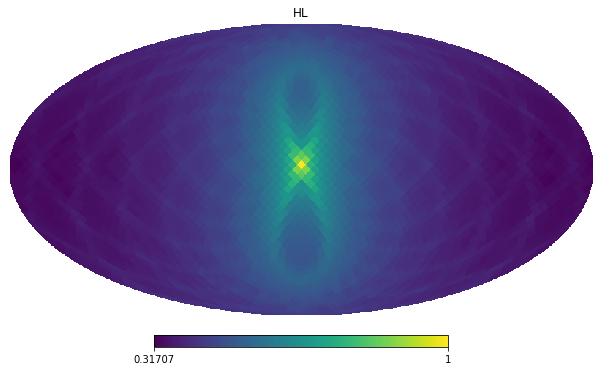

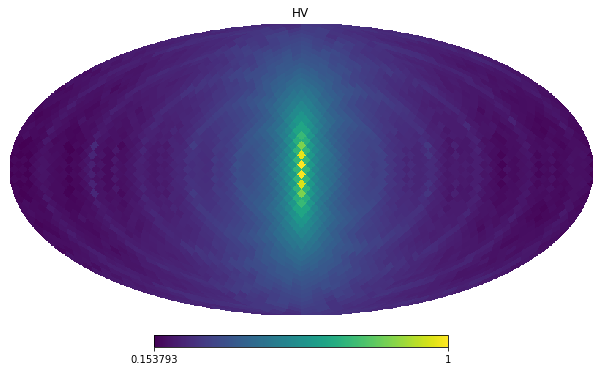

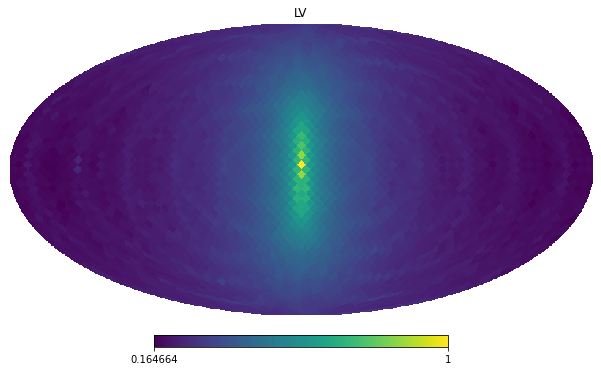

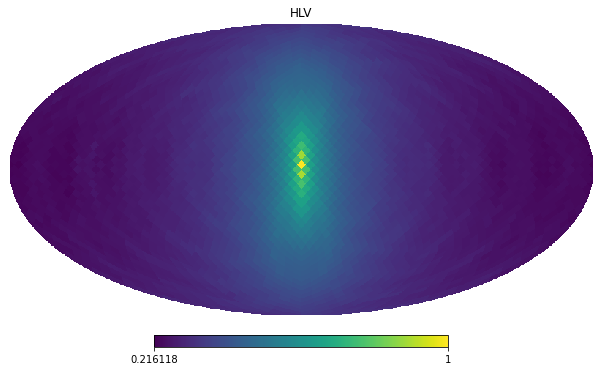

In [51]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

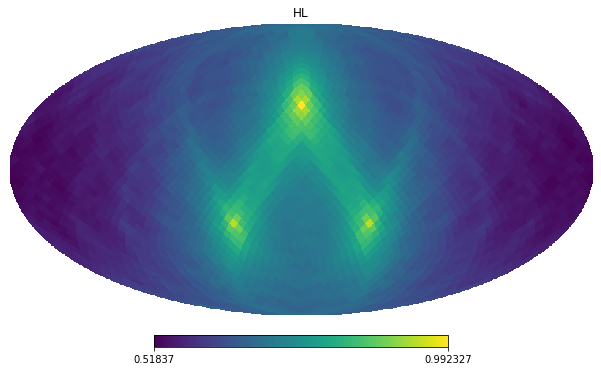

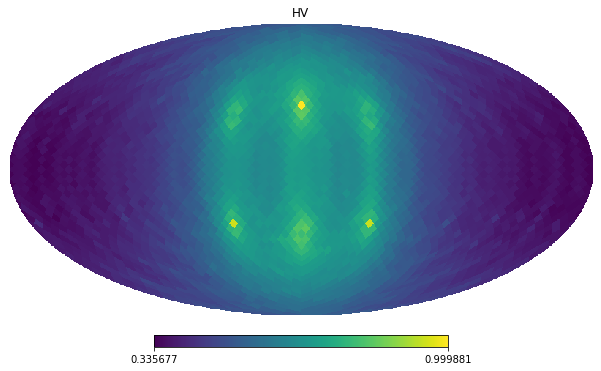

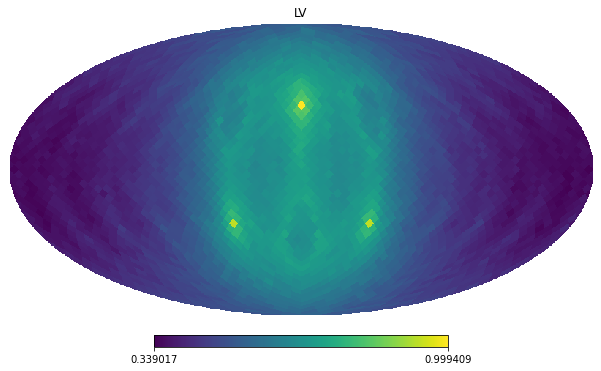

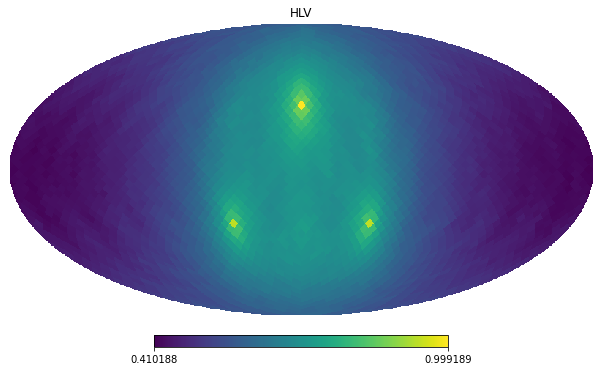

In [52]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

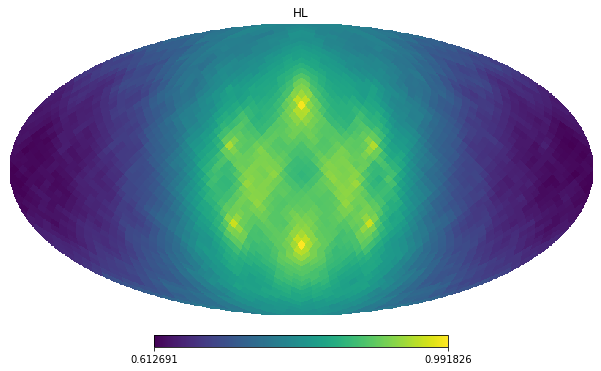

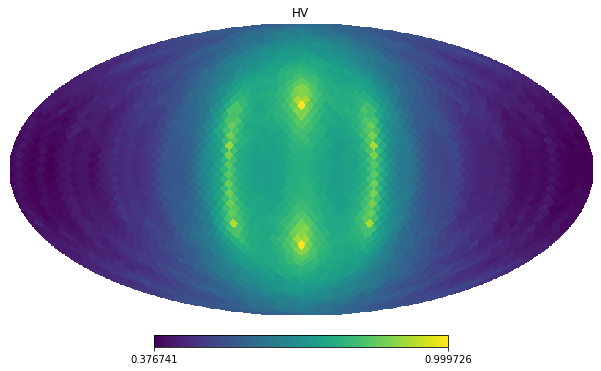

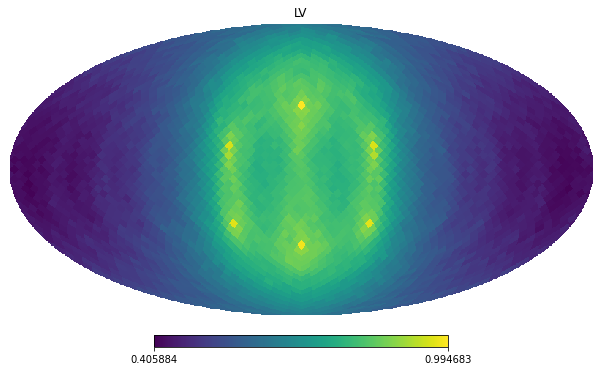

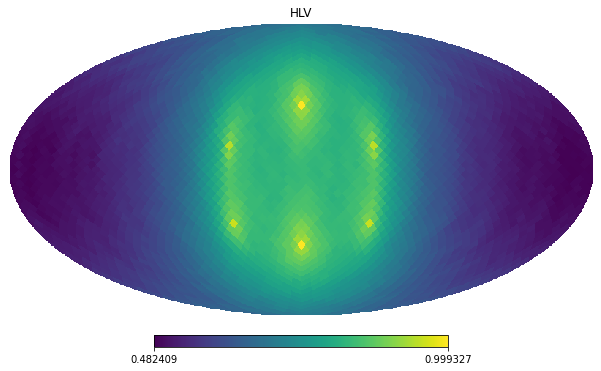

In [53]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

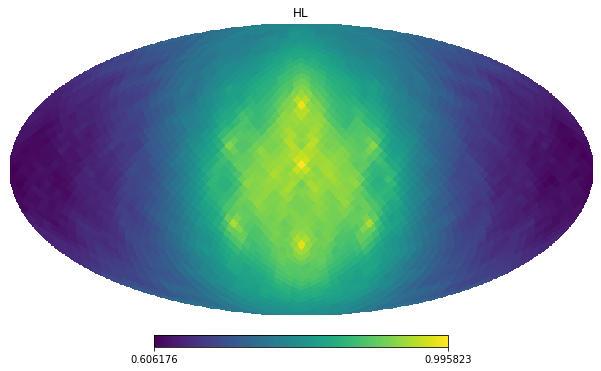

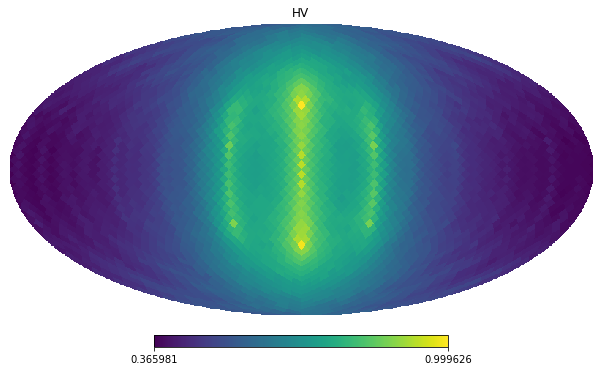

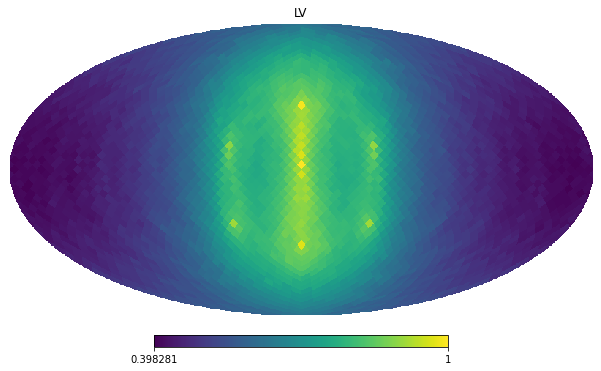

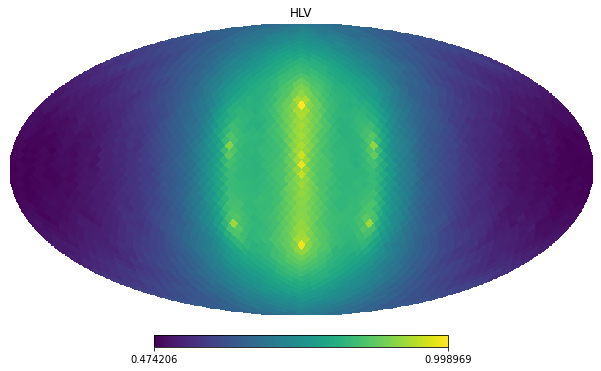

In [54]:
for b in ["HL", "HV", "LV", "HLV"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_7star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_7star_nside{nside}.pdf")

## N-point sources HLVK network 

In [55]:
dx_IJ = [x_H-x_K, x_L-x_K, x_V-x_K]
baselines = ["HK", "LK", "VK", ]
fnames = [f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [56]:
for dx, fname in zip(dx_IJ, fnames):
    print(fname)
    orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HK_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LK_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
VK_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [57]:
HLVK_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
baselines = ["HL", "HV", "LV","HK", "LK", "VK", ]
fnames = [f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]
for fname in fnames:
    HLVK_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLVK_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLVK_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

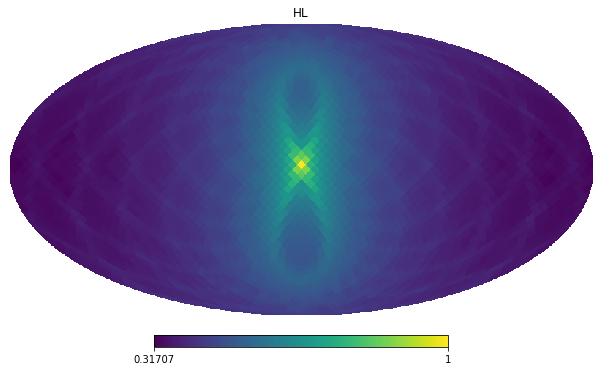

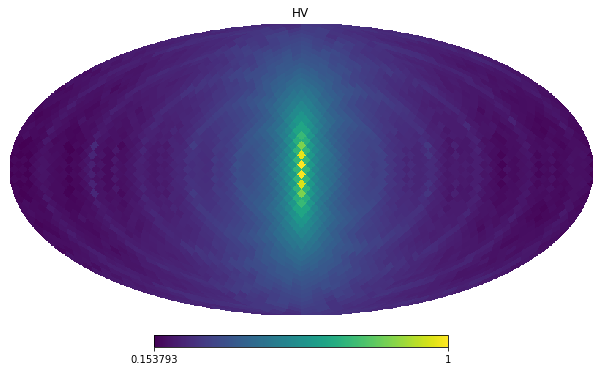

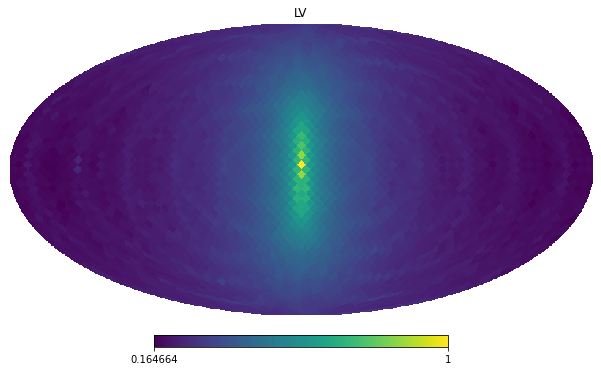

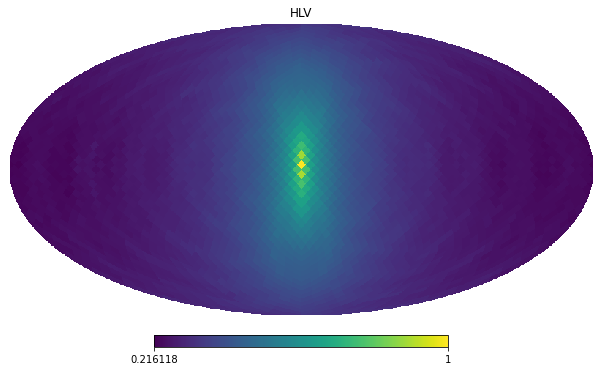

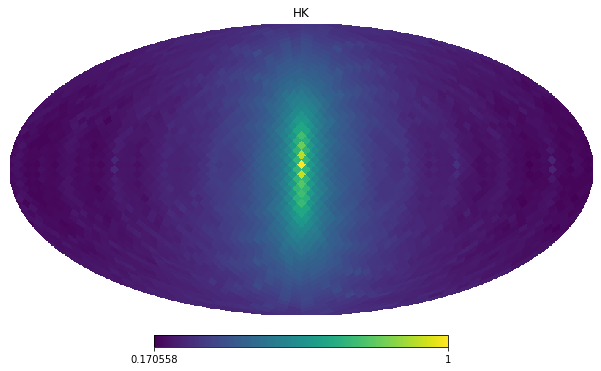

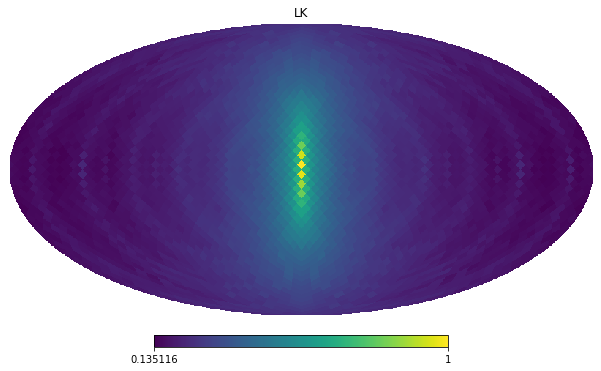

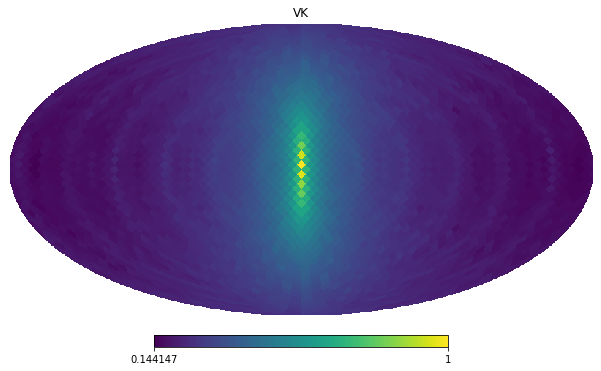

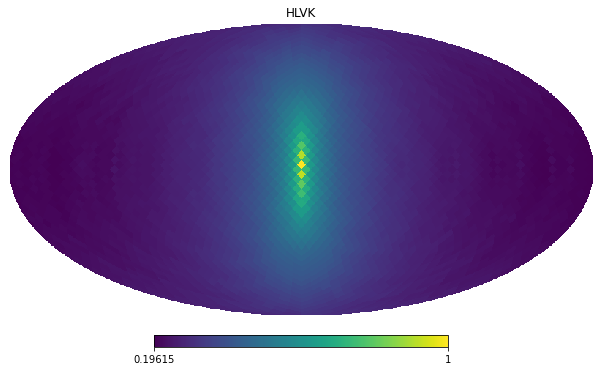

In [58]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

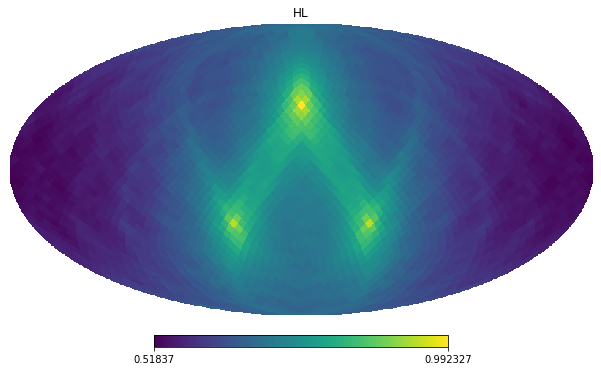

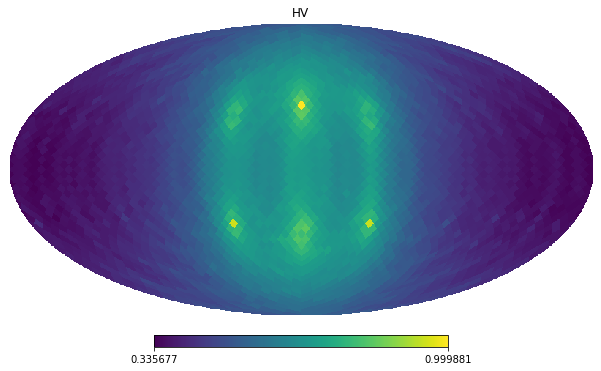

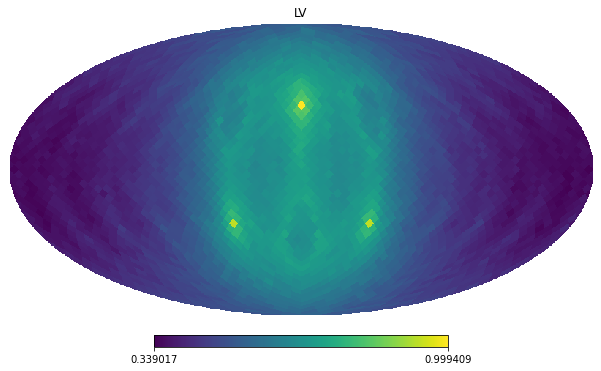

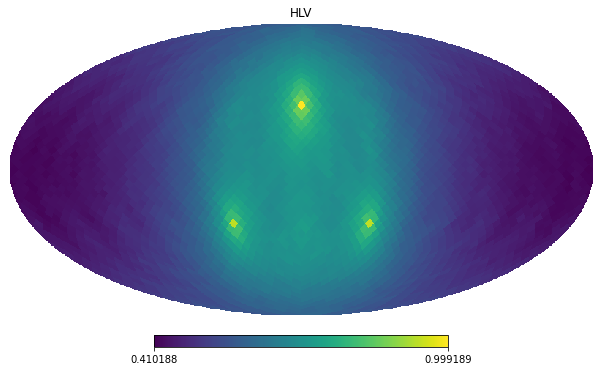

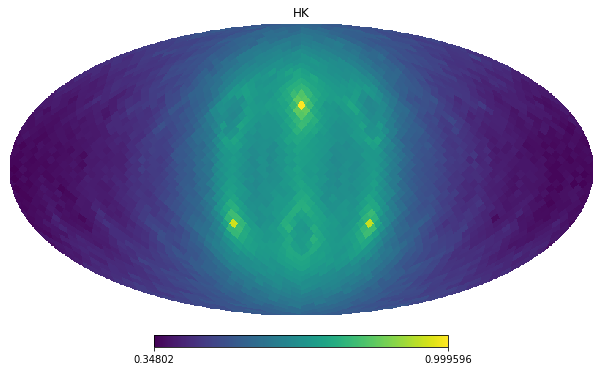

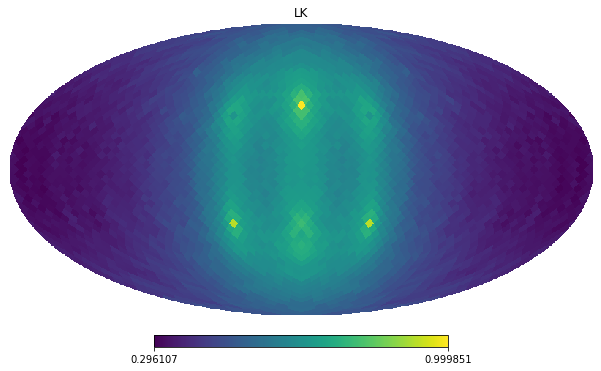

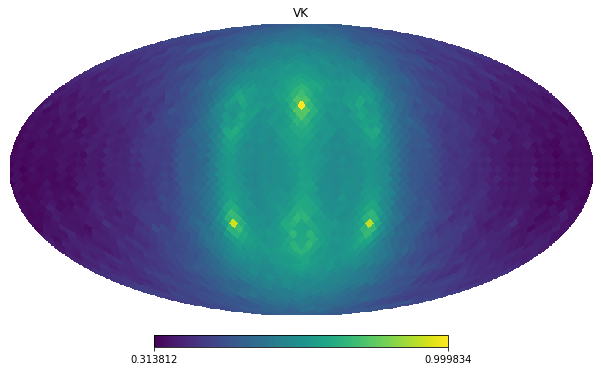

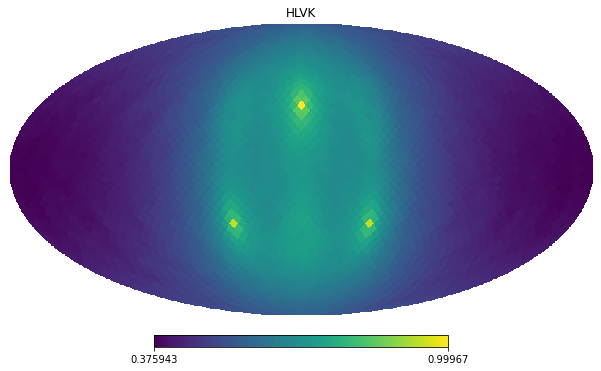

In [59]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

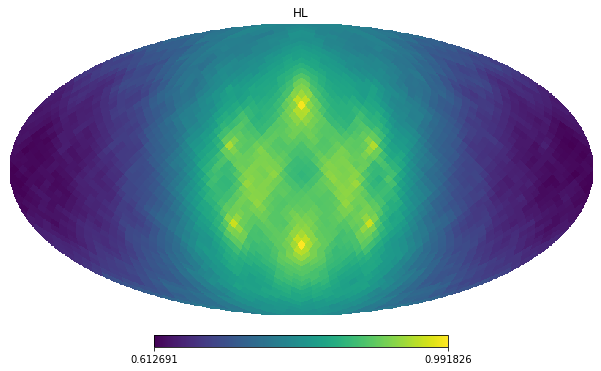

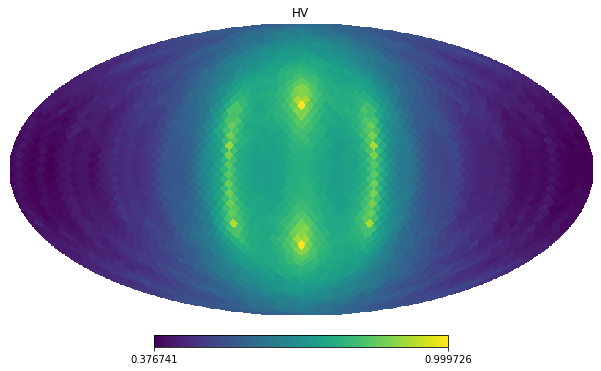

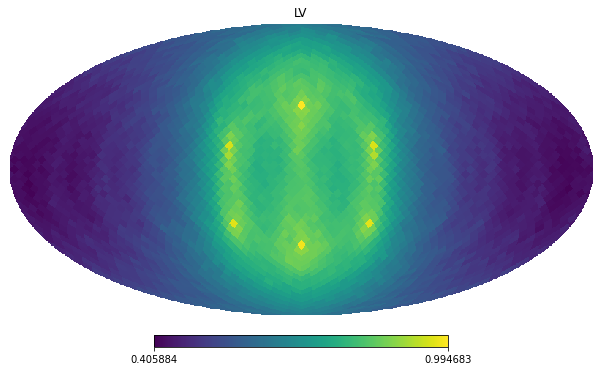

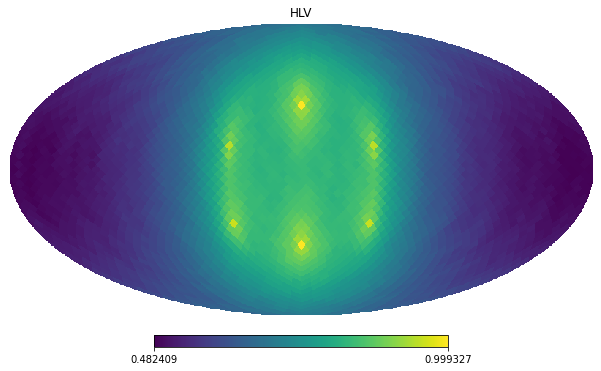

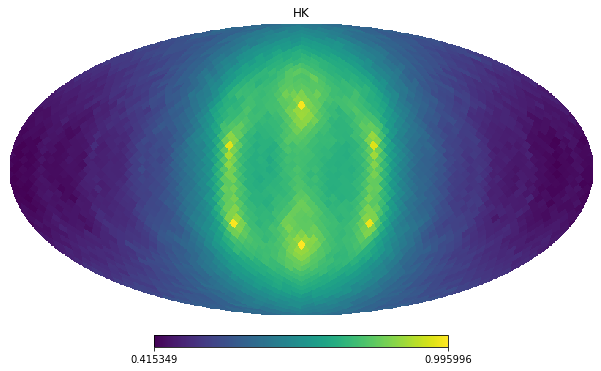

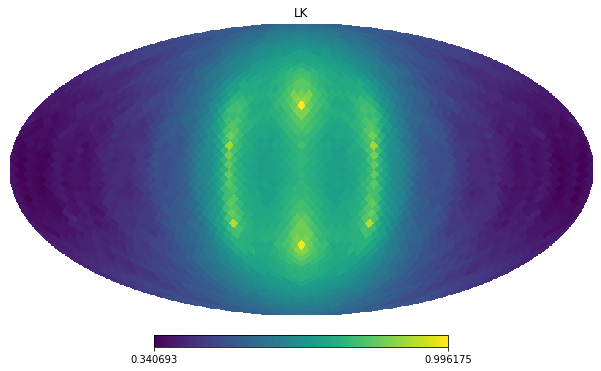

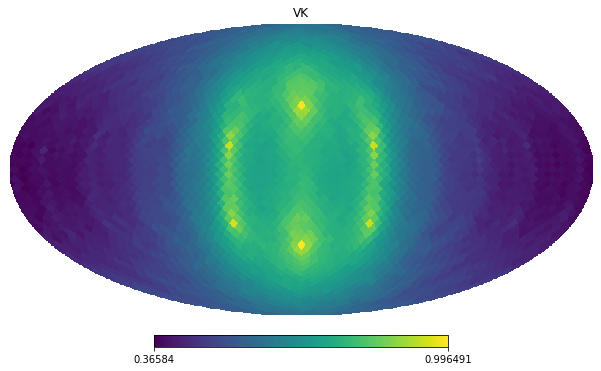

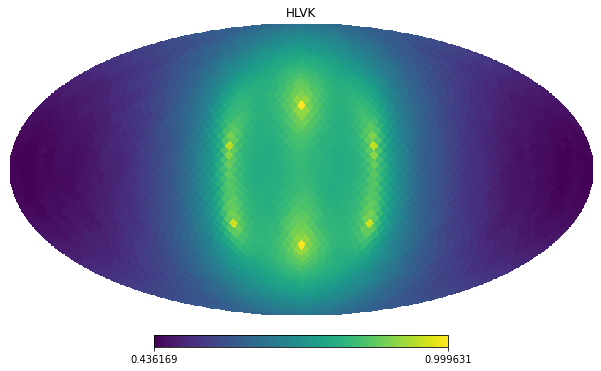

In [60]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

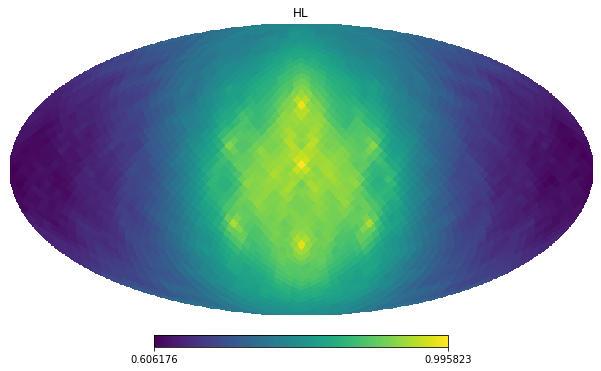

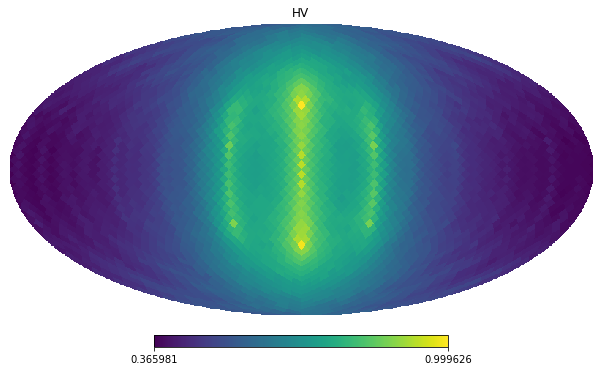

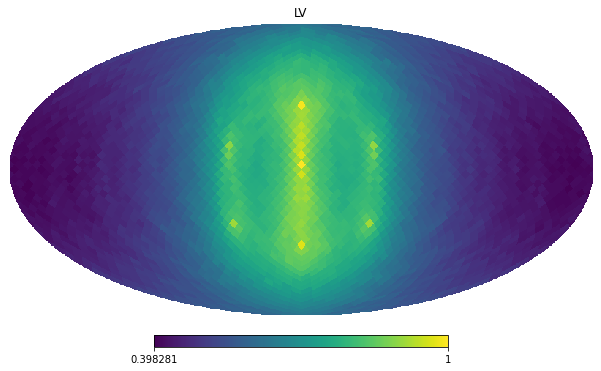

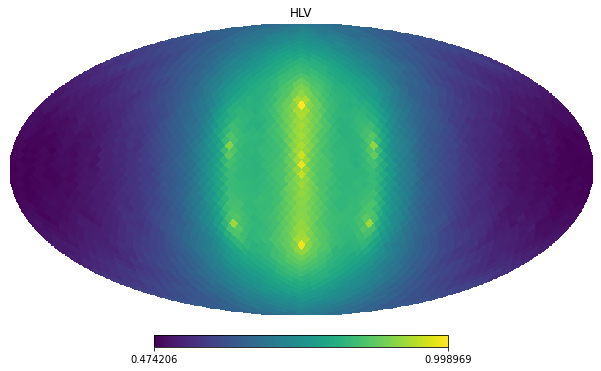

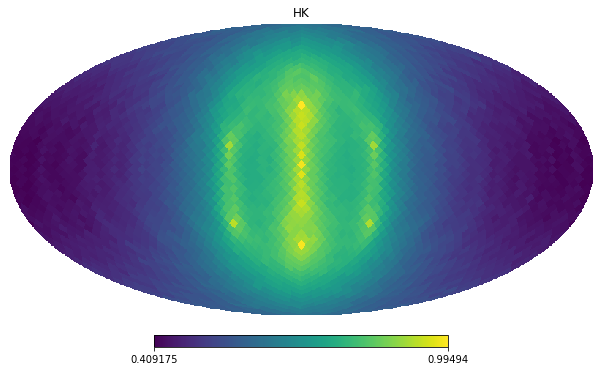

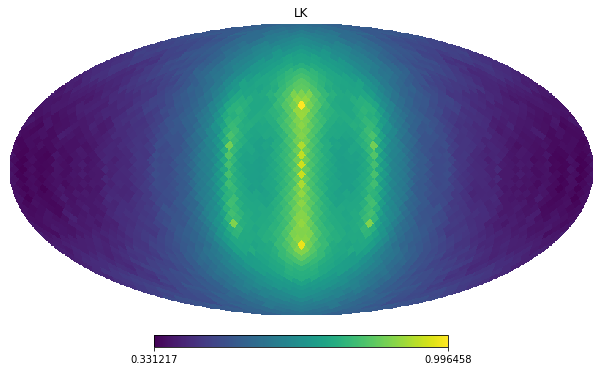

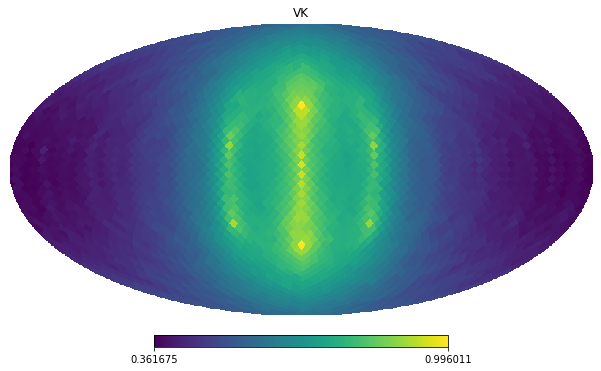

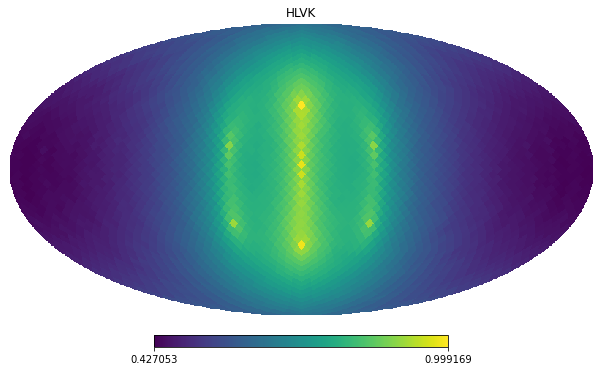

In [61]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_7star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_7star_nside{nside}.pdf")

## N-point sources HLVKI network 

In [62]:
dx_IJ = [x_H-x_I, x_L-x_I, x_V-x_I, x_K-x_I]
baselines = ["HI", "LI", "VI", "KI"]
fnames = [f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]

In [63]:
for dx, fname in zip(dx_IJ, fnames):
    print(fname)
    orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in freqs])
    #print(np.shape(orf))
    #print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

    orf = orf.reshape(-1, *orf.shape[-1:])
    orf_star = np.conjugate(orf)
    
    simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    
    np.savez(fname, simple_fisher_broad=simple_fisher_broad)

HI_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
LI_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
VI_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)
KI_ideal_teardrop_nside16_fisher_full_1_1000.npz
(3072, 3072)


In [64]:
HLVKI_simple_fisher_broad = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
baselines = ["HL", "HV", "LV","HK", "LK", "VK", "HI", "LI", "VI", "KI"]
fnames = [f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz" for b in baselines]
for fname in fnames:
    HLVKI_simple_fisher_broad += np.load(fname)["simple_fisher_broad"]
np.savez(f"HLVKI_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz", simple_fisher_broad=HLVKI_simple_fisher_broad)

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

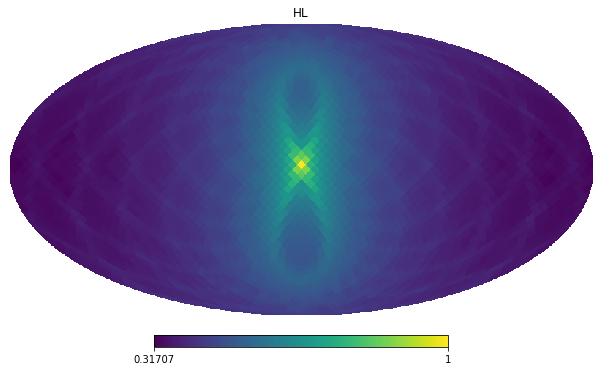

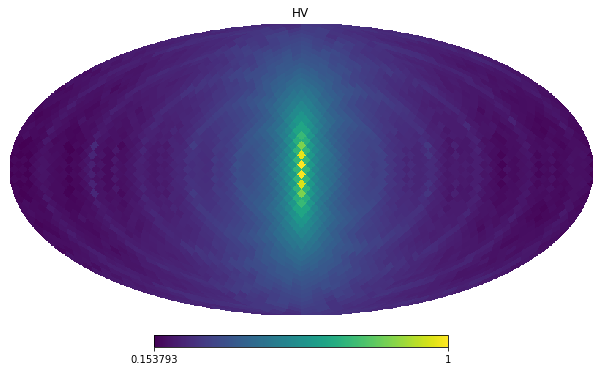

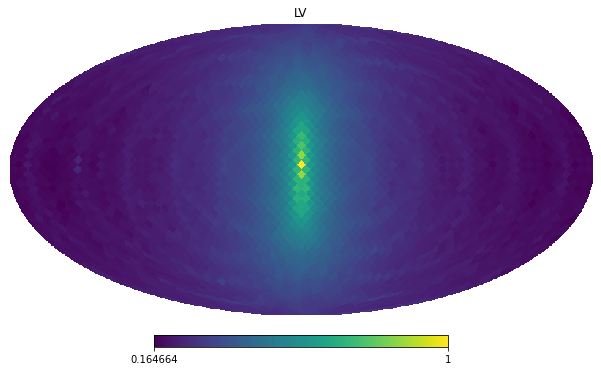

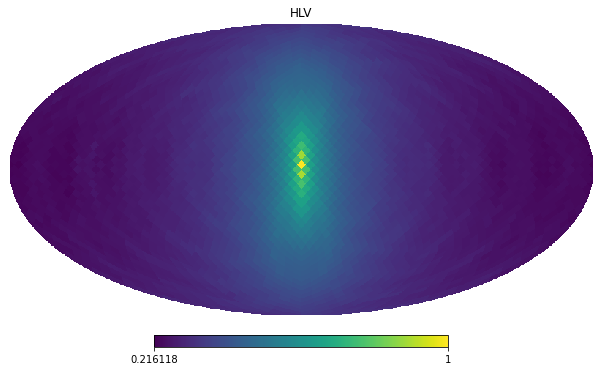

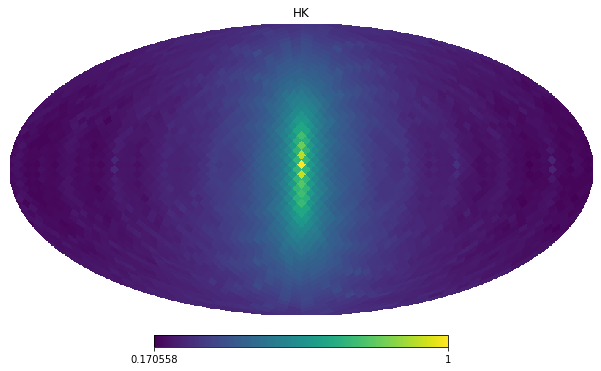

...

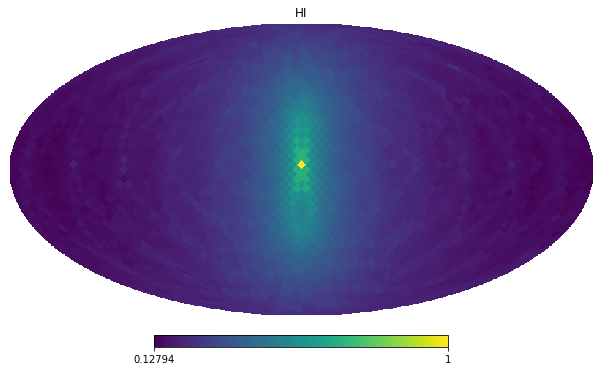

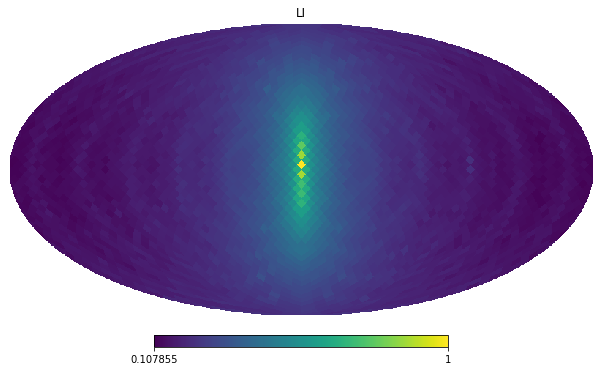

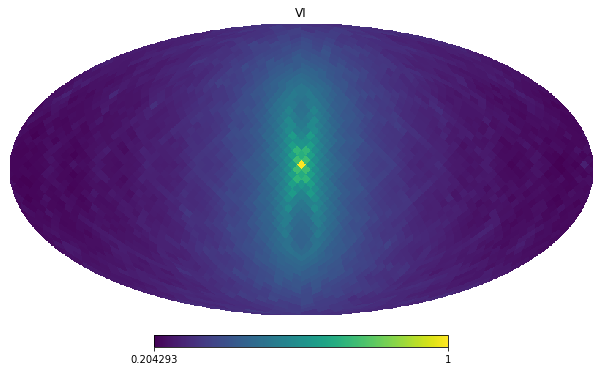

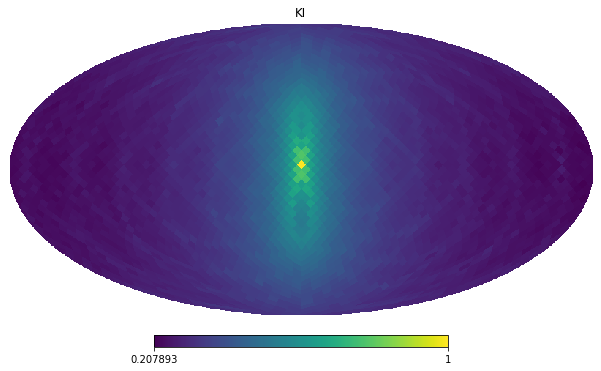

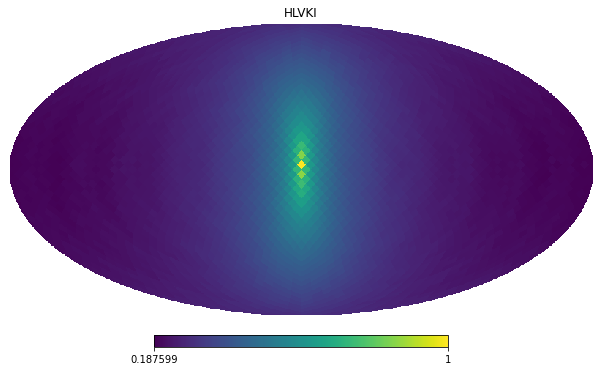

In [65]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_teardrop_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

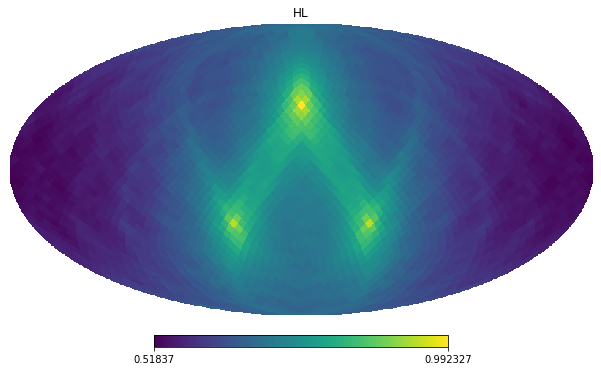

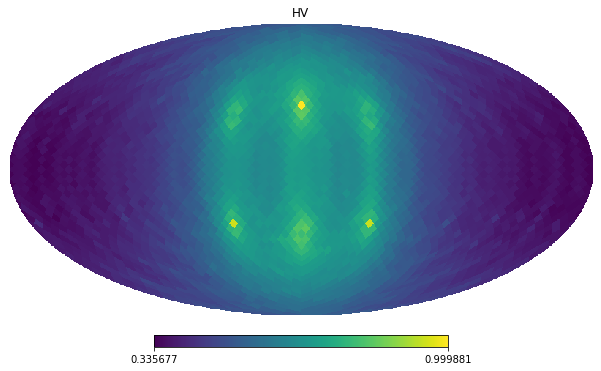

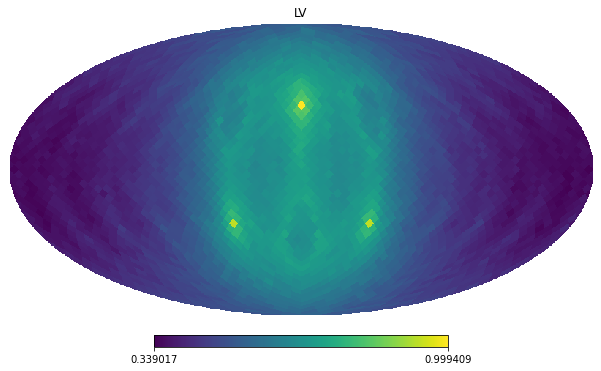

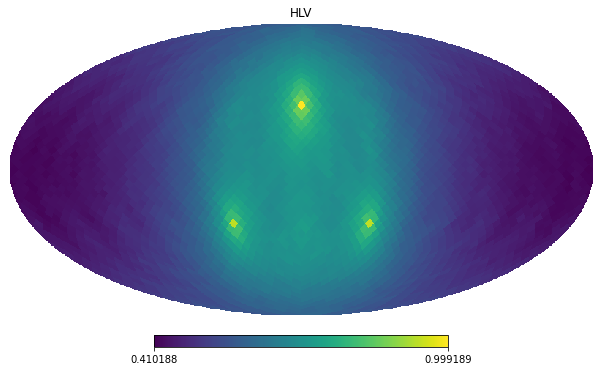

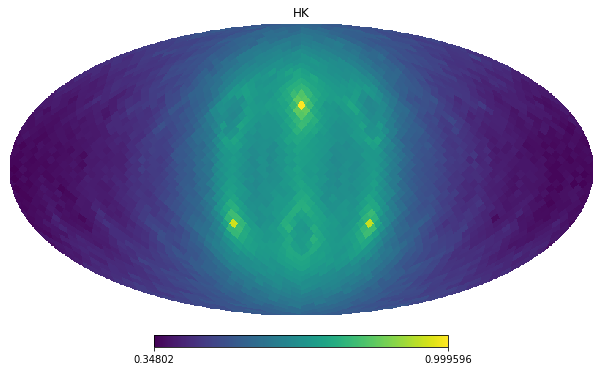

...

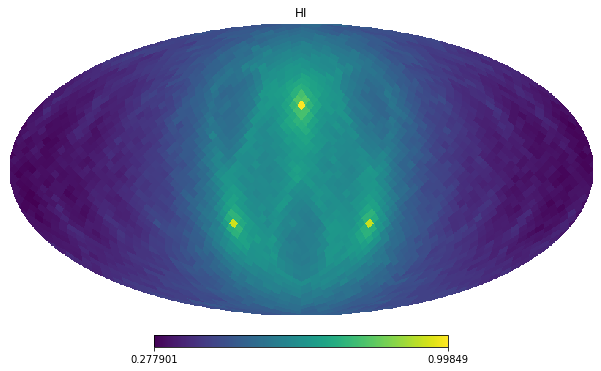

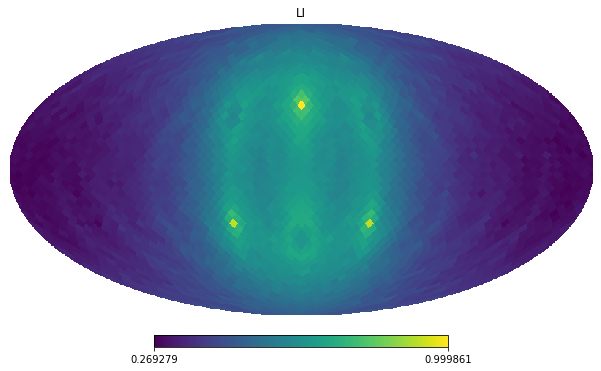

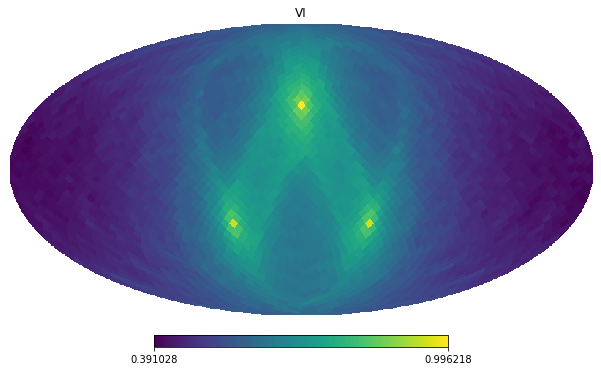

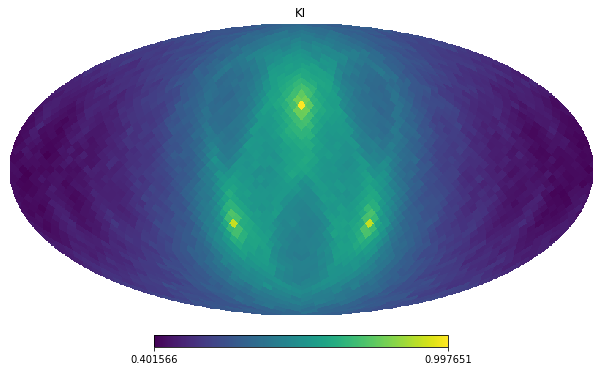

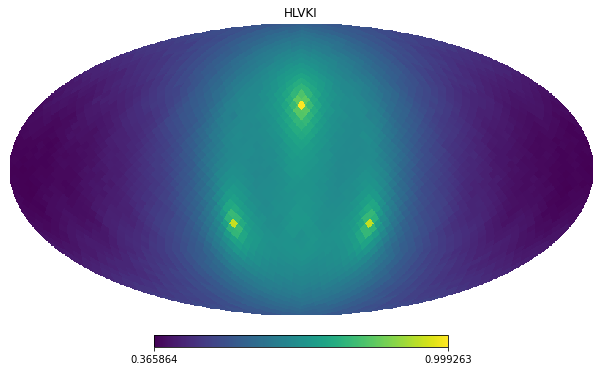

In [66]:
for b in ["HL", "HV", "LV", "HLV","HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_triangle)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_triangle_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

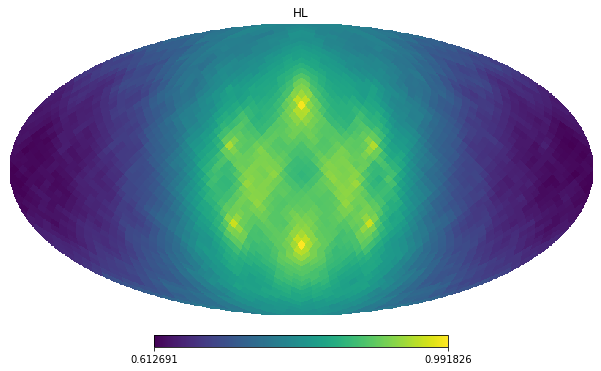

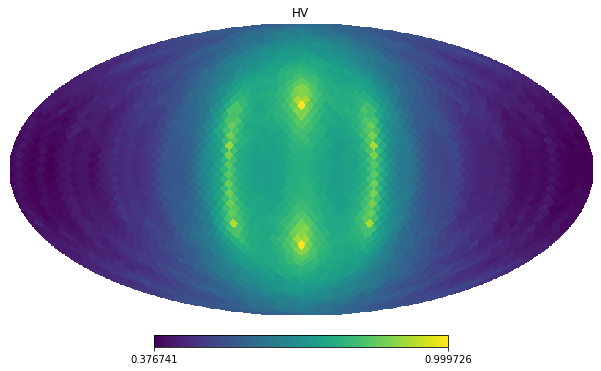

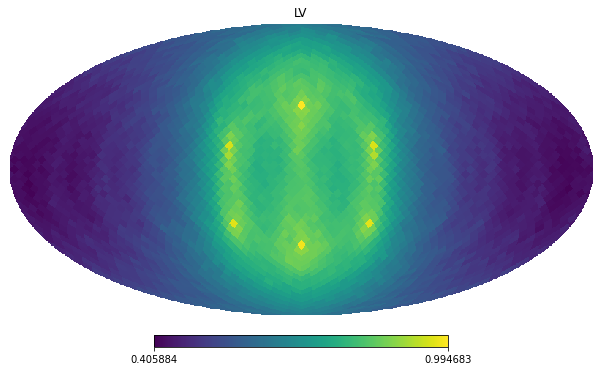

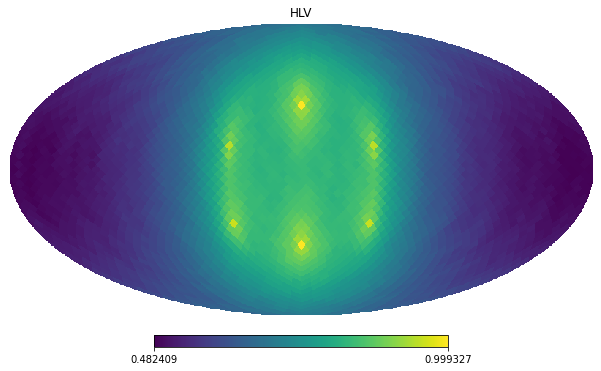

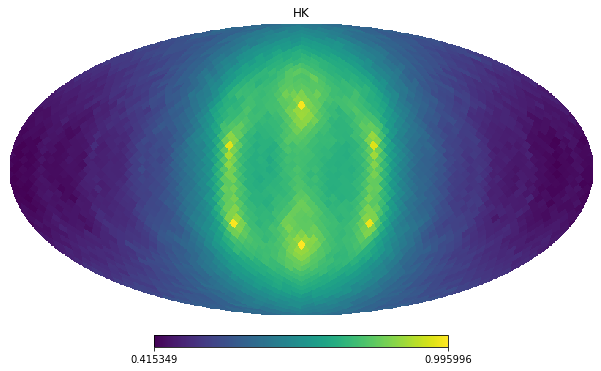

...

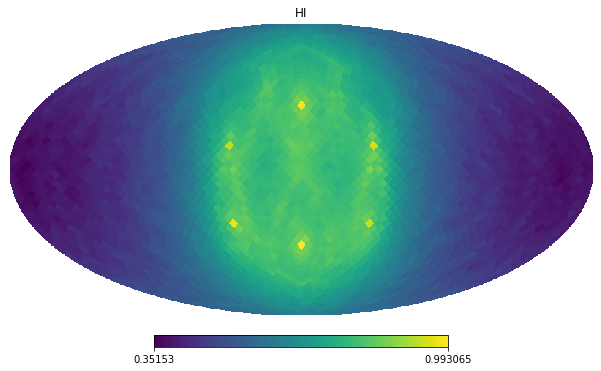

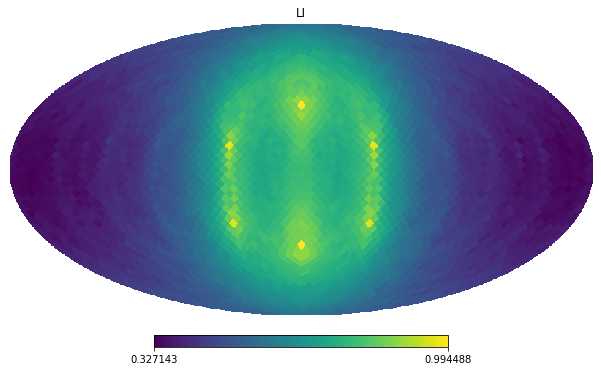

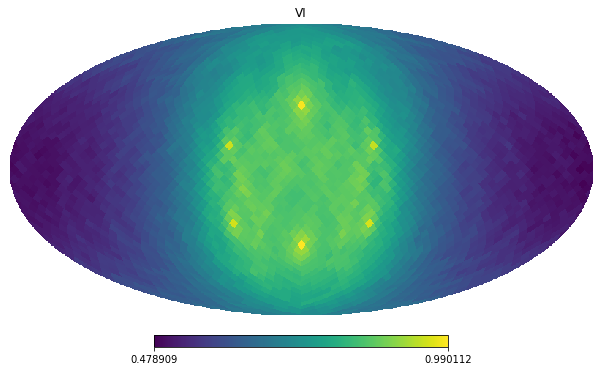

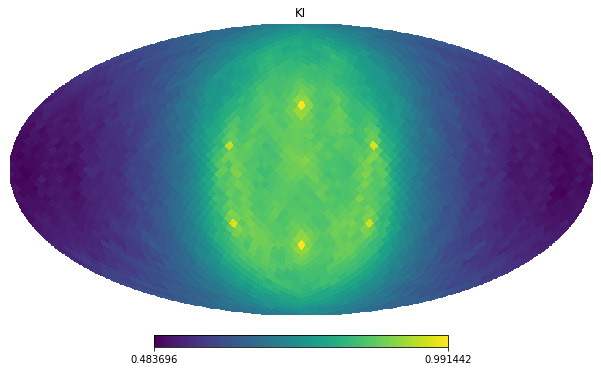

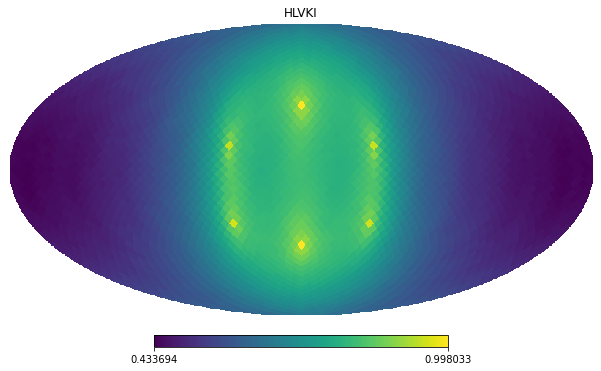

In [67]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

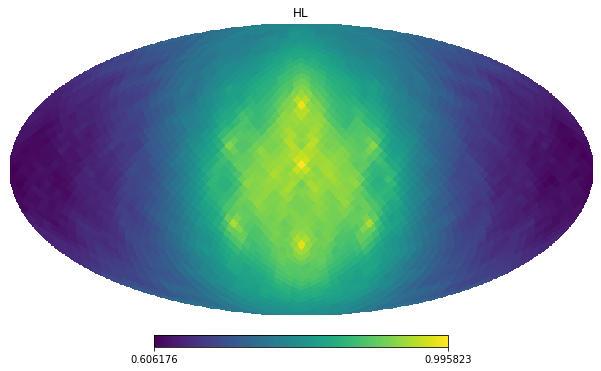

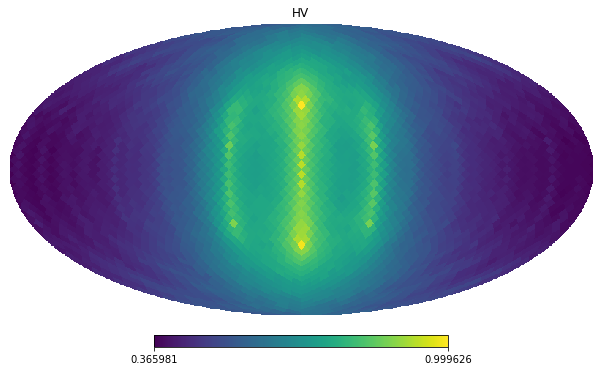

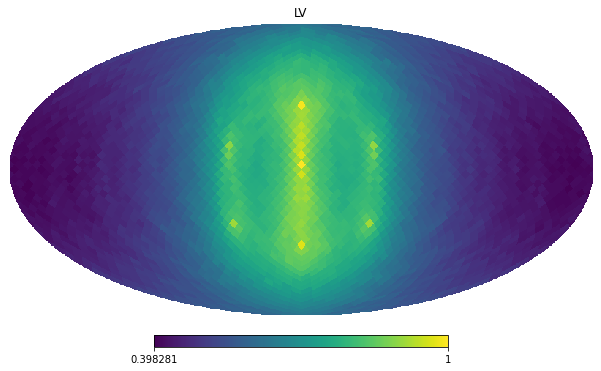

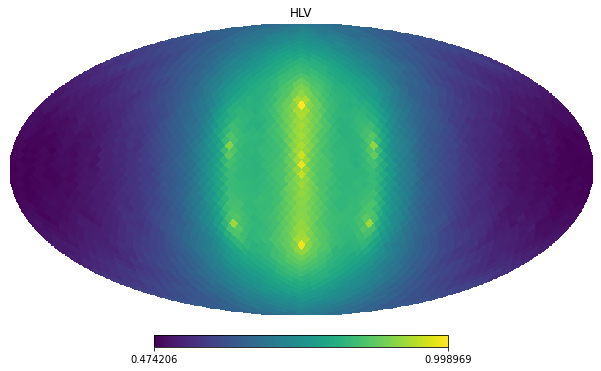

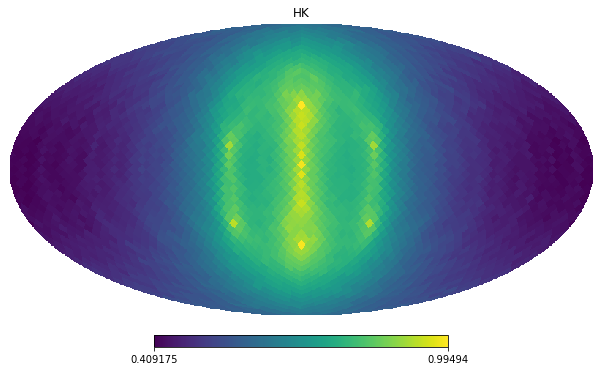

...

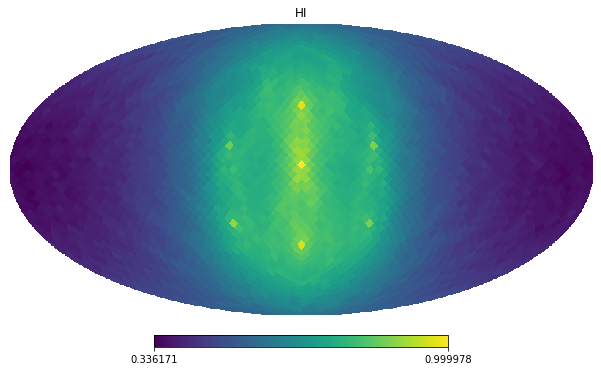

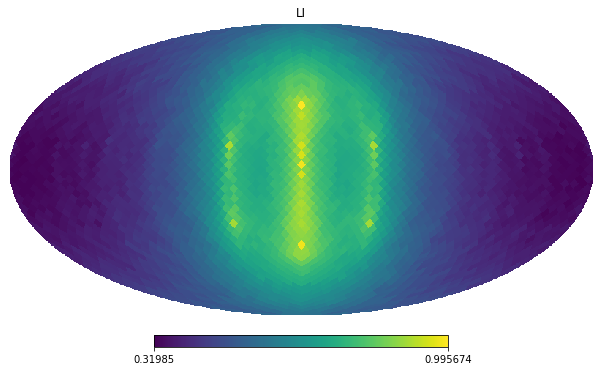

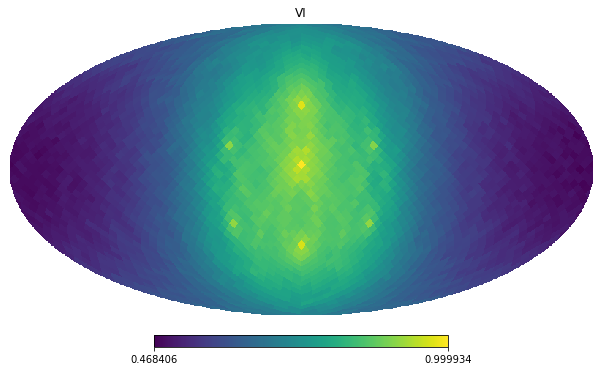

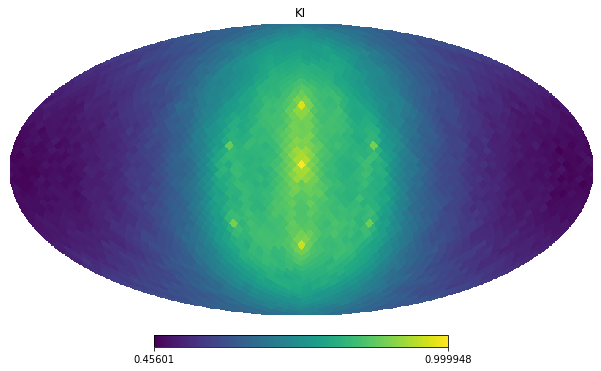

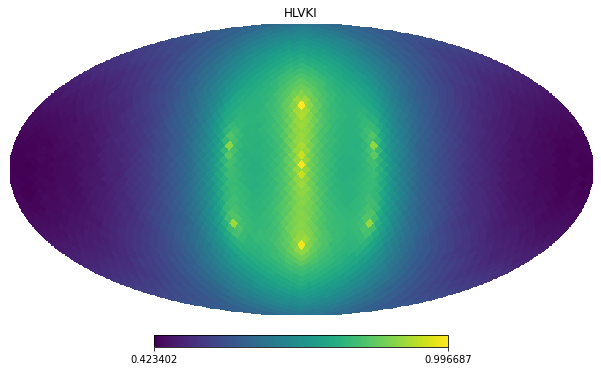

In [68]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_7star)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    plt.savefig(f"{b}_ideal_7star_nside{nside}.svg")
    plt.savefig(f"{b}_ideal_7star_nside{nside}.pdf")

HL


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


HV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLV


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVK


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

LI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

VI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

KI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

HLVKI


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:920: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_over(newcm(1.0))
/home/delillo/.local/lib/python3.8/site-packages/healpy/projaxes.py:921: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. In future versions, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = copy.copy(mpl.cm.get_cmap("viridis"))
  newcm.set_under(bgcolor)
/home/delillo/.local/lib/python3.8/site-packages/healpy/p

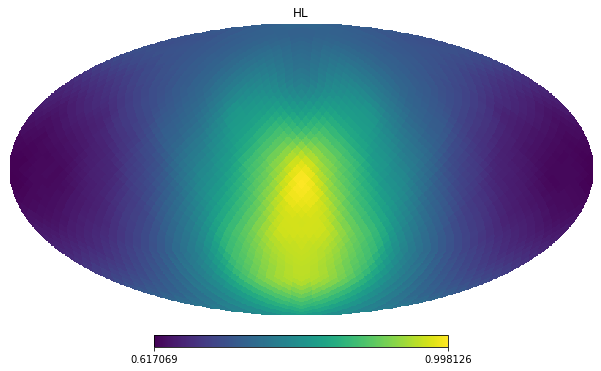

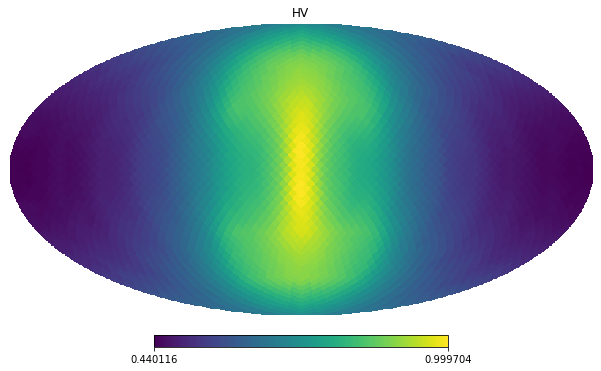

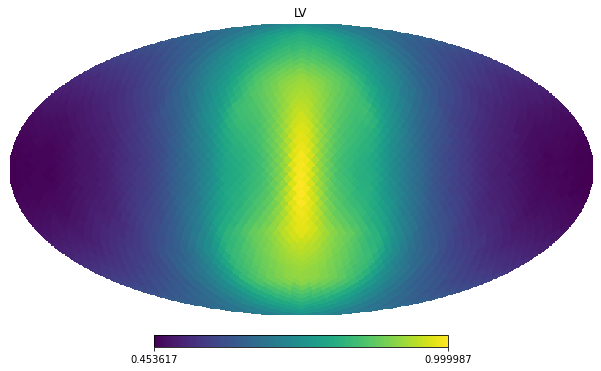

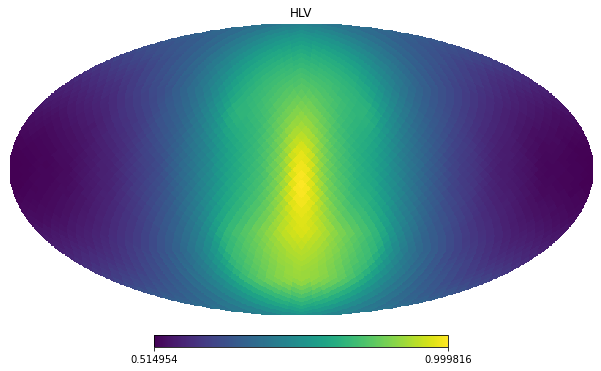

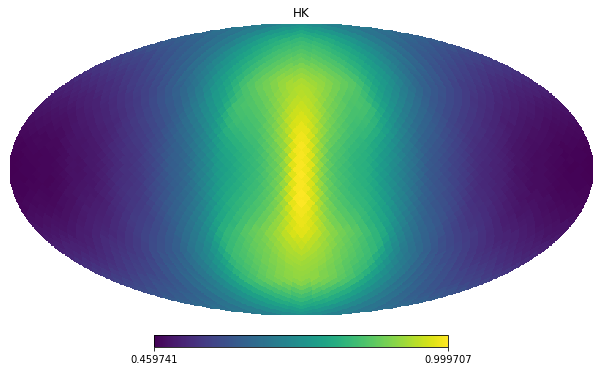

...

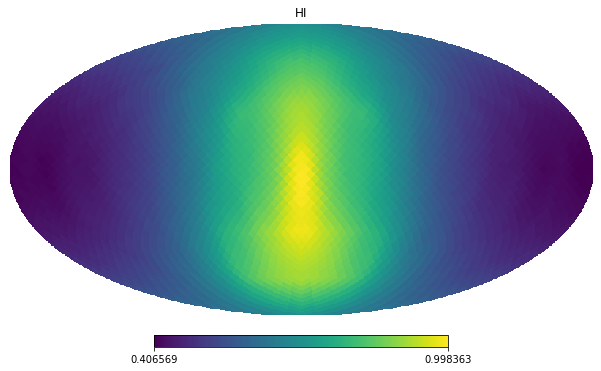

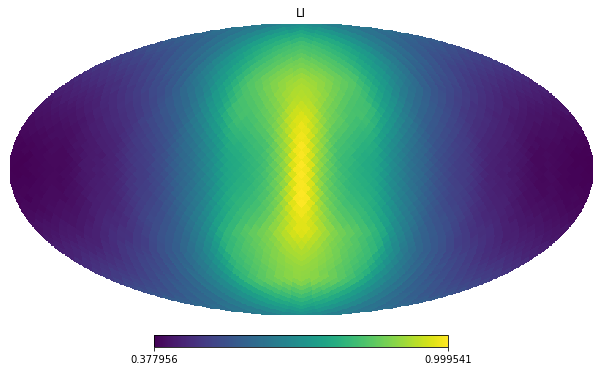

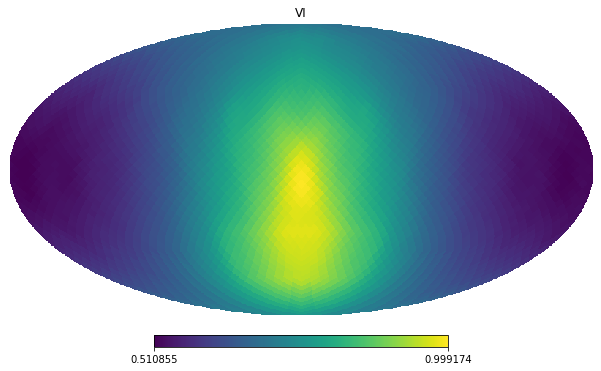

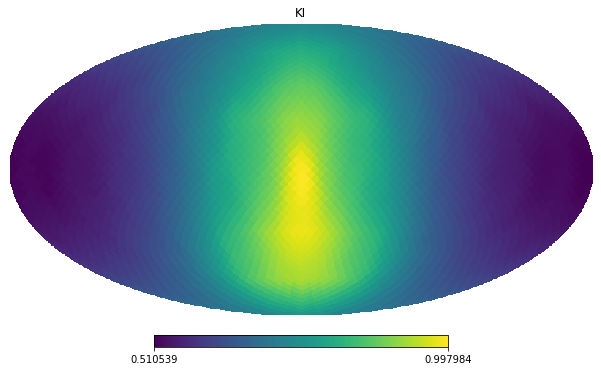

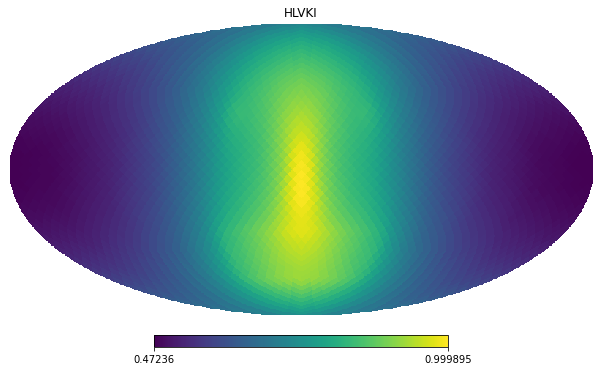

In [157]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_smile)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    #plt.savefig(f"{b}_ideal_smile_nside{nside}.svg")
    #plt.savefig(f"{b}_ideal_smile_nside{nside}.pdf")

HL
HV
LV
HLV
HK
LK
VK
HLVK
HI
LI
VI
KI
HLVKI


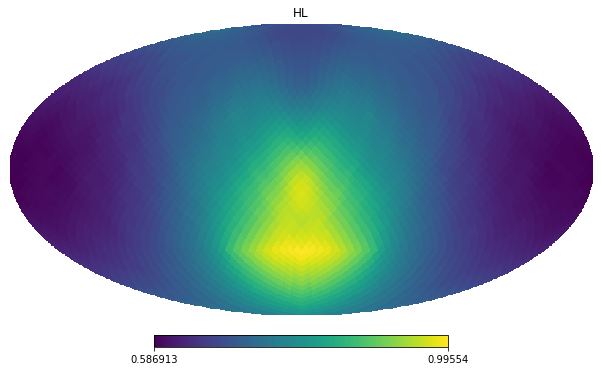

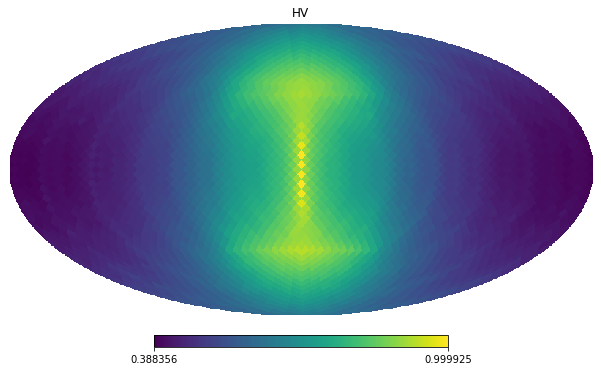

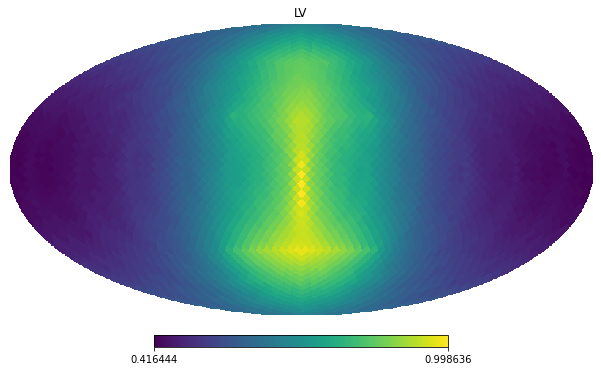

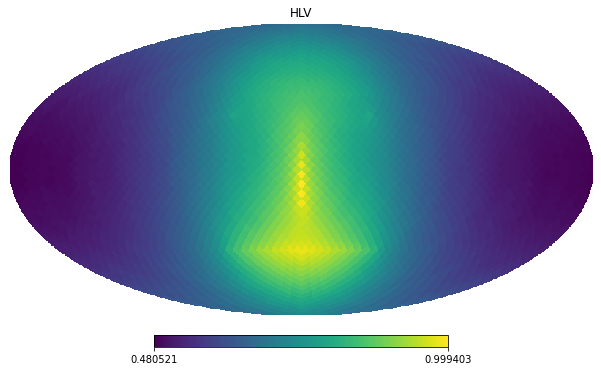

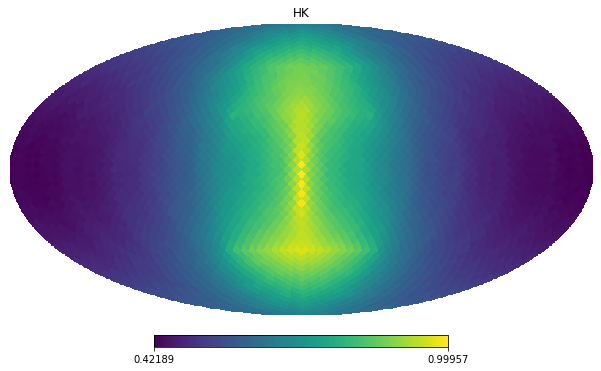

...

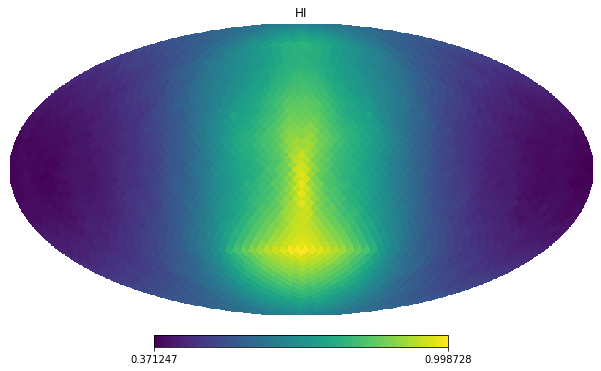

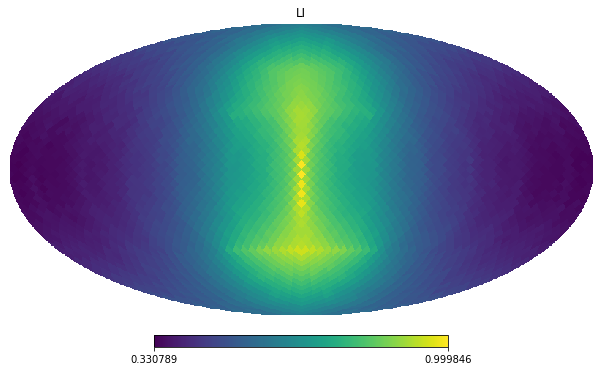

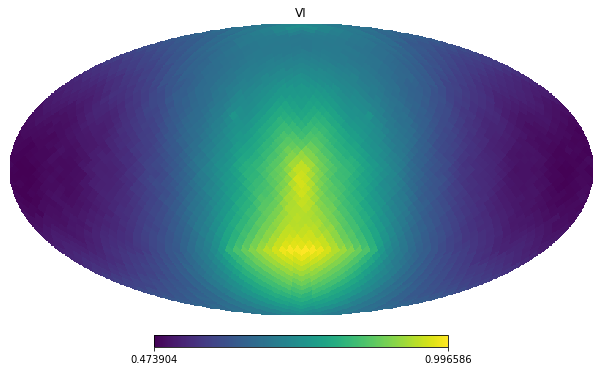

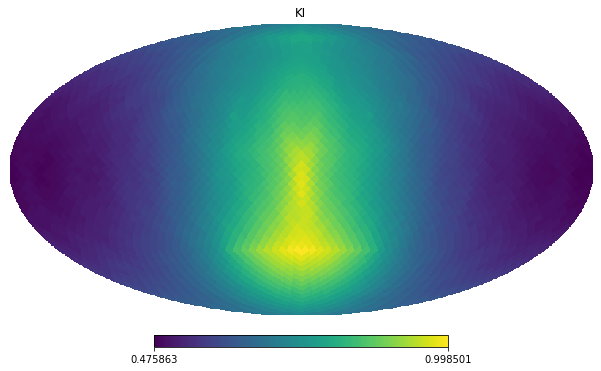

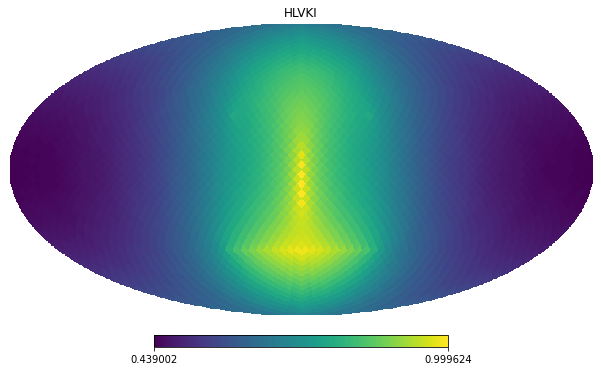

In [193]:
for b in ["HL", "HV", "LV", "HLV", "HK", "LK", "VK","HLVK", "HI", "LI", "VI", "KI", "HLVKI"]:
    print(b)
    fisher = np.load(f"{b}_ideal_teardrop_nside{nside}_fisher_full_1_1000.npz")["simple_fisher_broad"]
    dirty = np.einsum("ij, j", fisher, source_smile2)
    hp.mollview(dirty/np.max(np.abs(dirty)), flip = "astro", title = f"{b}")
    
    #plt.savefig(f"{b}_ideal_smile_nside{nside}.svg")
    #plt.savefig(f"{b}_ideal_smile_nside{nside}.pdf")

# Animation

Current strategy: 
Save png and convert to .gif using `ffmpeg -framerate 3 -i %d.png output.gif`

In [105]:
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation

In [101]:
f = 375

orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(24, 3072) (24, 3072)


In [102]:
fisher_animation_single_time = simple_fisher(x1 = x_H, x2 = x_L, t=0, f = f, nside = nside, t0=0)
fisher_animation = simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))

(3072, 3072)


In [103]:
dirty_animation_single_time = np.einsum("ij, j", fisher_animation_single_time, source)

dirty_animation = np.einsum("ij, j", fisher_animation, source)

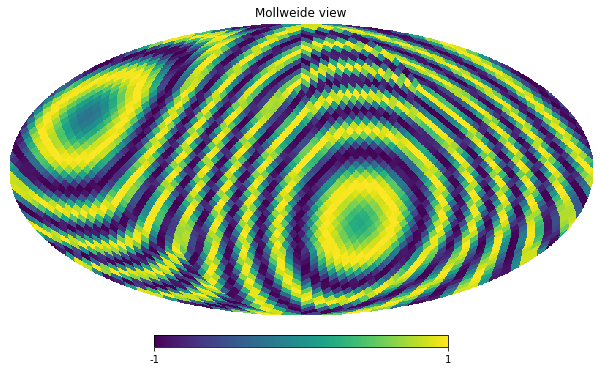

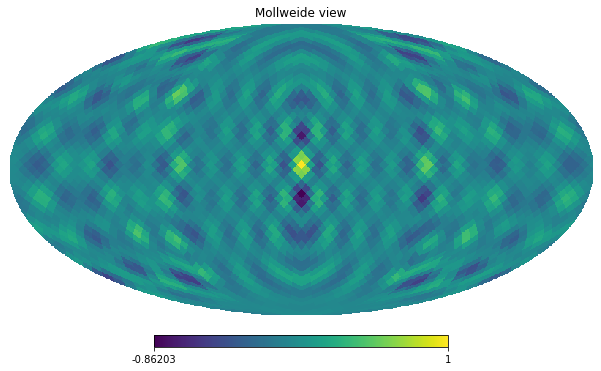

In [104]:
hp.mollview(dirty_animation_single_time/np.max(np.abs(dirty_animation_single_time)))

hp.mollview(dirty_animation/np.max(np.abs(dirty_animation)))

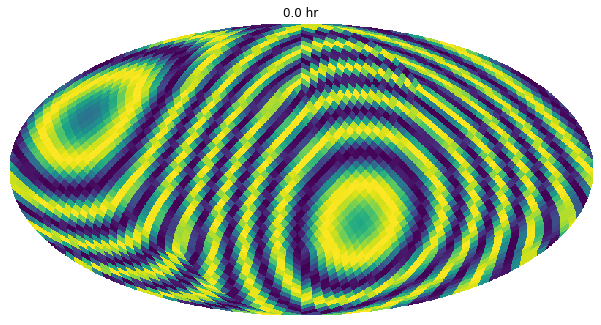

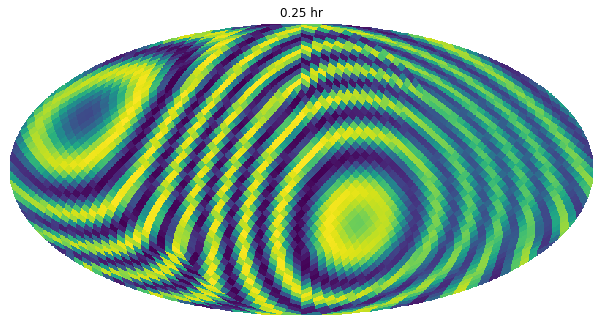

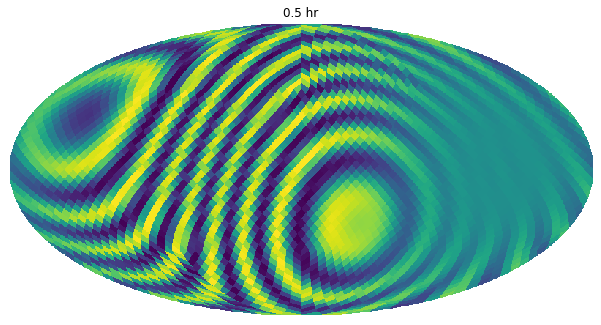

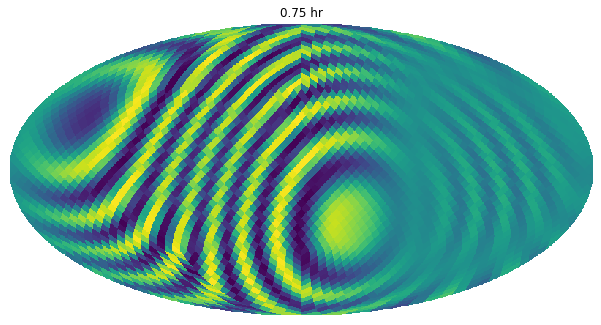

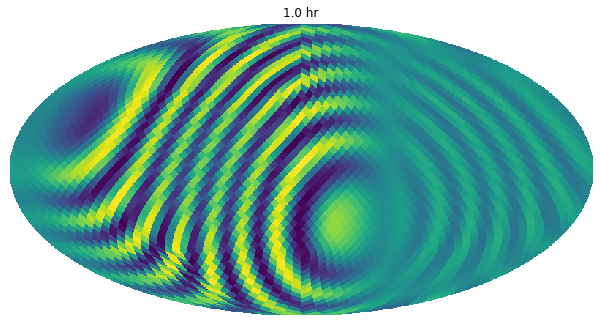

...

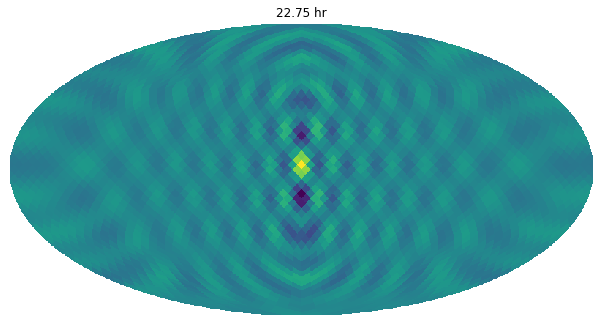

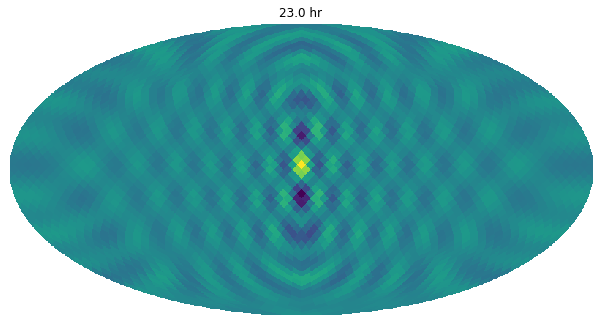

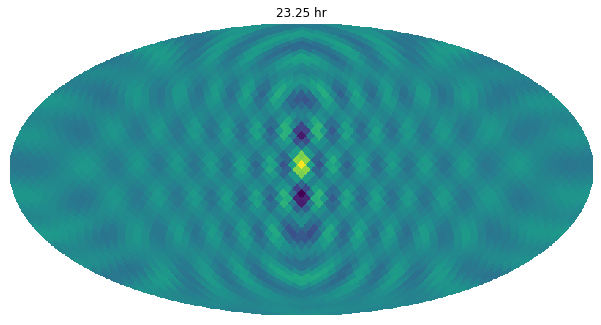

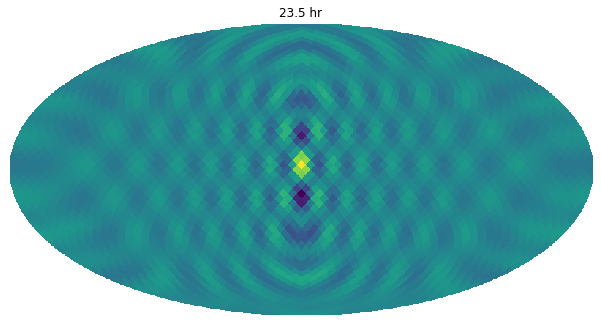

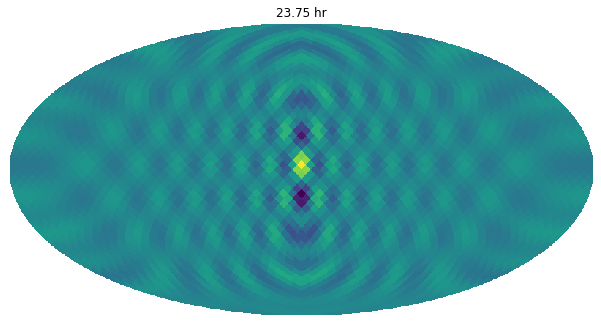

In [122]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for i, t in enumerate(np.arange(0, 86400, 900)):
    cumulative_fisher += simple_fisher(x1 = x_H, x2 = x_L, t=t, f = f, nside = nside, t0=0)
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    plt.savefig(f"./Animation/Single_frequency/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Single_frequency/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

(3072, 3072)


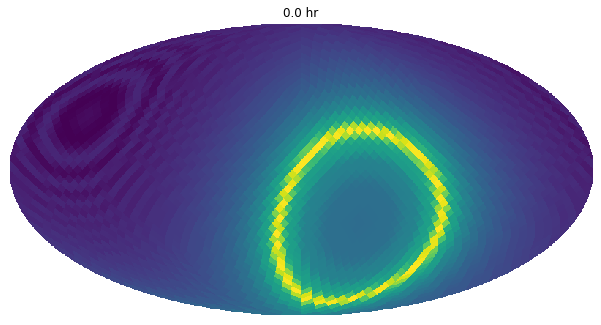

(3072, 3072)


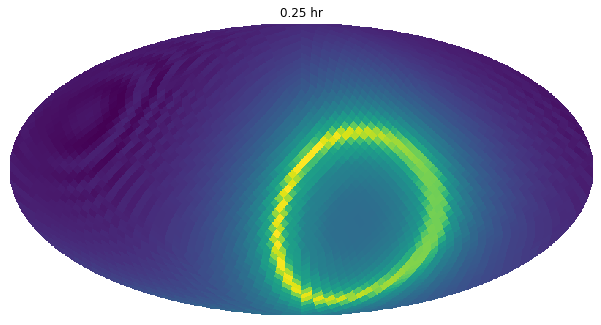

(3072, 3072)


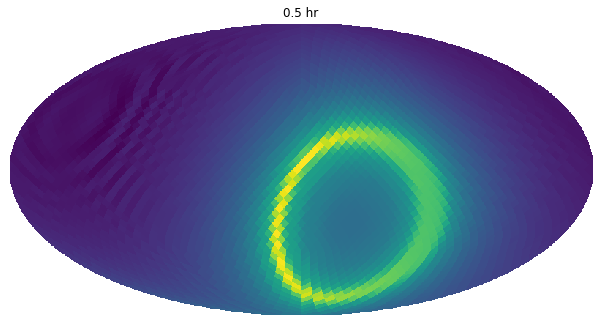

(3072, 3072)


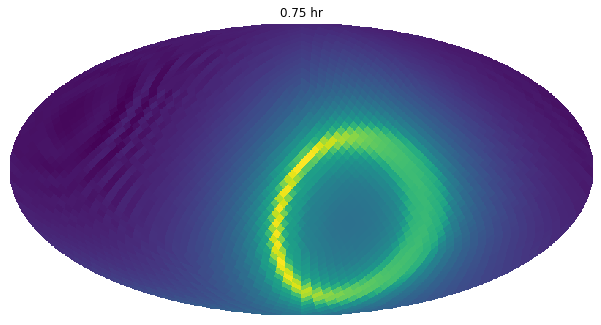

(3072, 3072)


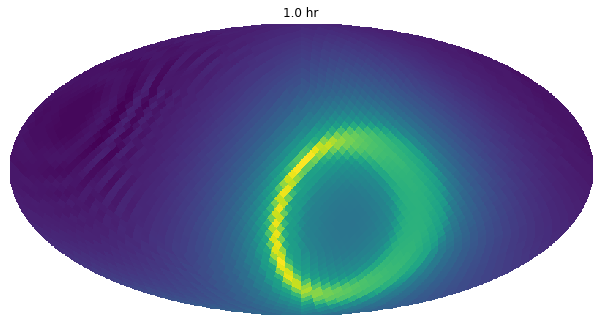

(3072, 3072)


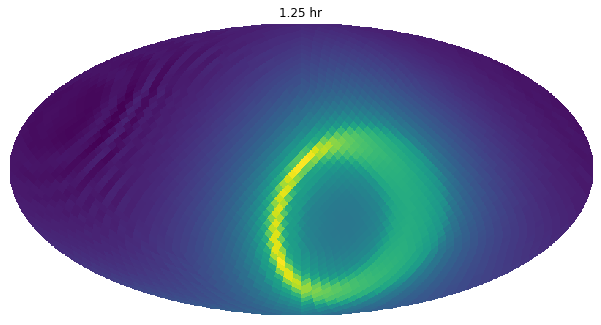

(3072, 3072)


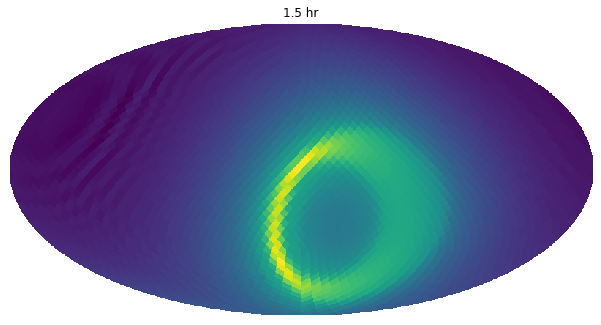

(3072, 3072)


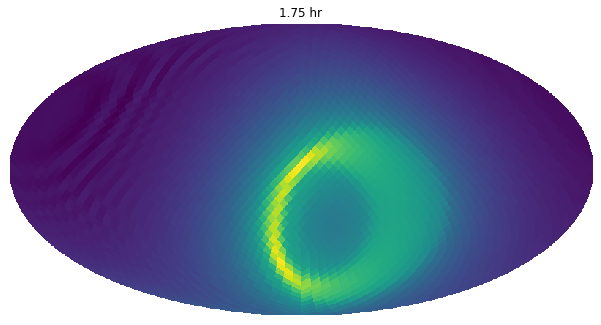

(3072, 3072)


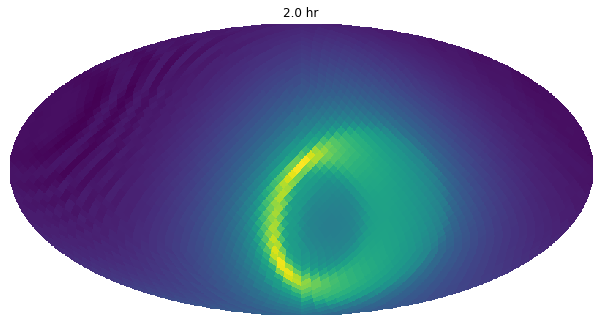

(3072, 3072)


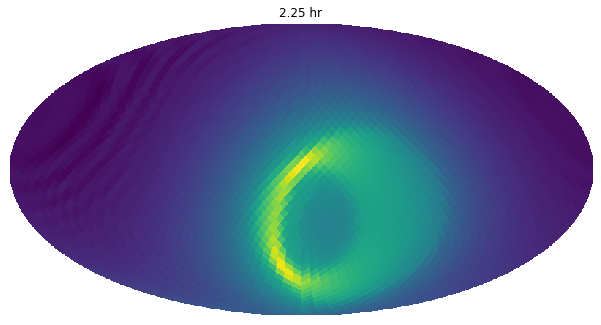

(3072, 3072)


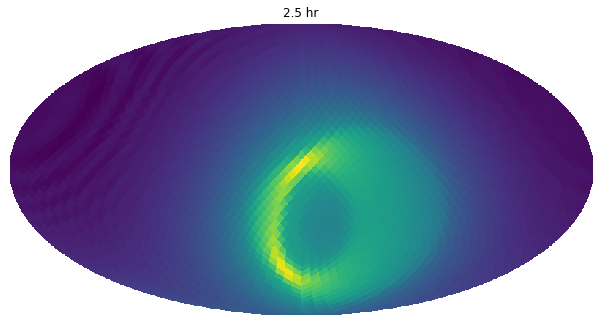

(3072, 3072)


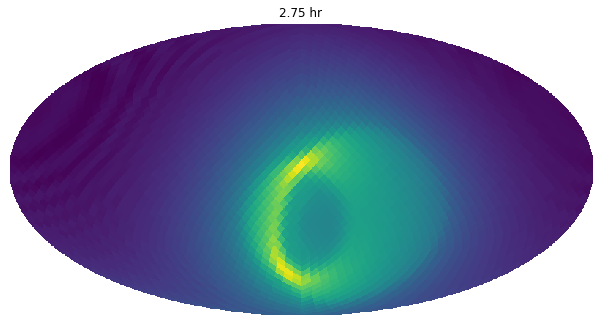

(3072, 3072)


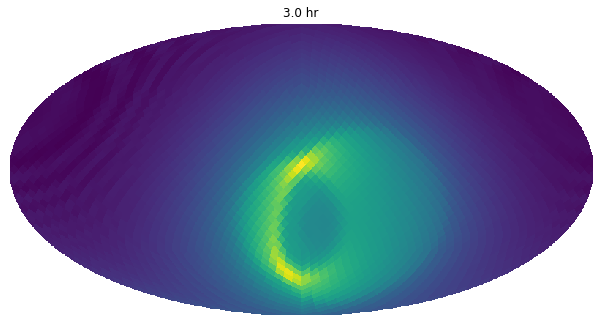

(3072, 3072)


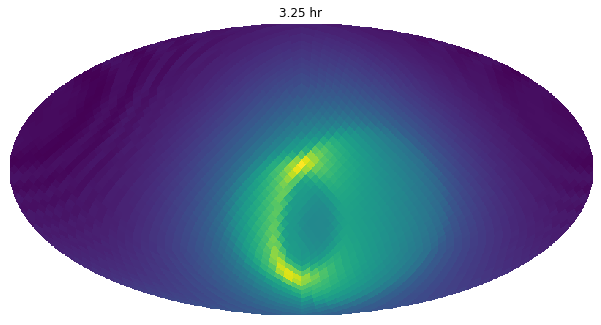

(3072, 3072)


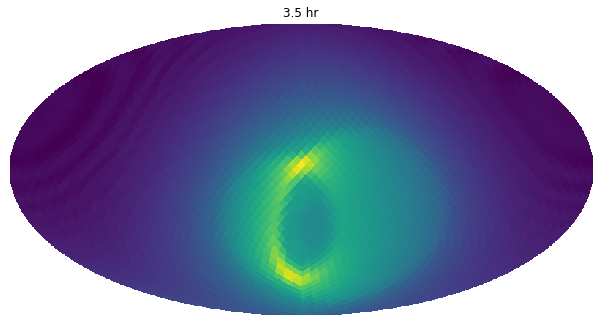

(3072, 3072)


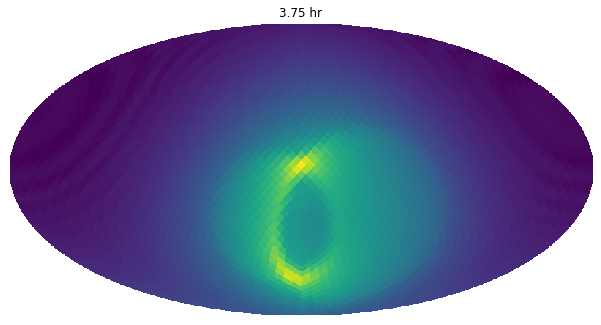

(3072, 3072)


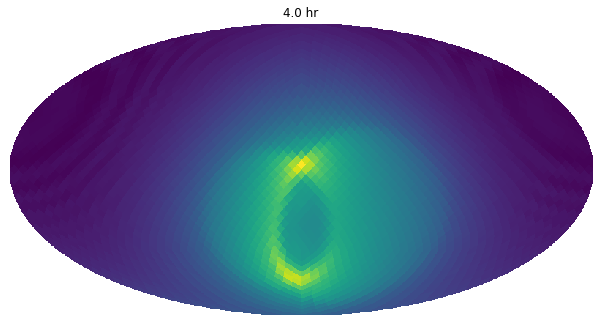

(3072, 3072)


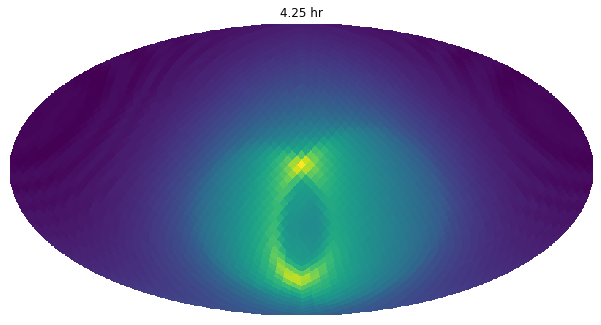

(3072, 3072)


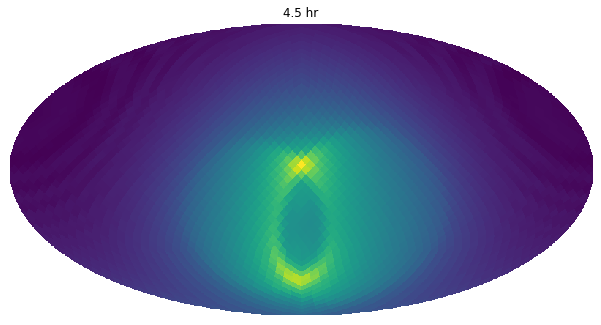

(3072, 3072)


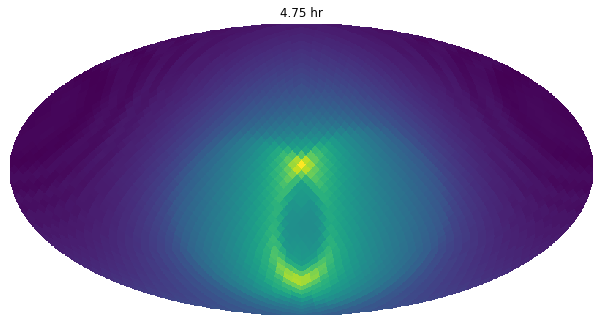

(3072, 3072)


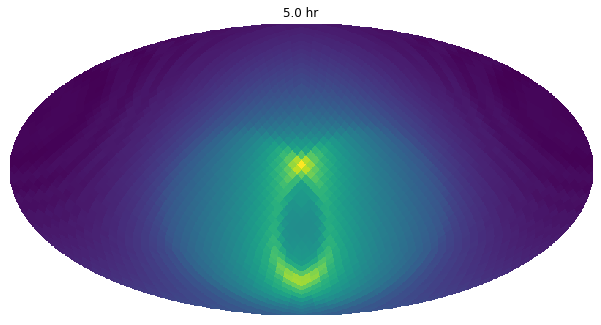

(3072, 3072)


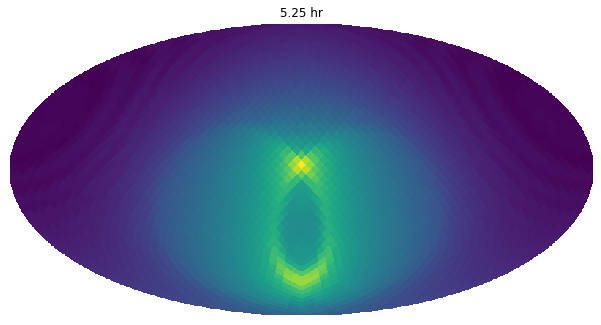

(3072, 3072)


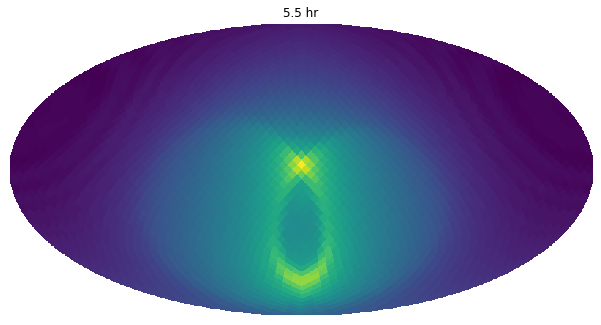

(3072, 3072)


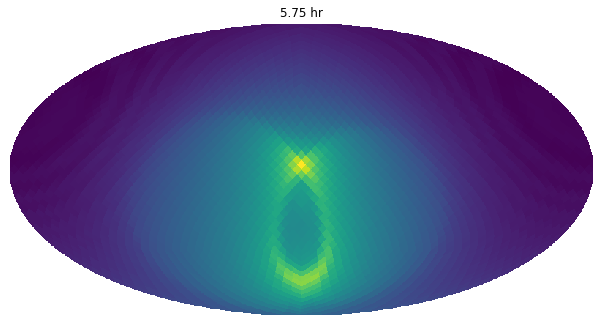

(3072, 3072)


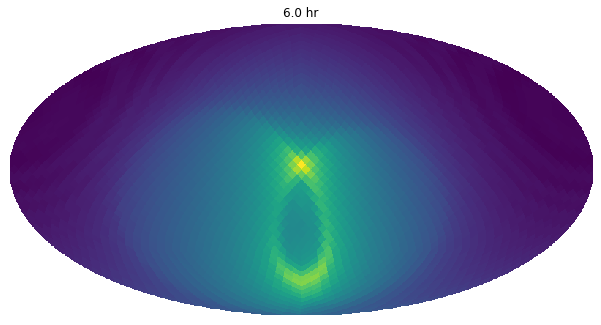

(3072, 3072)


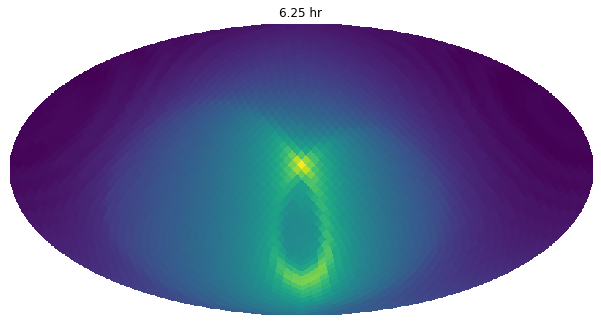

(3072, 3072)


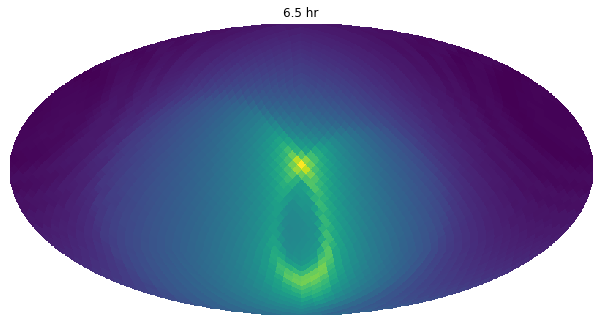

(3072, 3072)


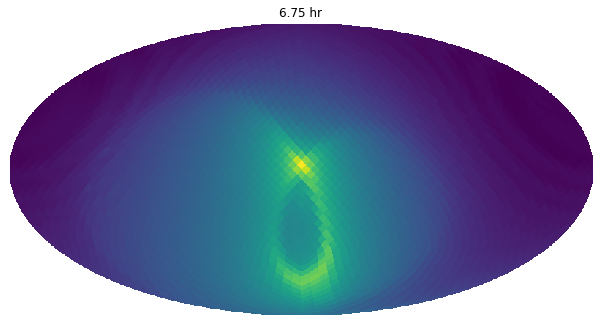

(3072, 3072)


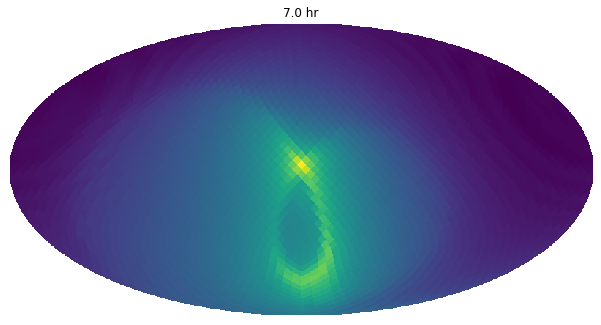

(3072, 3072)


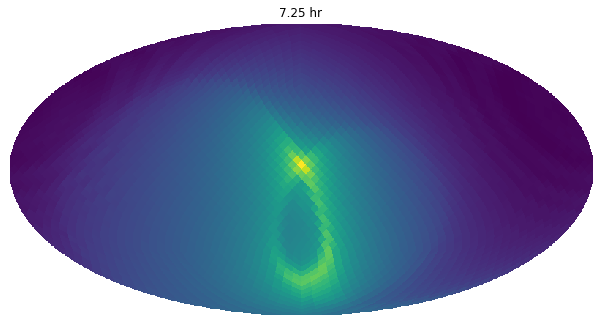

(3072, 3072)


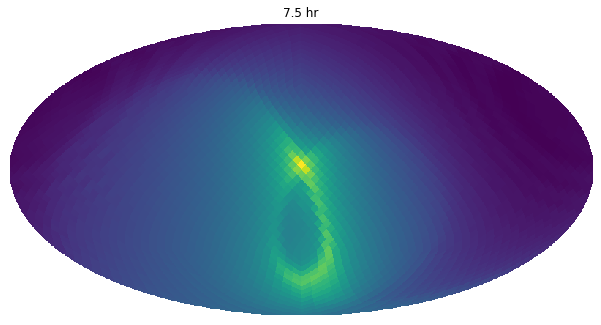

(3072, 3072)


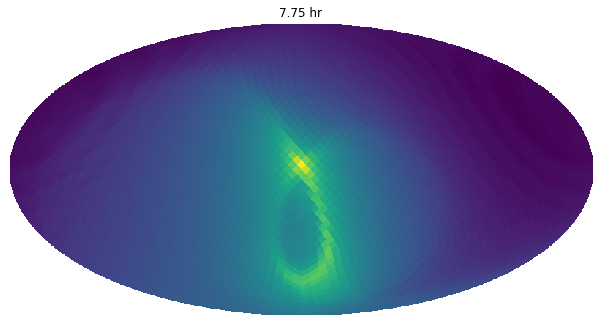

(3072, 3072)


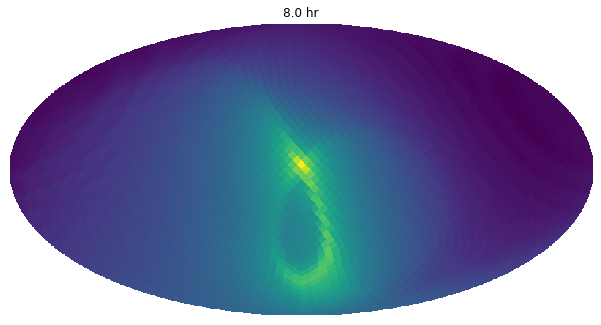

(3072, 3072)


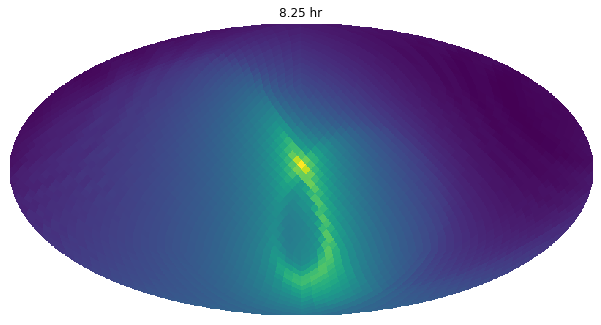

(3072, 3072)


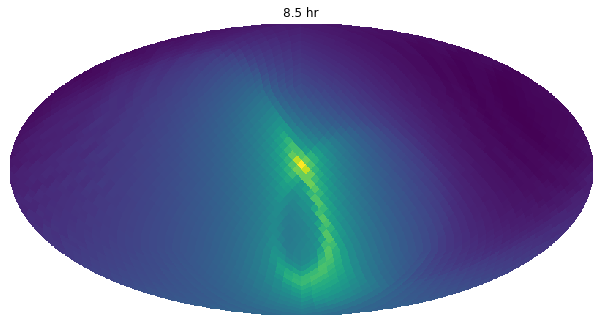

(3072, 3072)


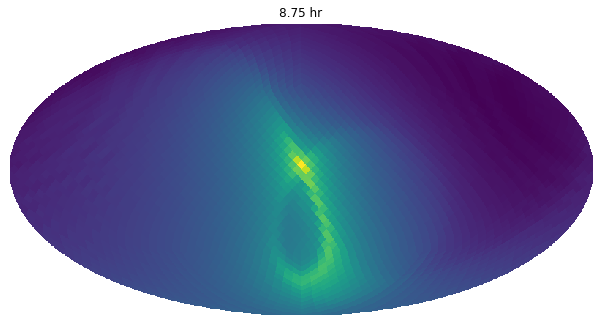

(3072, 3072)


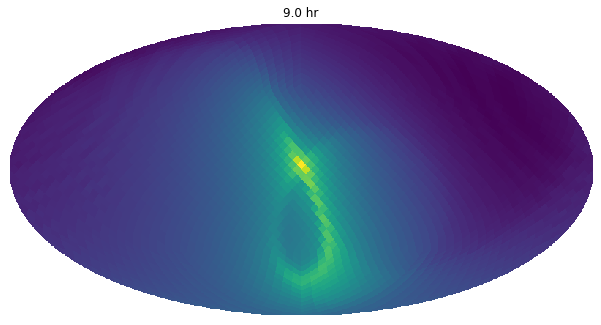

(3072, 3072)


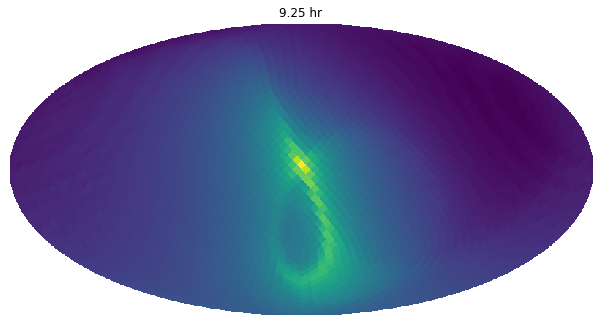

(3072, 3072)


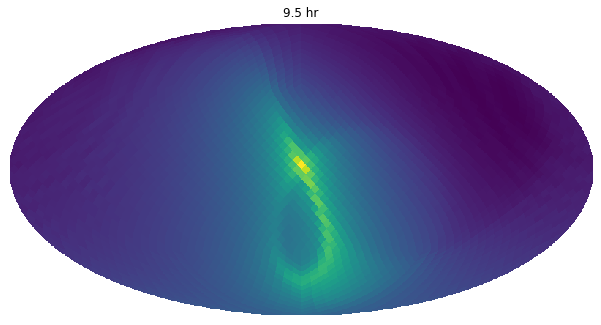

(3072, 3072)


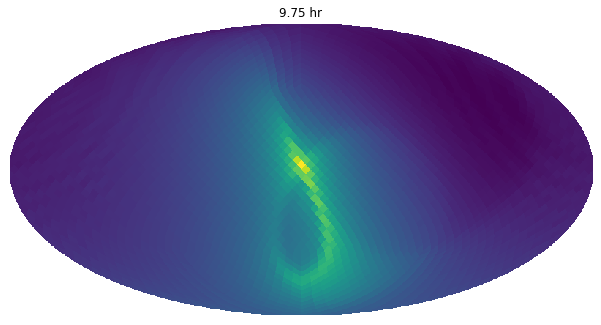

(3072, 3072)


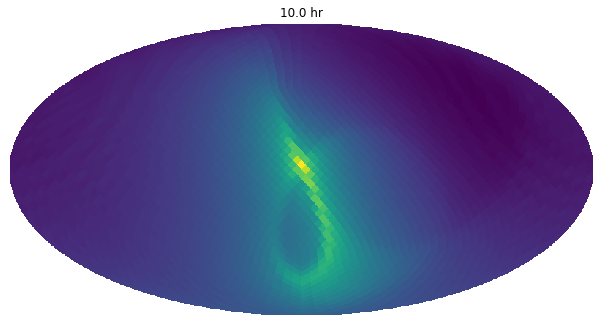

(3072, 3072)


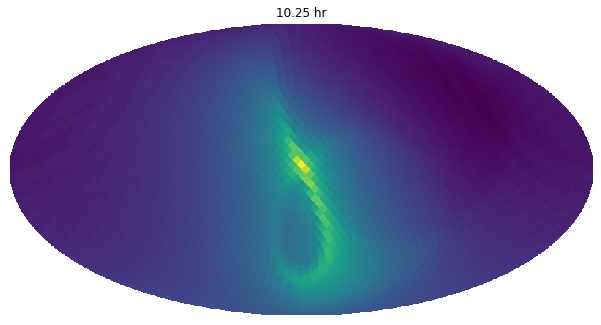

(3072, 3072)


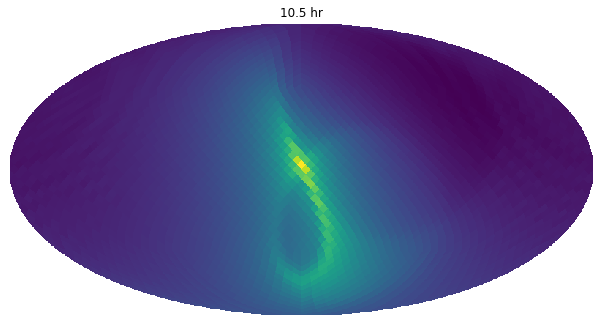

(3072, 3072)


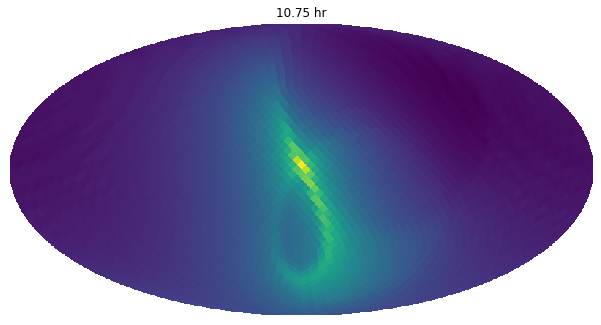

(3072, 3072)


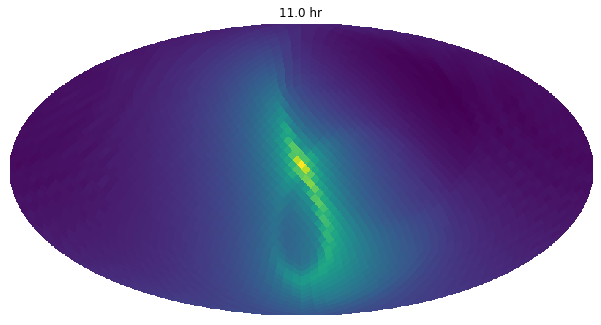

(3072, 3072)


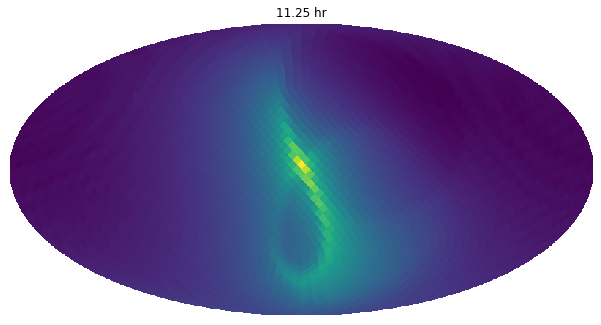

(3072, 3072)


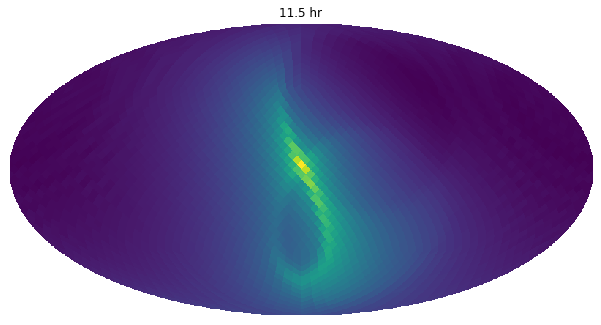

(3072, 3072)


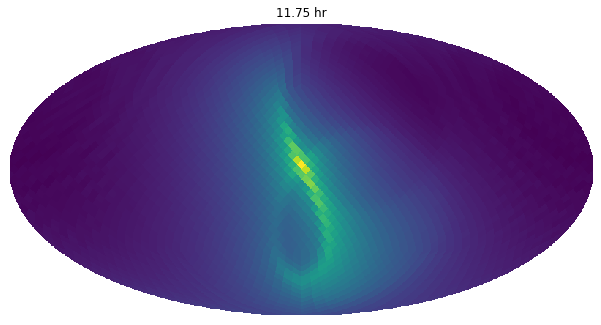

(3072, 3072)


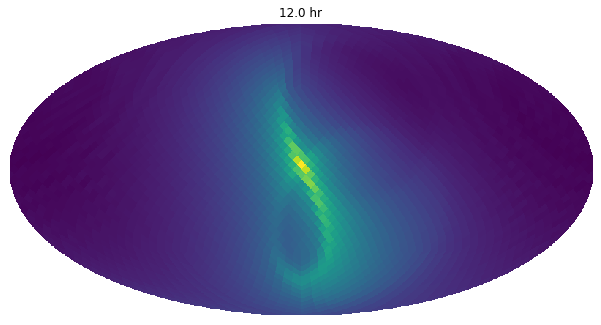

(3072, 3072)


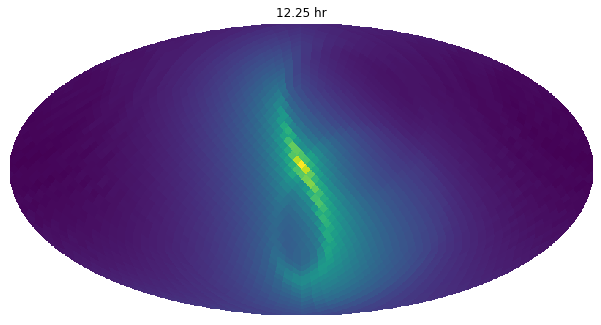

(3072, 3072)


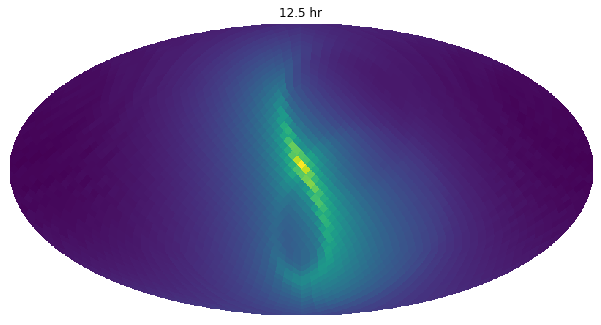

(3072, 3072)


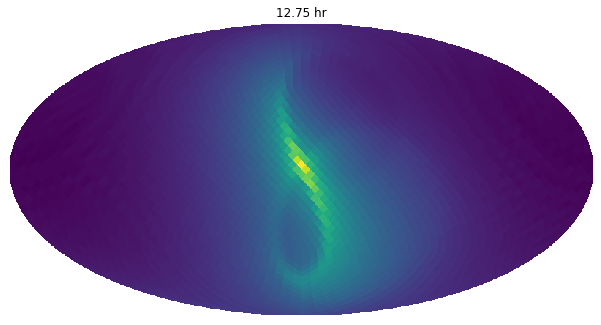

(3072, 3072)


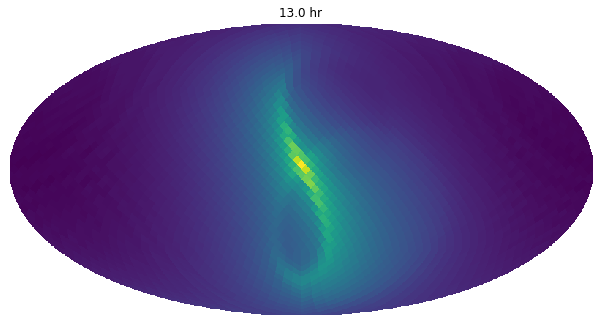

(3072, 3072)


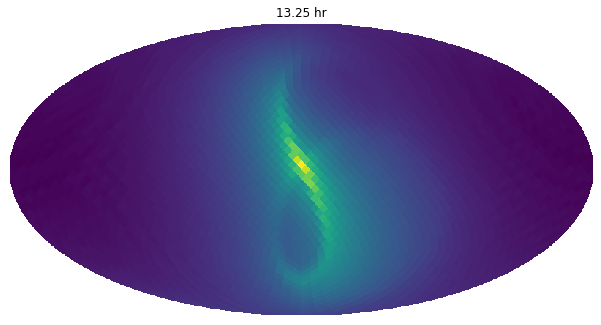

(3072, 3072)


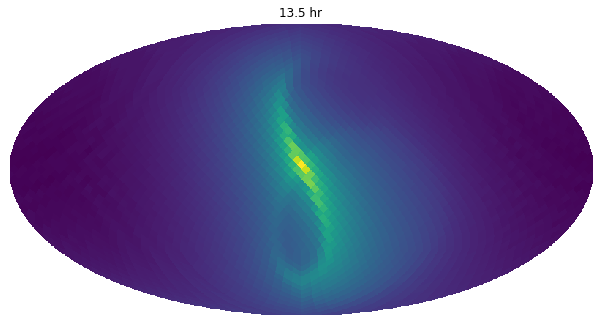

(3072, 3072)


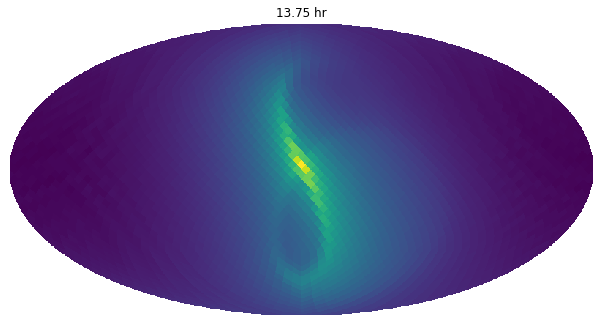

(3072, 3072)


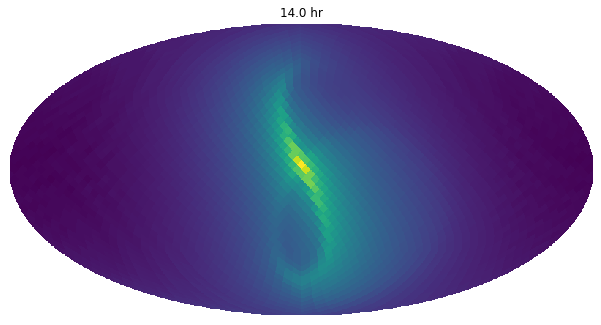

(3072, 3072)


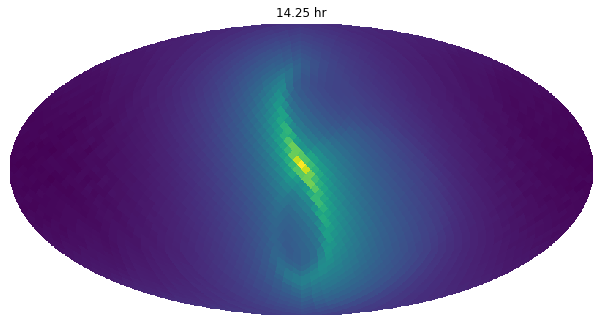

(3072, 3072)


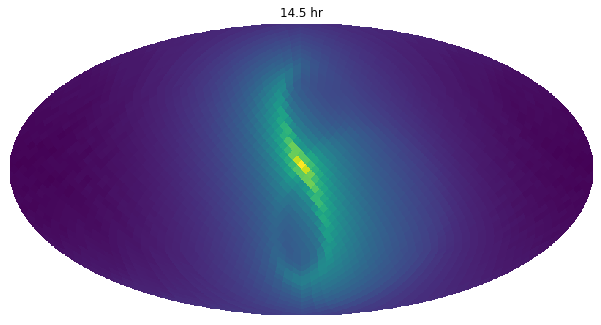

(3072, 3072)


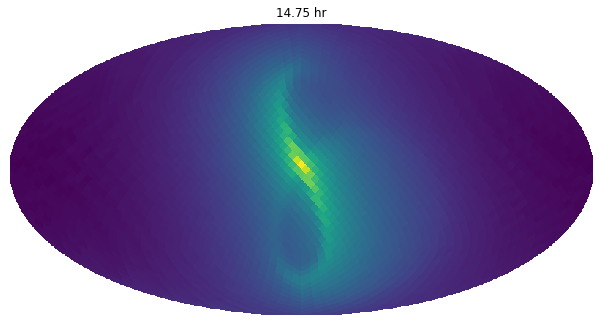

(3072, 3072)


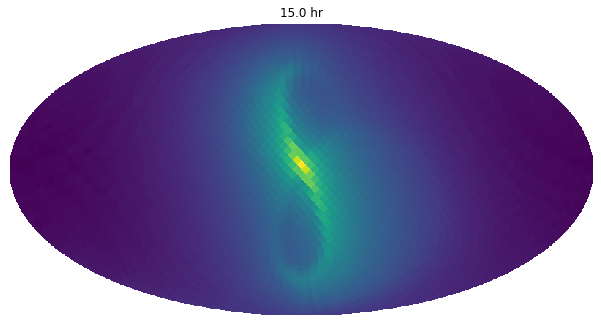

(3072, 3072)


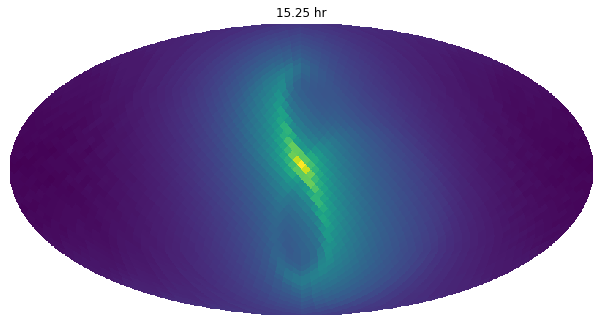

(3072, 3072)


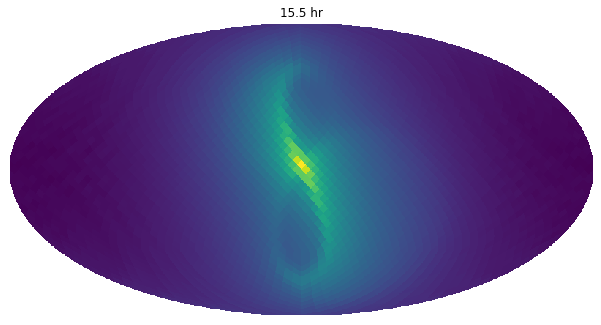

(3072, 3072)


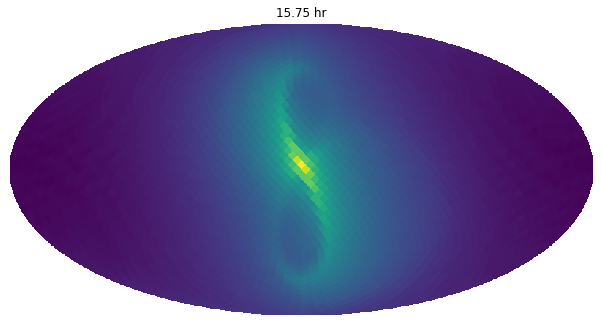

(3072, 3072)


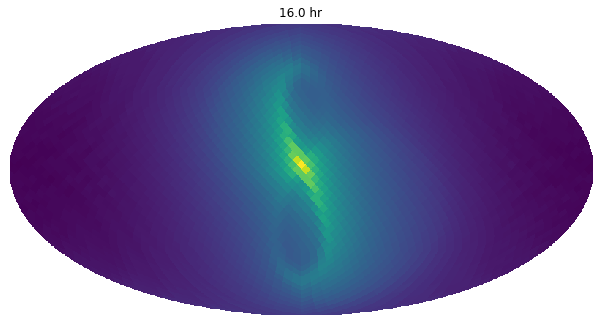

(3072, 3072)


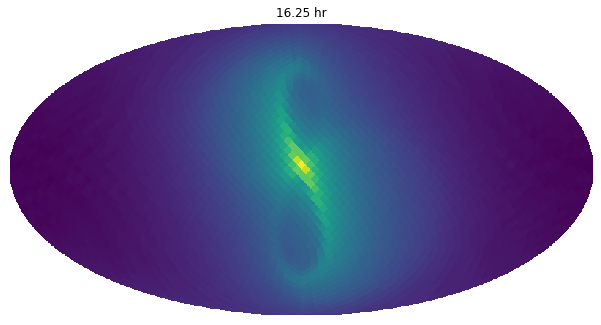

(3072, 3072)


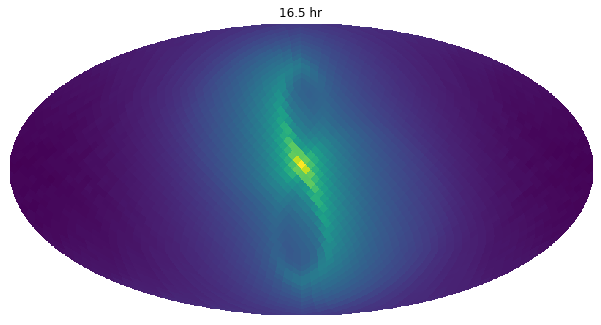

(3072, 3072)


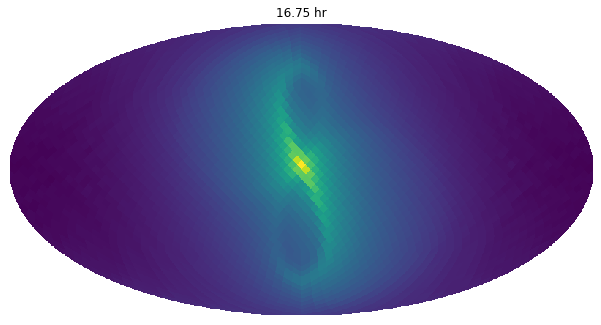

(3072, 3072)


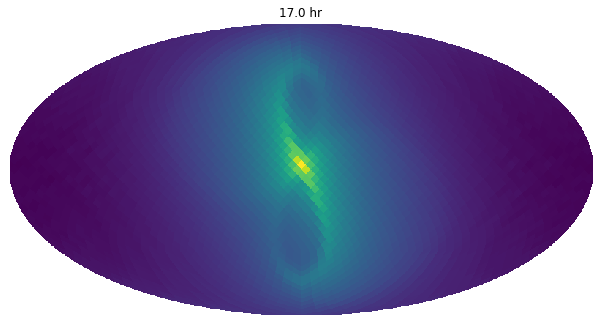

(3072, 3072)


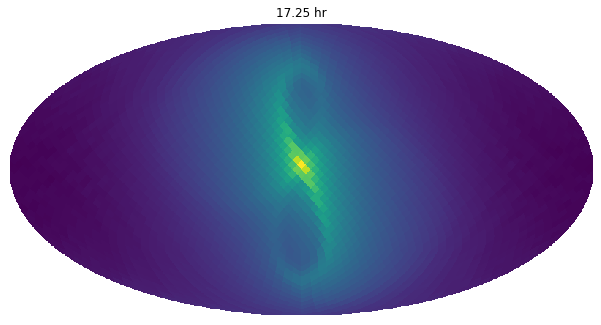

(3072, 3072)


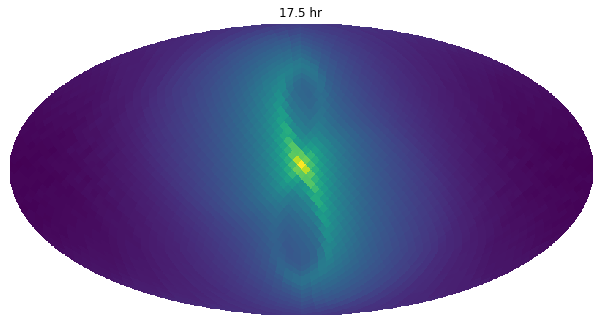

(3072, 3072)


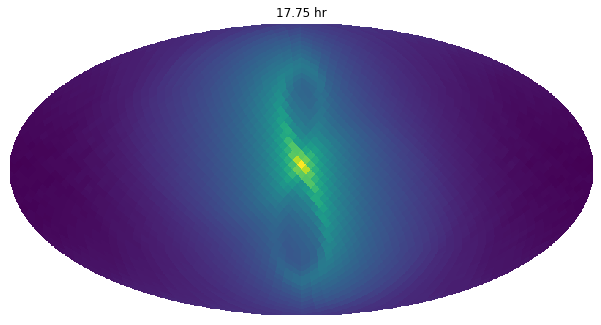

(3072, 3072)


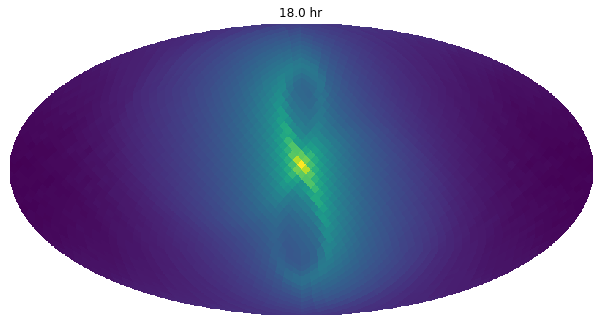

(3072, 3072)


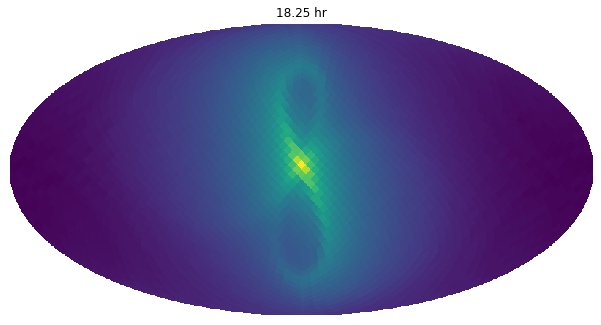

(3072, 3072)


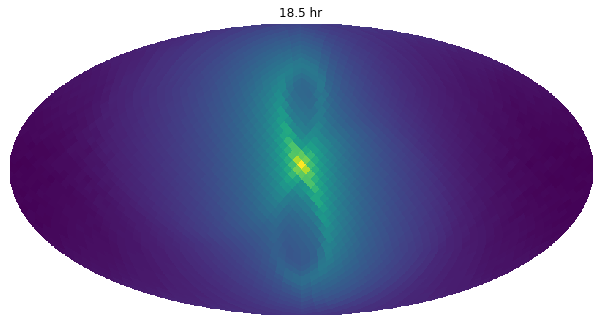

(3072, 3072)


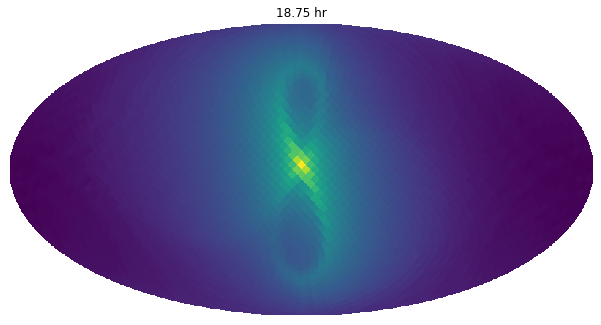

(3072, 3072)


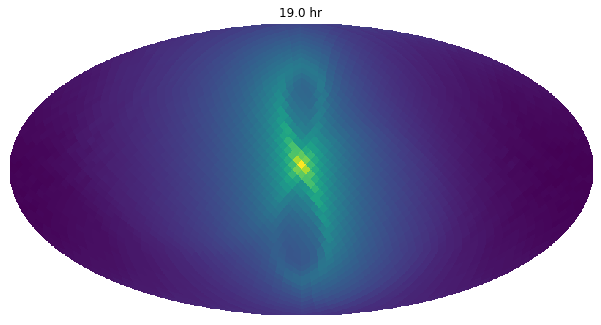

(3072, 3072)


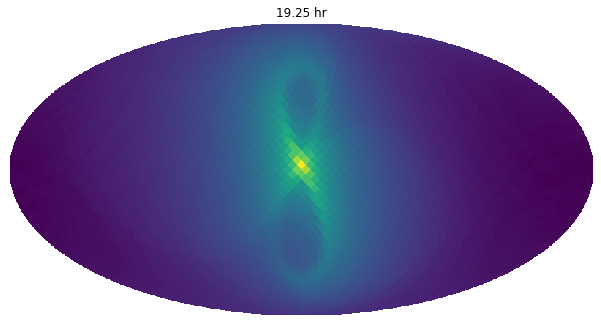

(3072, 3072)


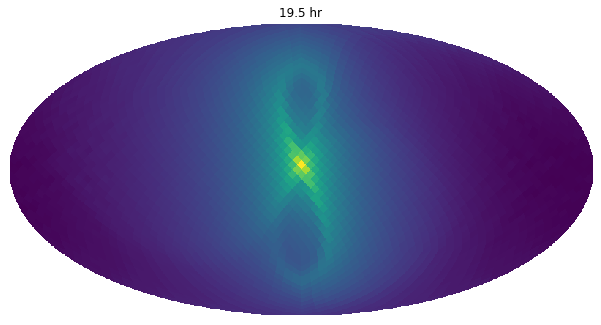

(3072, 3072)


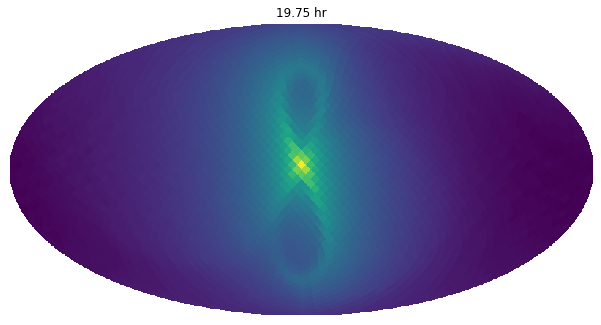

(3072, 3072)


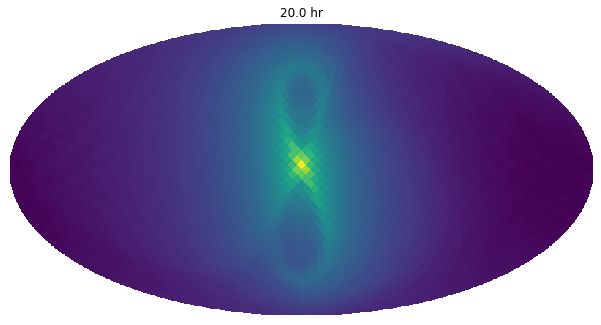

(3072, 3072)


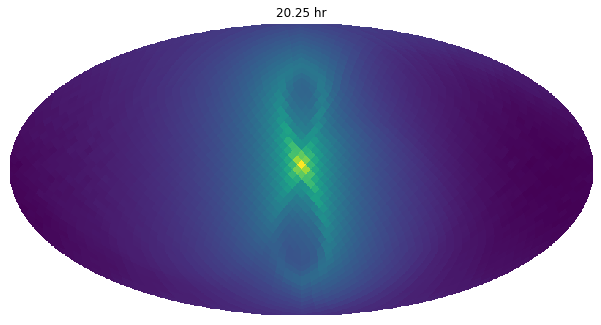

(3072, 3072)


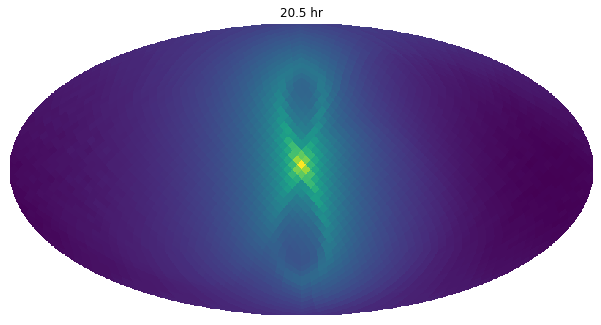

(3072, 3072)


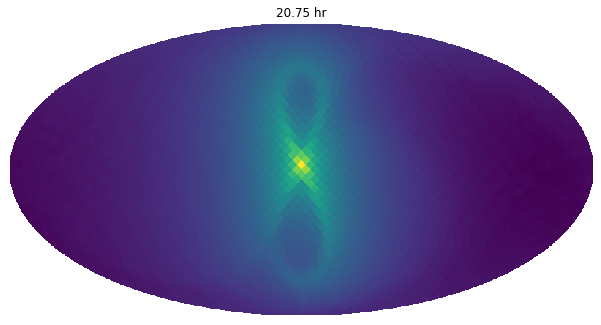

(3072, 3072)


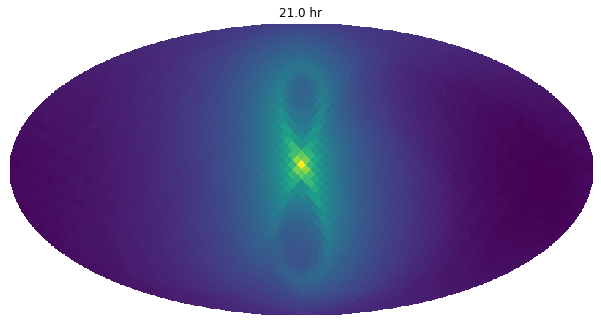

(3072, 3072)


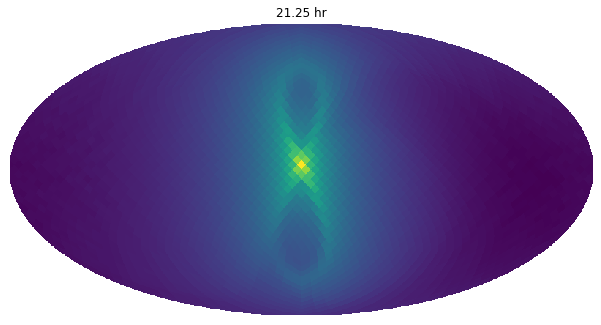

(3072, 3072)


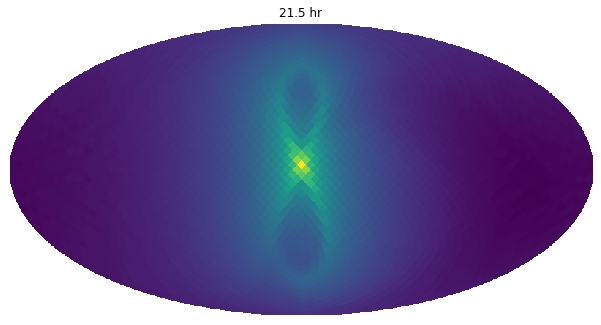

(3072, 3072)


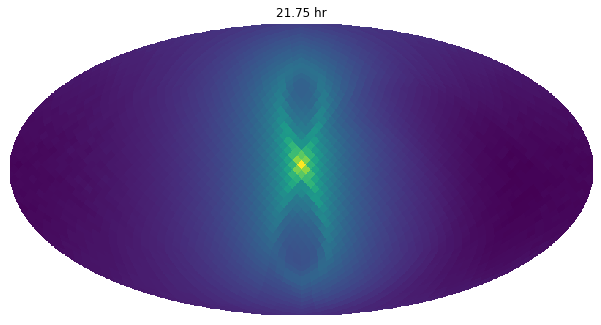

(3072, 3072)


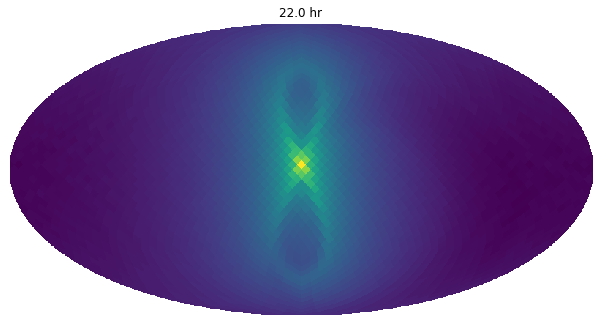

(3072, 3072)


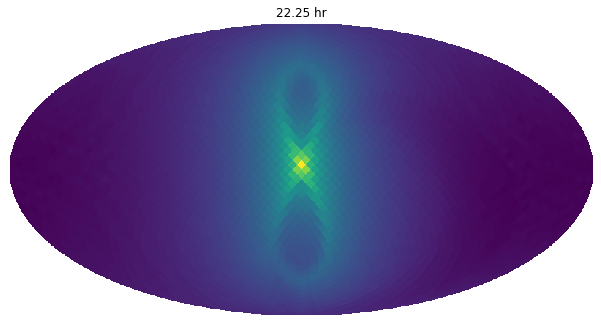

(3072, 3072)


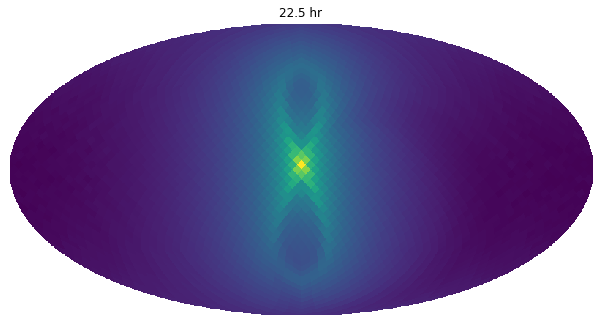

(3072, 3072)


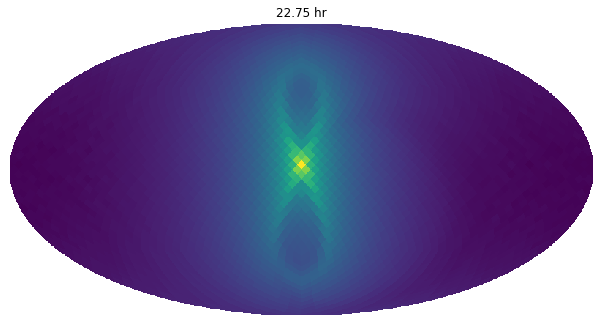

(3072, 3072)


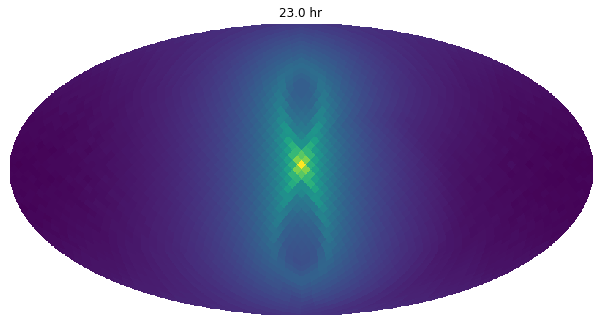

(3072, 3072)


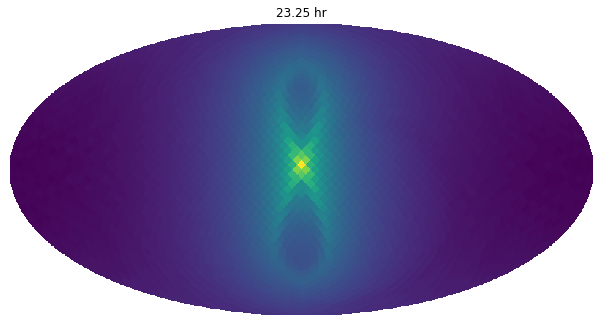

(3072, 3072)


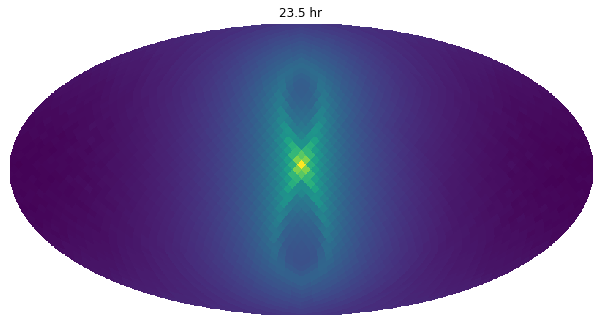

(3072, 3072)


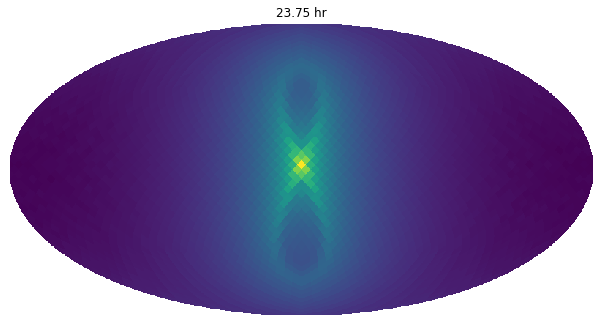

In [123]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
for i, t in enumerate(np.arange(0, 86400, 900)):
    orf = [np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=t, t0=0), n_hat(theta, phi))/c)\
           for f in freqs]
    orf_star = np.conjugate(orf)
    cumulative_fisher += simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    
    plt.savefig(f"./Animation/Broadband/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Broadband/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

(3072, 3072)
(3072, 3072)
(3072, 3072)


/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


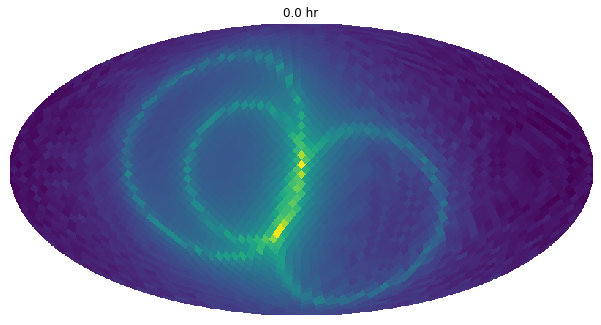

(3072, 3072)
(3072, 3072)
(3072, 3072)


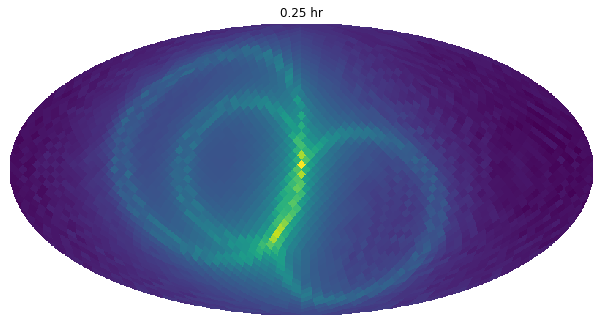

(3072, 3072)
(3072, 3072)
(3072, 3072)


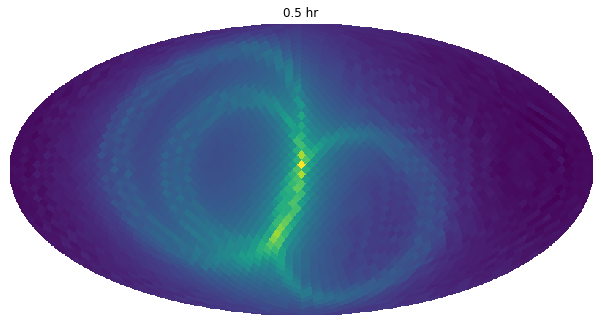

(3072, 3072)
(3072, 3072)
(3072, 3072)


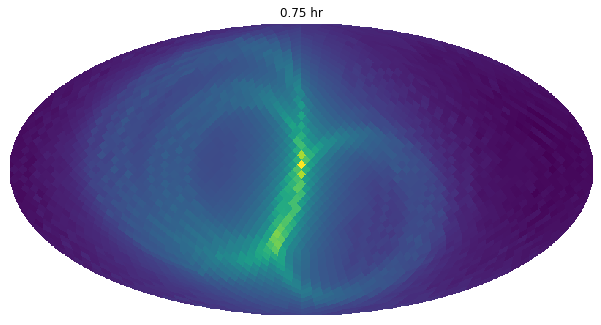

(3072, 3072)
(3072, 3072)
(3072, 3072)


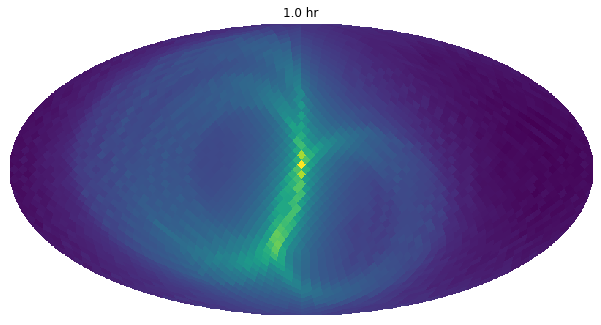

(3072, 3072)
(3072, 3072)
(3072, 3072)


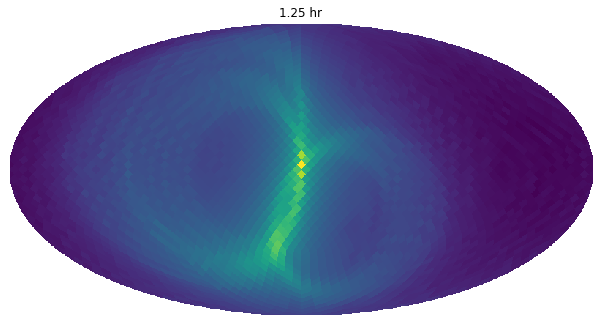

(3072, 3072)
(3072, 3072)
(3072, 3072)


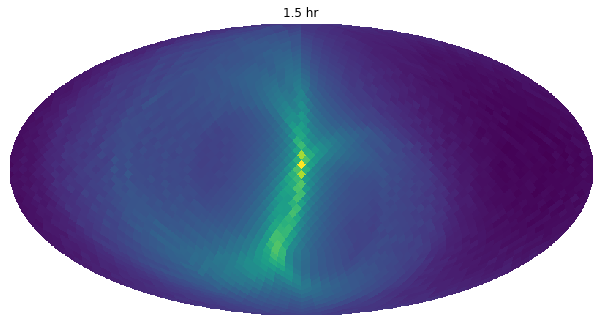

(3072, 3072)
(3072, 3072)
(3072, 3072)


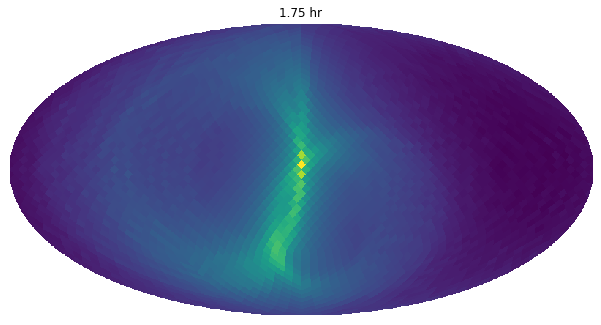

(3072, 3072)
(3072, 3072)
(3072, 3072)


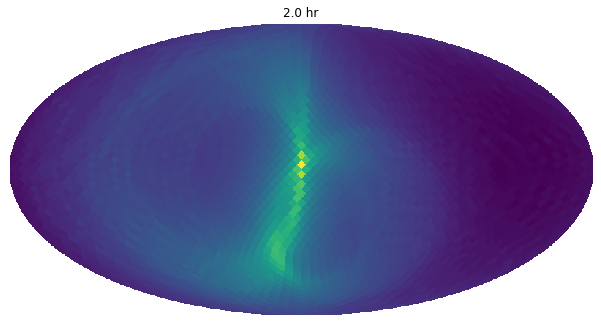

(3072, 3072)
(3072, 3072)
(3072, 3072)


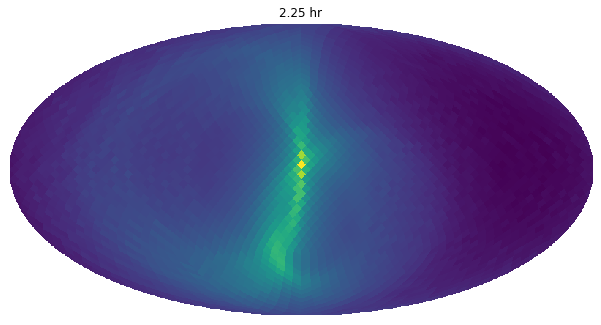

(3072, 3072)
(3072, 3072)
(3072, 3072)


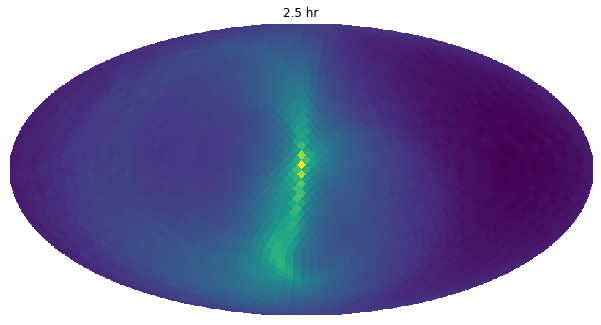

(3072, 3072)
(3072, 3072)
(3072, 3072)


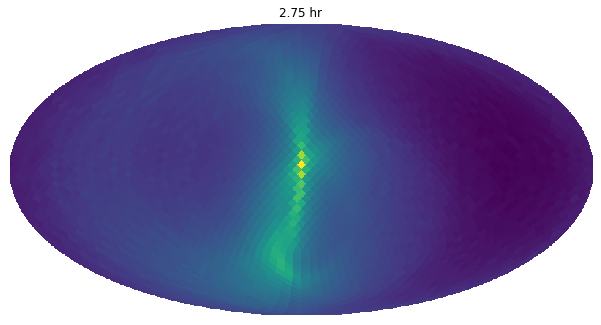

(3072, 3072)
(3072, 3072)
(3072, 3072)


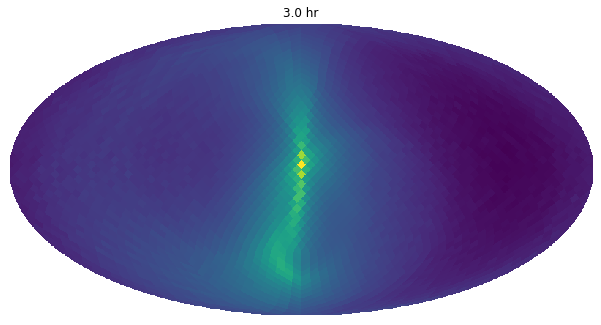

(3072, 3072)
(3072, 3072)
(3072, 3072)


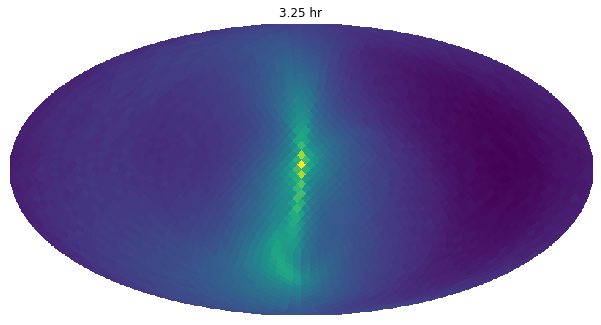

(3072, 3072)
(3072, 3072)
(3072, 3072)


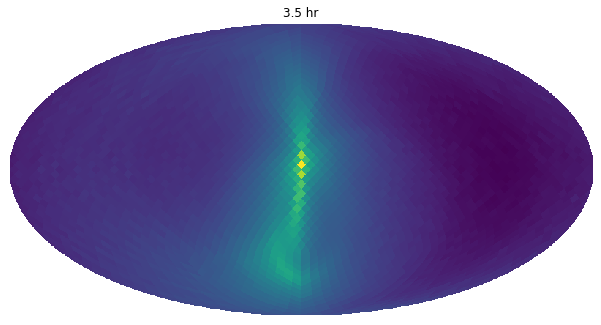

(3072, 3072)
(3072, 3072)
(3072, 3072)


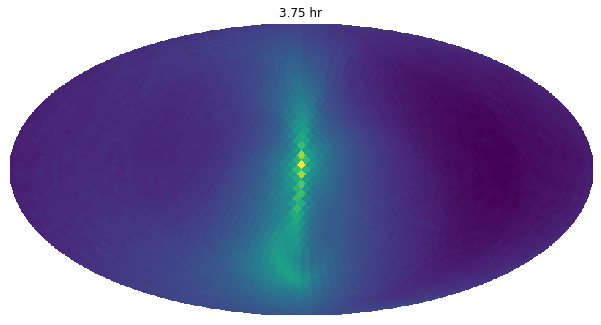

(3072, 3072)
(3072, 3072)
(3072, 3072)


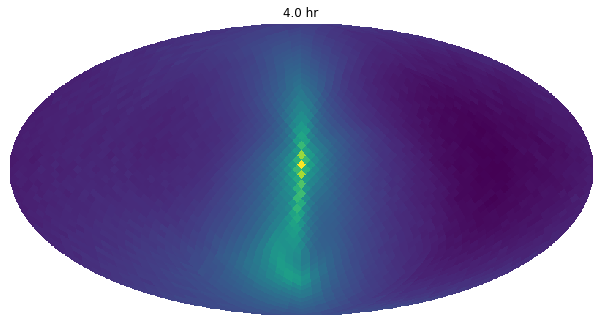

(3072, 3072)
(3072, 3072)
(3072, 3072)


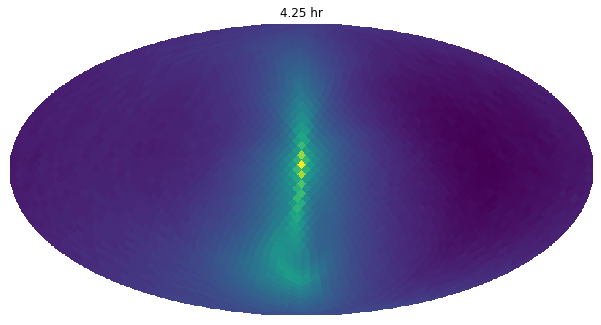

(3072, 3072)
(3072, 3072)
(3072, 3072)


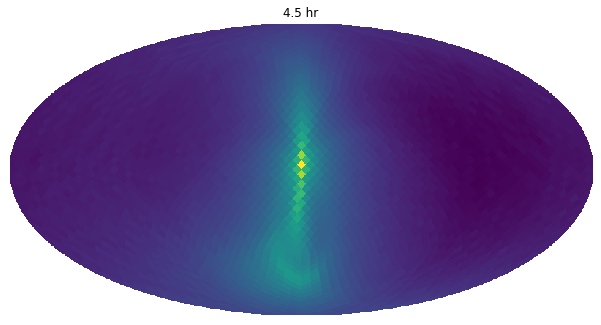

(3072, 3072)
(3072, 3072)
(3072, 3072)


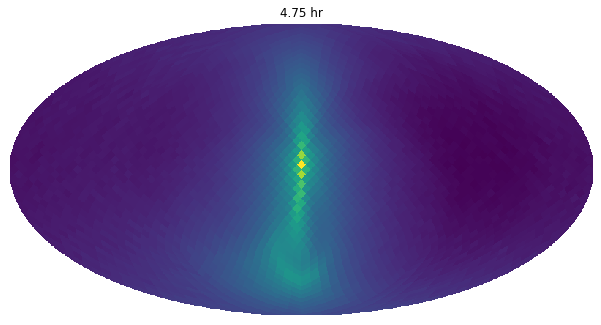

(3072, 3072)
(3072, 3072)
(3072, 3072)


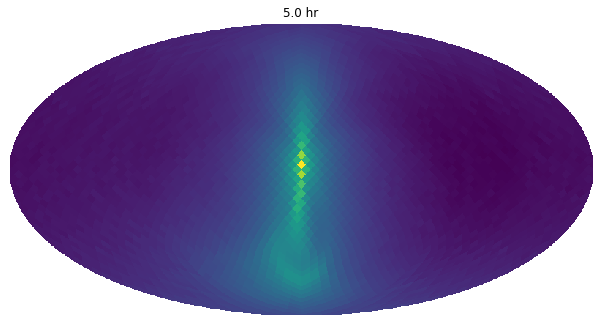

(3072, 3072)
(3072, 3072)
(3072, 3072)


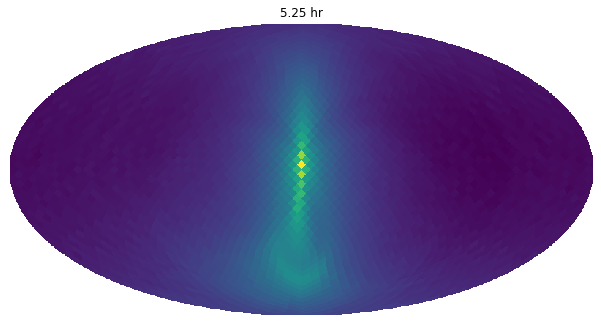

(3072, 3072)
(3072, 3072)
(3072, 3072)


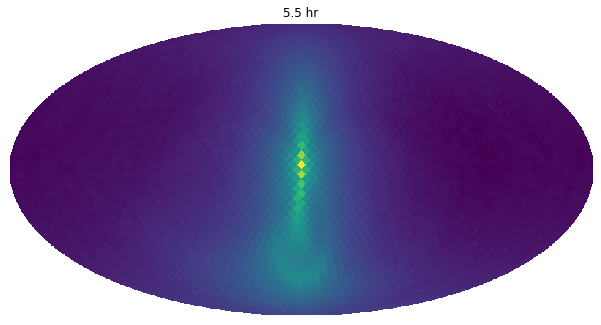

(3072, 3072)
(3072, 3072)
(3072, 3072)


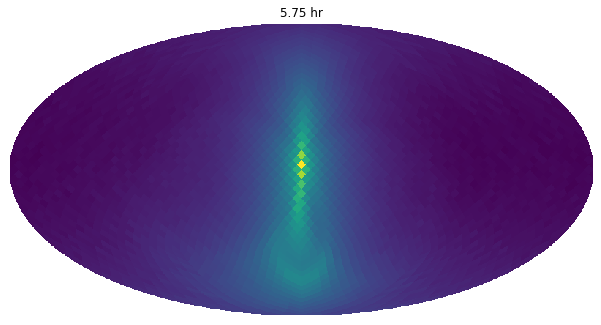

(3072, 3072)
(3072, 3072)
(3072, 3072)


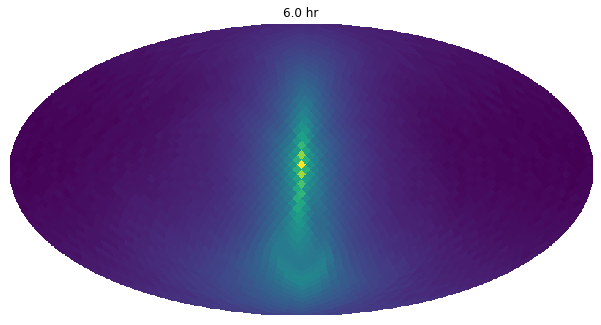

(3072, 3072)
(3072, 3072)
(3072, 3072)


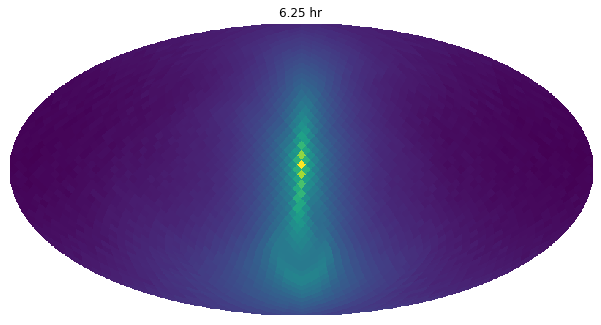

(3072, 3072)
(3072, 3072)
(3072, 3072)


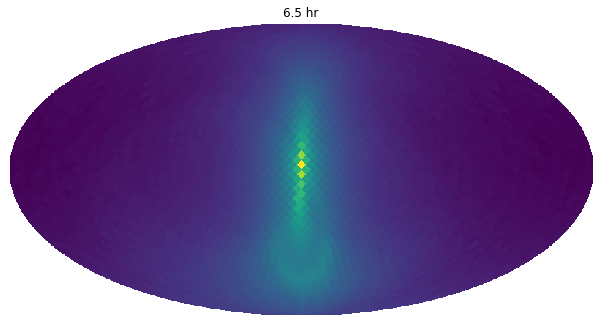

(3072, 3072)
(3072, 3072)
(3072, 3072)


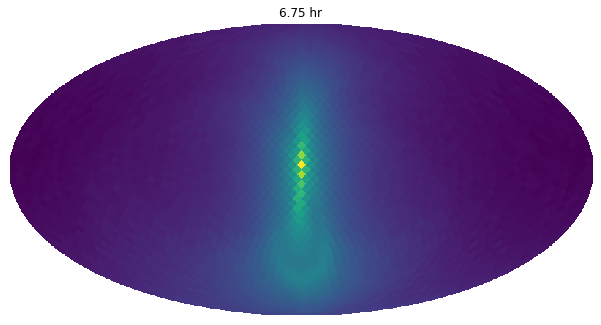

(3072, 3072)
(3072, 3072)
(3072, 3072)


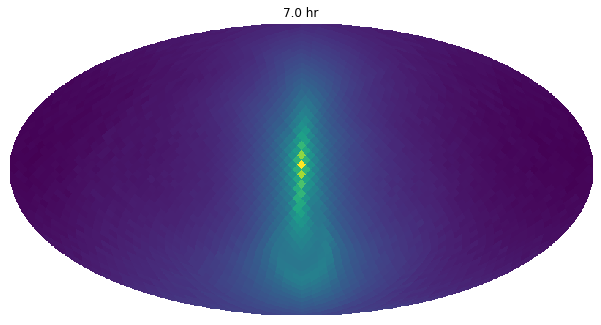

(3072, 3072)
(3072, 3072)
(3072, 3072)


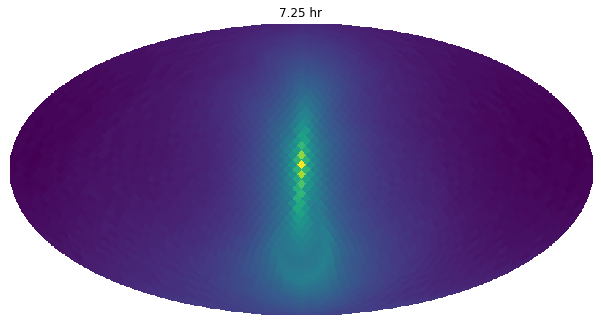

(3072, 3072)
(3072, 3072)
(3072, 3072)


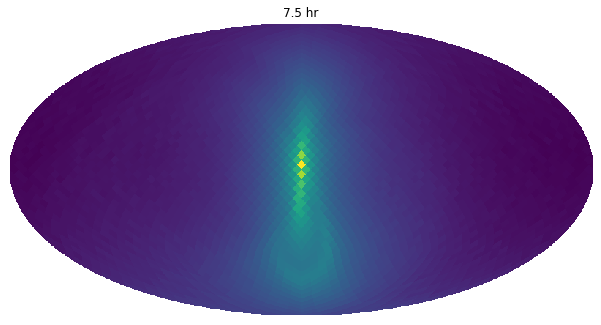

(3072, 3072)
(3072, 3072)
(3072, 3072)


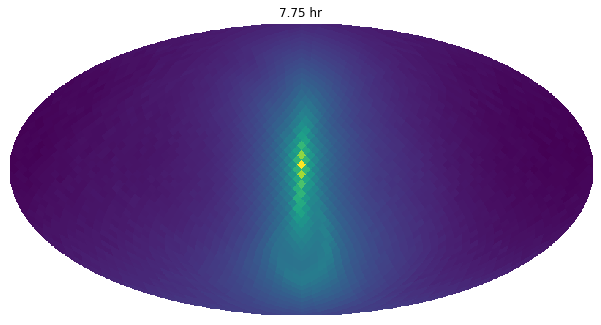

(3072, 3072)
(3072, 3072)
(3072, 3072)


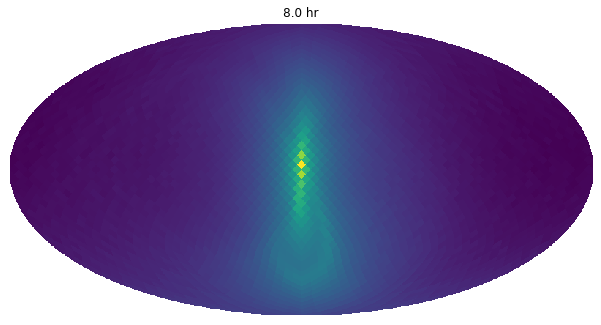

(3072, 3072)
(3072, 3072)
(3072, 3072)


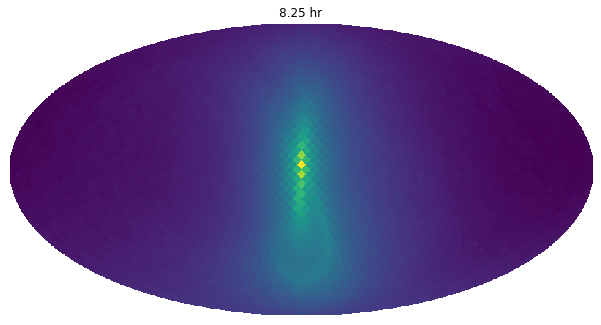

(3072, 3072)
(3072, 3072)
(3072, 3072)


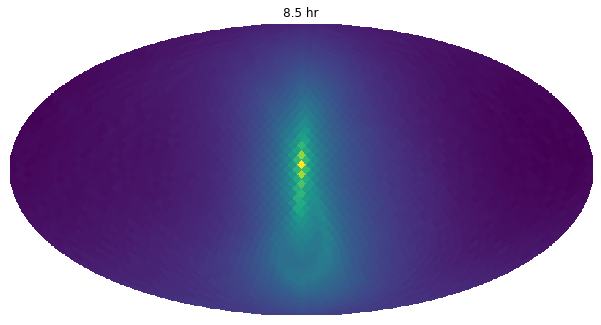

(3072, 3072)
(3072, 3072)
(3072, 3072)


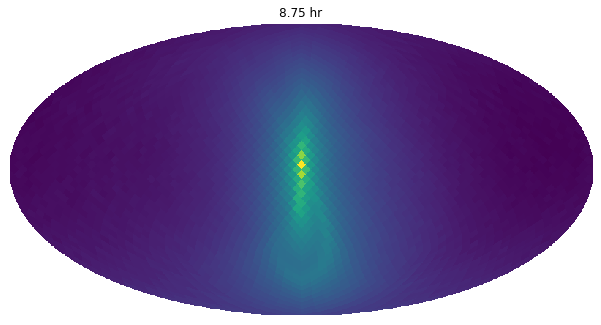

(3072, 3072)
(3072, 3072)
(3072, 3072)


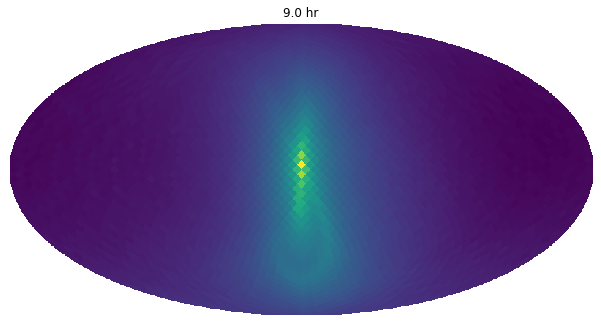

(3072, 3072)
(3072, 3072)
(3072, 3072)


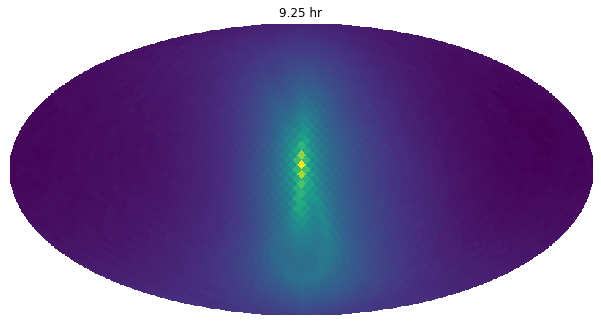

(3072, 3072)
(3072, 3072)
(3072, 3072)


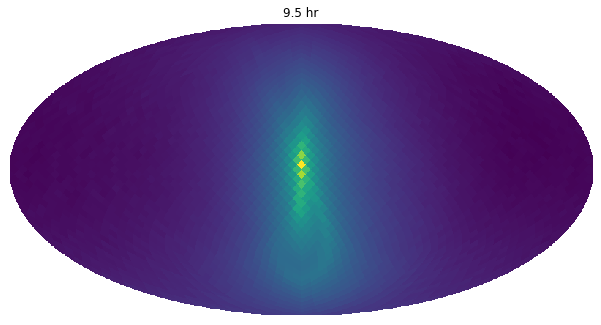

(3072, 3072)
(3072, 3072)
(3072, 3072)


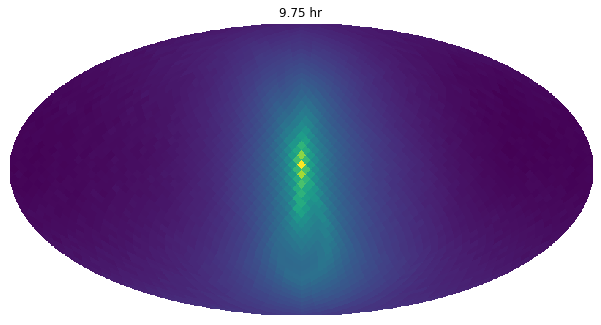

(3072, 3072)
(3072, 3072)
(3072, 3072)


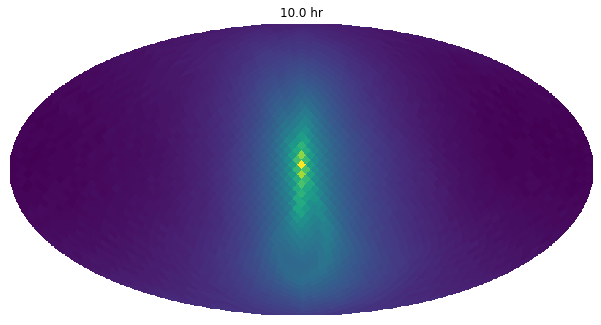

(3072, 3072)
(3072, 3072)
(3072, 3072)


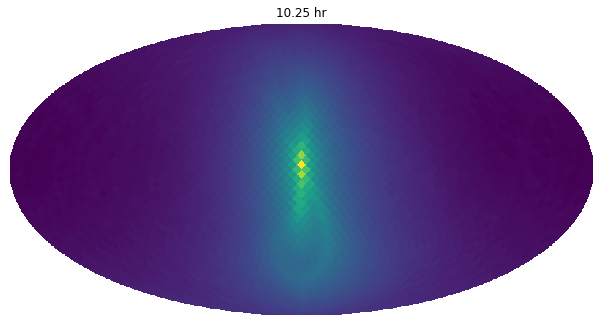

(3072, 3072)
(3072, 3072)
(3072, 3072)


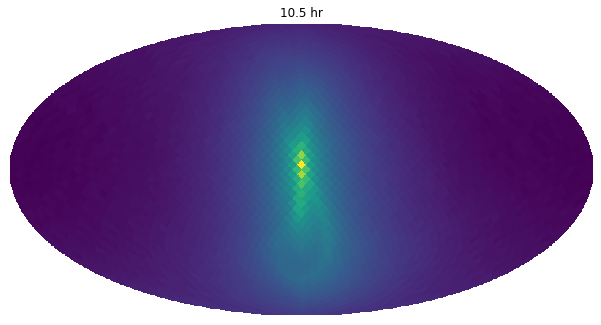

(3072, 3072)
(3072, 3072)
(3072, 3072)


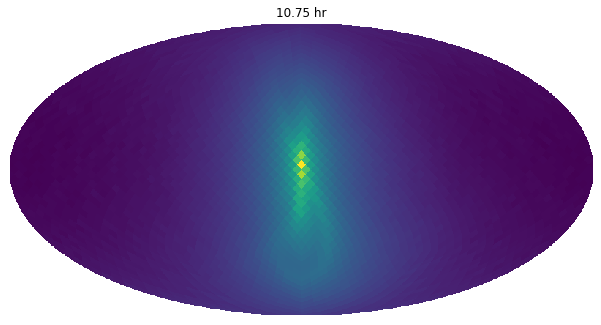

(3072, 3072)
(3072, 3072)
(3072, 3072)


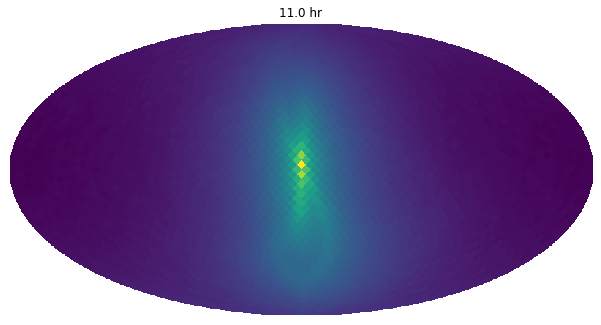

(3072, 3072)
(3072, 3072)
(3072, 3072)


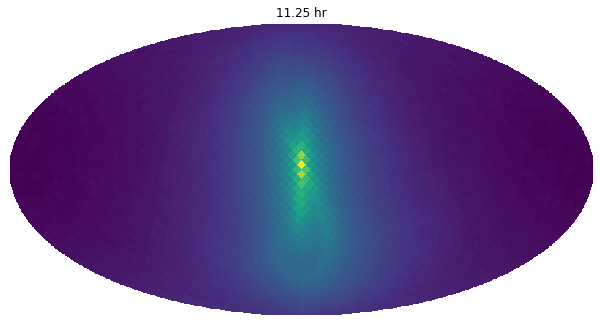

(3072, 3072)
(3072, 3072)
(3072, 3072)


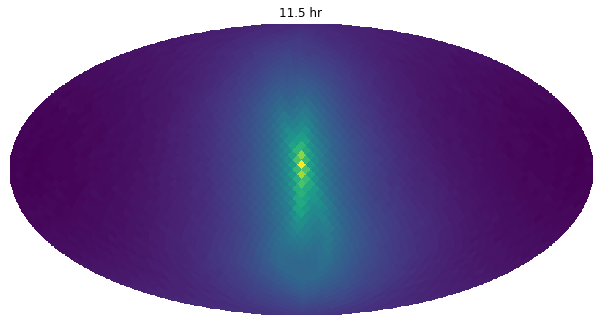

(3072, 3072)
(3072, 3072)
(3072, 3072)


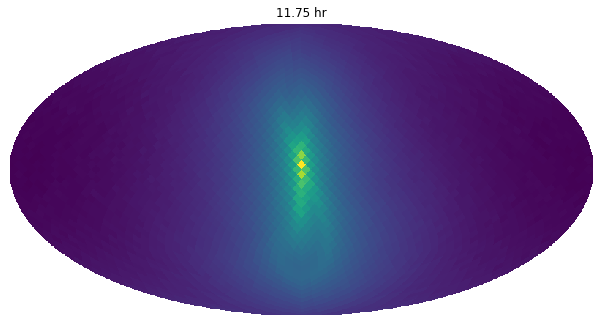

(3072, 3072)
(3072, 3072)
(3072, 3072)


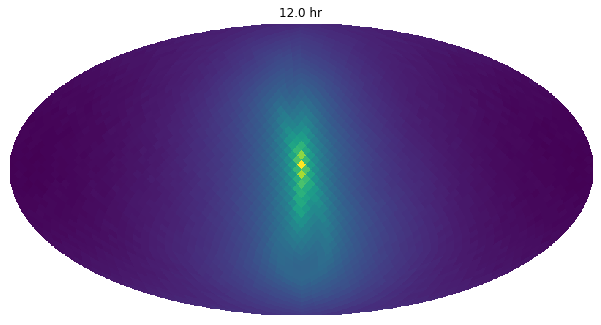

(3072, 3072)
(3072, 3072)
(3072, 3072)


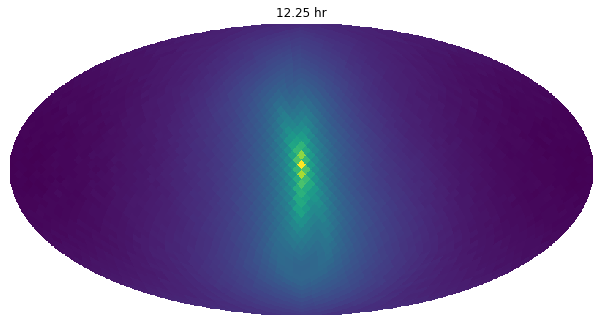

(3072, 3072)
(3072, 3072)
(3072, 3072)


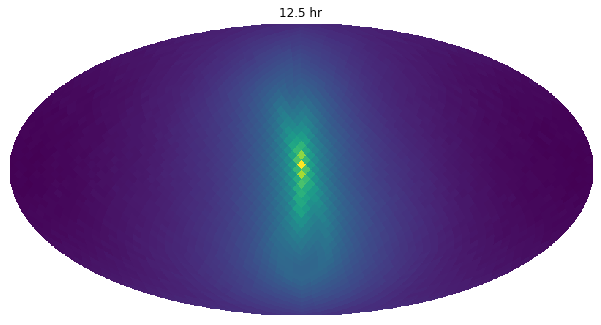

(3072, 3072)
(3072, 3072)
(3072, 3072)


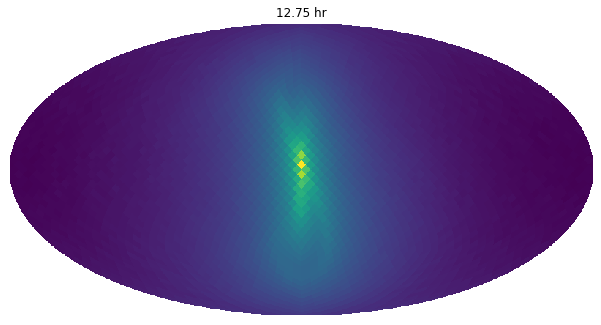

(3072, 3072)
(3072, 3072)
(3072, 3072)


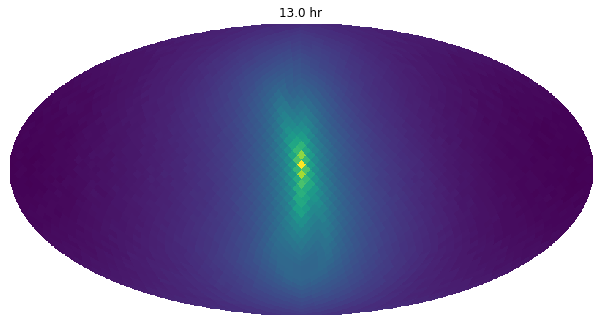

(3072, 3072)
(3072, 3072)
(3072, 3072)


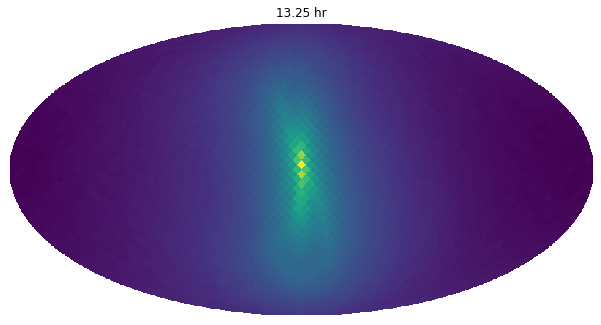

(3072, 3072)
(3072, 3072)
(3072, 3072)


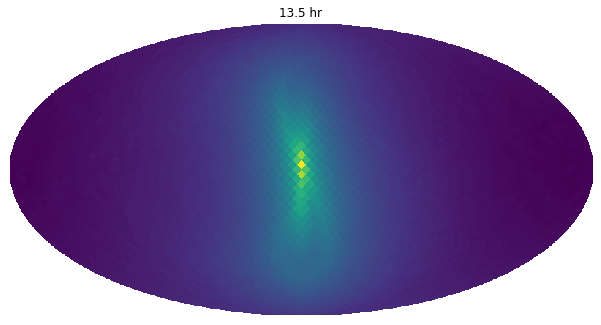

(3072, 3072)
(3072, 3072)
(3072, 3072)


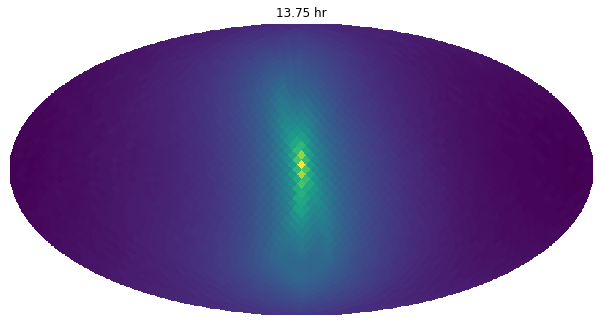

(3072, 3072)
(3072, 3072)
(3072, 3072)


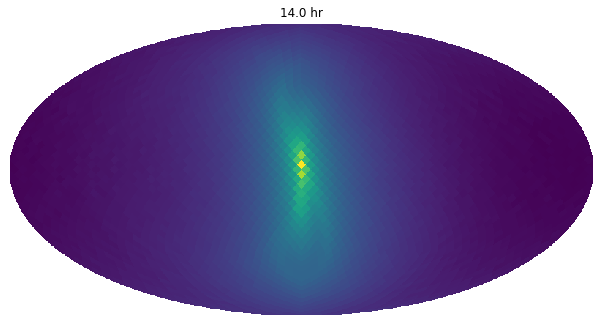

(3072, 3072)
(3072, 3072)
(3072, 3072)


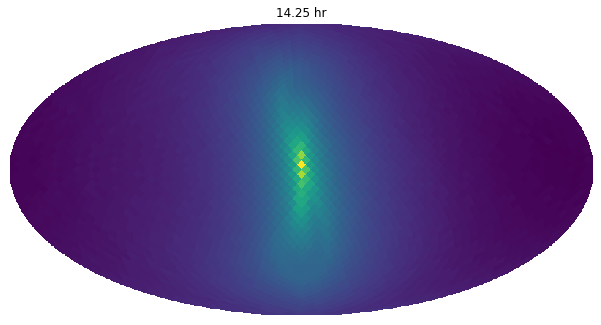

(3072, 3072)
(3072, 3072)
(3072, 3072)


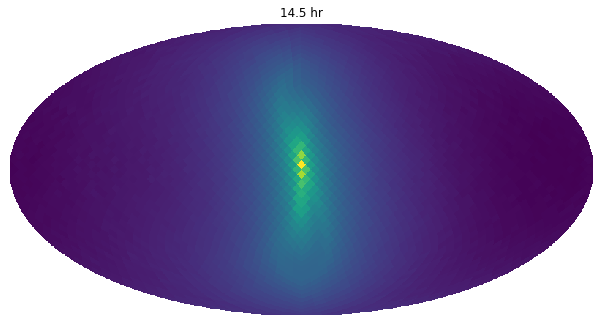

(3072, 3072)
(3072, 3072)
(3072, 3072)


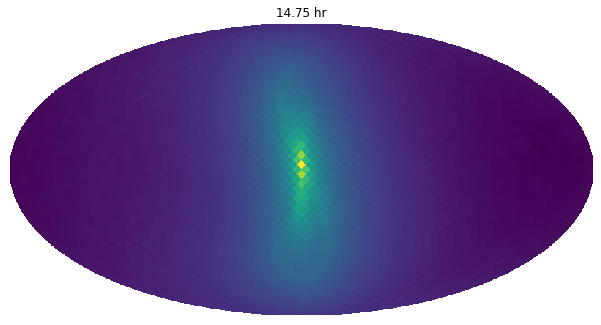

(3072, 3072)
(3072, 3072)
(3072, 3072)


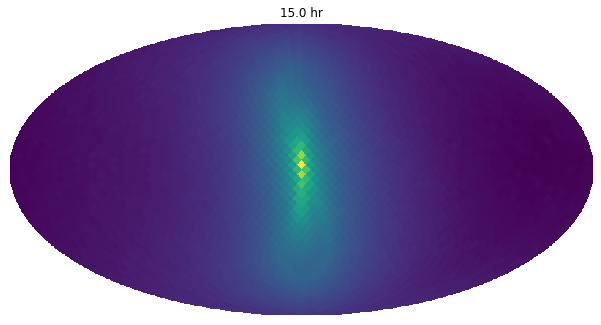

(3072, 3072)
(3072, 3072)
(3072, 3072)


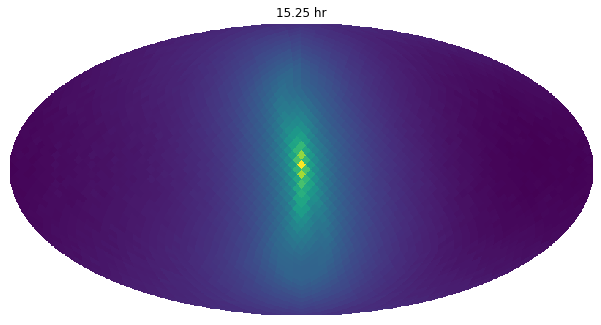

(3072, 3072)
(3072, 3072)
(3072, 3072)


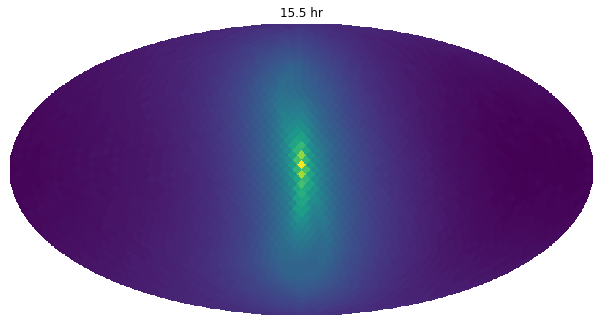

(3072, 3072)
(3072, 3072)
(3072, 3072)


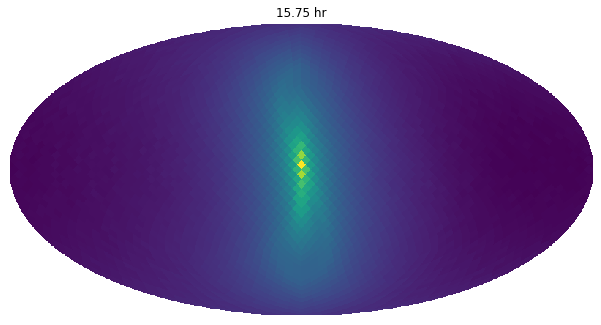

(3072, 3072)
(3072, 3072)
(3072, 3072)


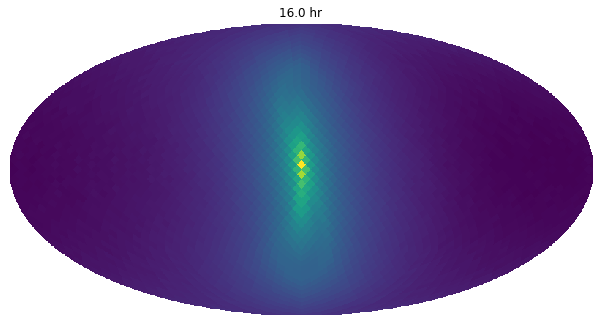

(3072, 3072)
(3072, 3072)
(3072, 3072)


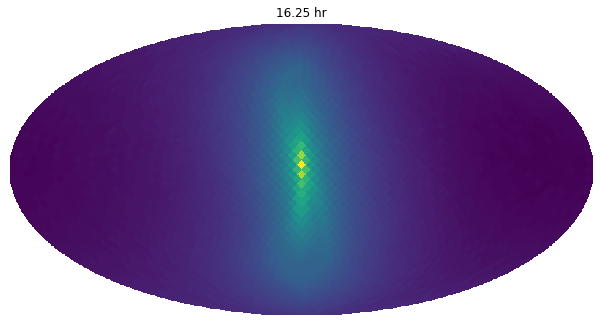

(3072, 3072)
(3072, 3072)
(3072, 3072)


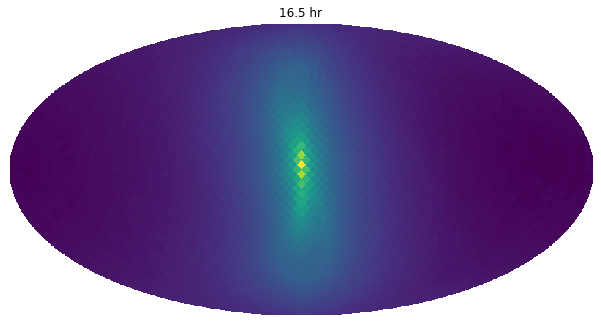

(3072, 3072)
(3072, 3072)
(3072, 3072)


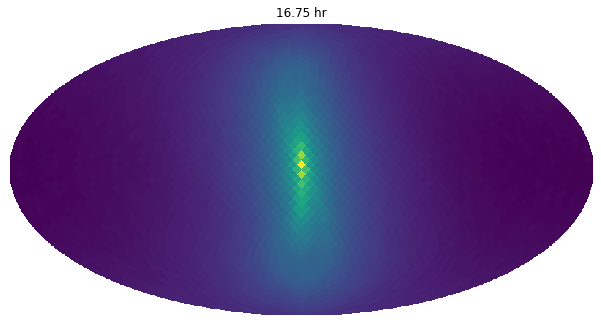

(3072, 3072)
(3072, 3072)
(3072, 3072)


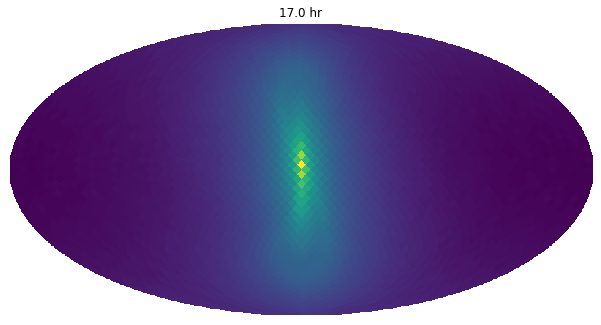

(3072, 3072)
(3072, 3072)
(3072, 3072)


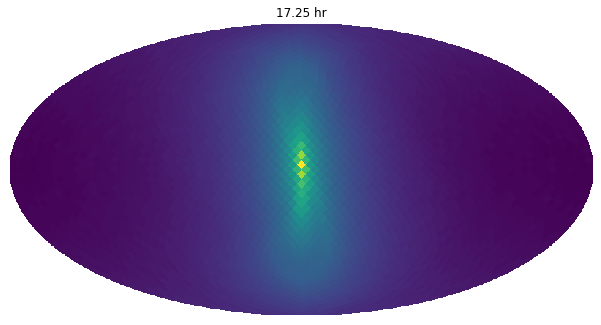

(3072, 3072)
(3072, 3072)
(3072, 3072)


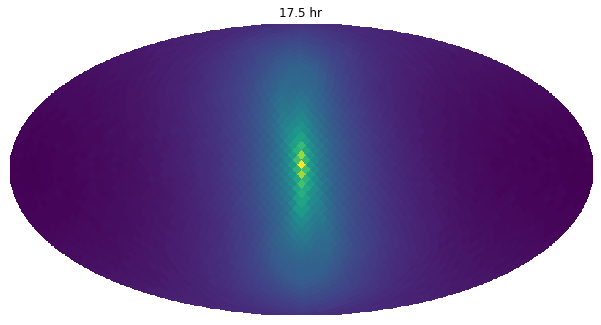

(3072, 3072)
(3072, 3072)
(3072, 3072)


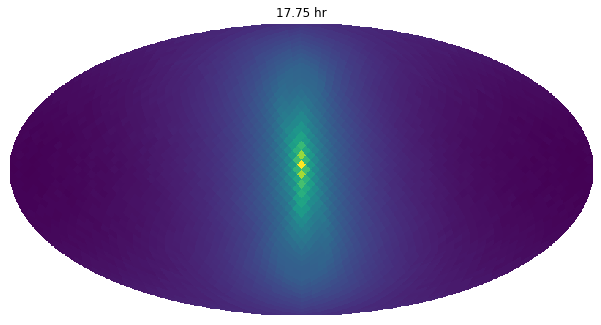

(3072, 3072)
(3072, 3072)
(3072, 3072)


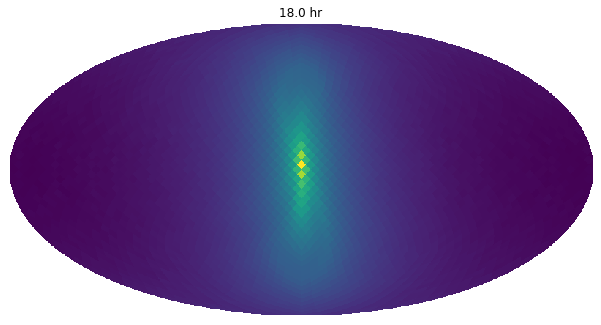

(3072, 3072)
(3072, 3072)
(3072, 3072)


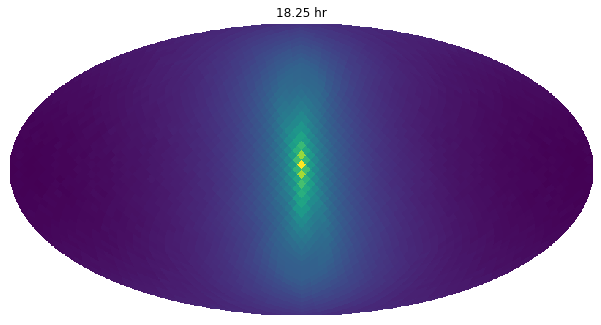

(3072, 3072)
(3072, 3072)
(3072, 3072)


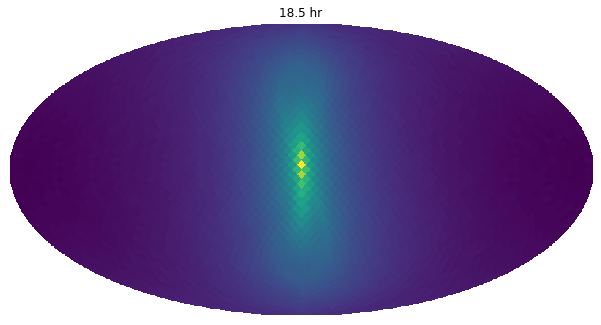

(3072, 3072)
(3072, 3072)
(3072, 3072)


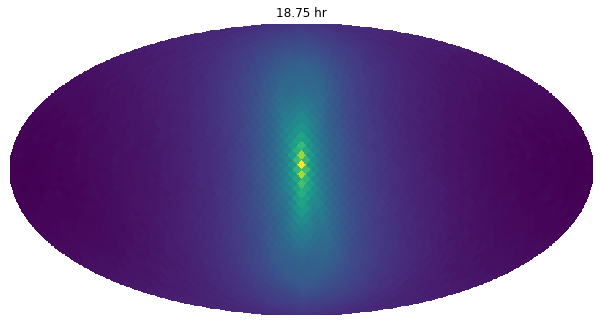

(3072, 3072)
(3072, 3072)
(3072, 3072)


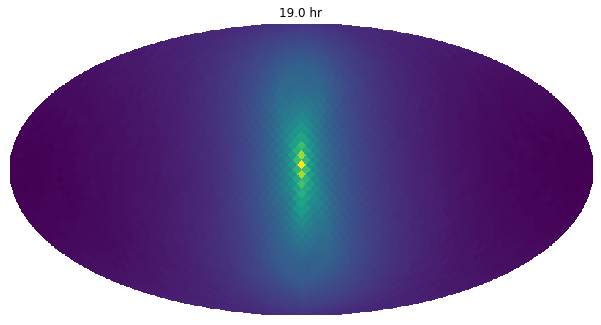

(3072, 3072)
(3072, 3072)
(3072, 3072)


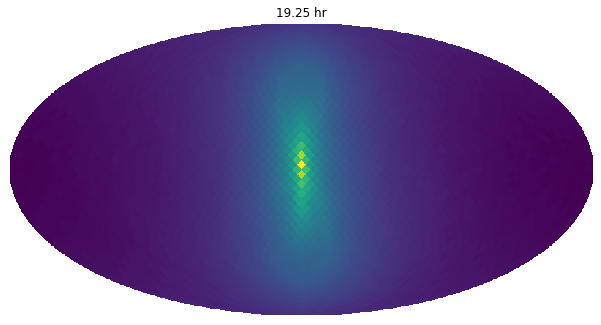

(3072, 3072)
(3072, 3072)
(3072, 3072)


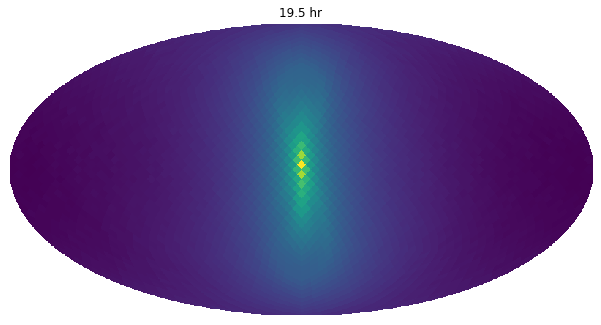

(3072, 3072)
(3072, 3072)
(3072, 3072)


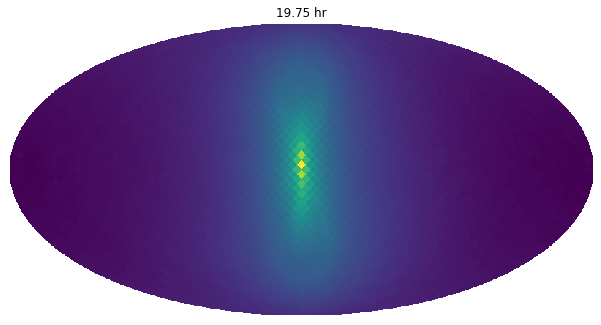

(3072, 3072)
(3072, 3072)
(3072, 3072)


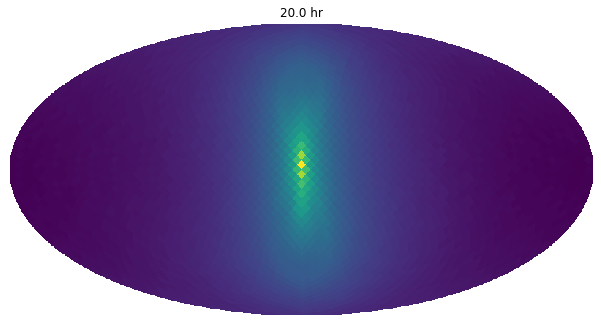

(3072, 3072)
(3072, 3072)
(3072, 3072)


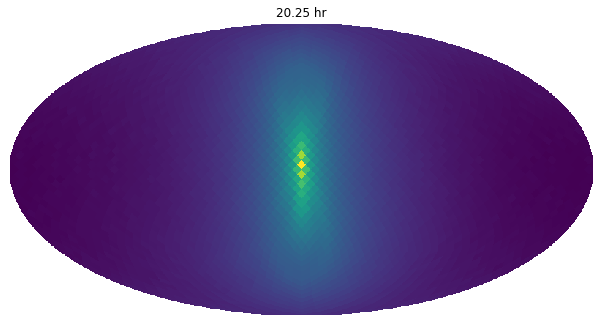

(3072, 3072)
(3072, 3072)
(3072, 3072)


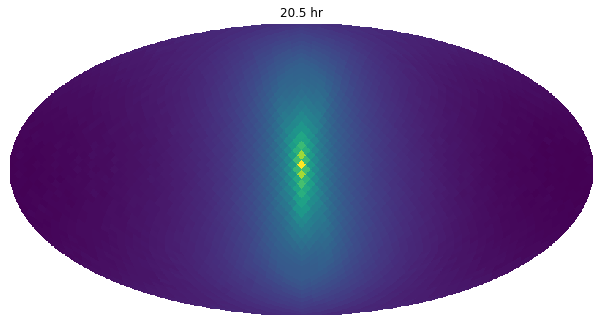

(3072, 3072)
(3072, 3072)
(3072, 3072)


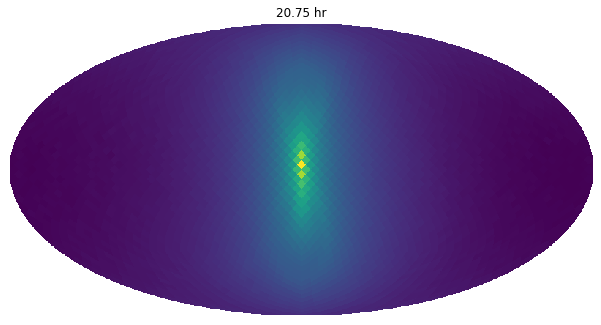

(3072, 3072)
(3072, 3072)
(3072, 3072)


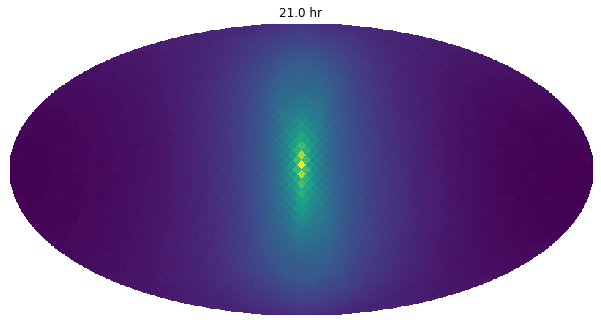

(3072, 3072)
(3072, 3072)
(3072, 3072)


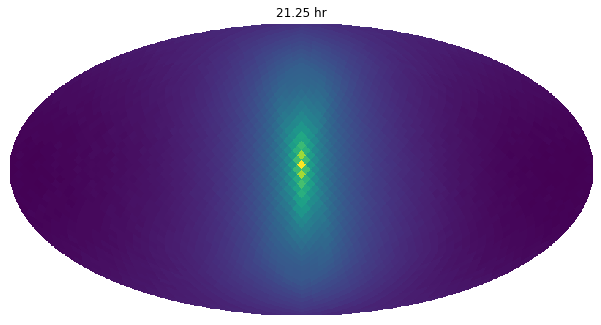

(3072, 3072)
(3072, 3072)
(3072, 3072)


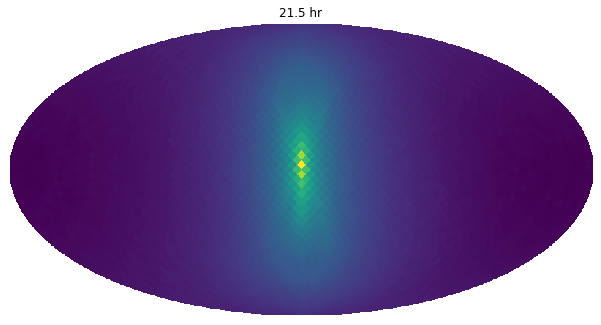

(3072, 3072)
(3072, 3072)
(3072, 3072)


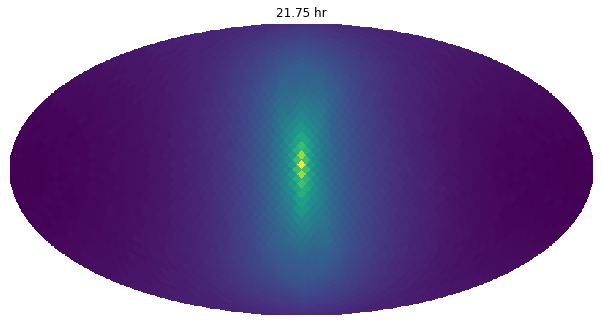

(3072, 3072)
(3072, 3072)
(3072, 3072)


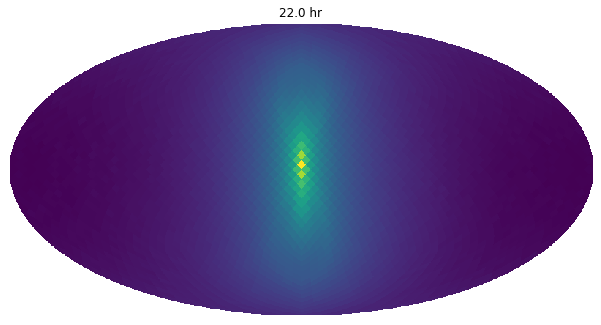

(3072, 3072)
(3072, 3072)
(3072, 3072)


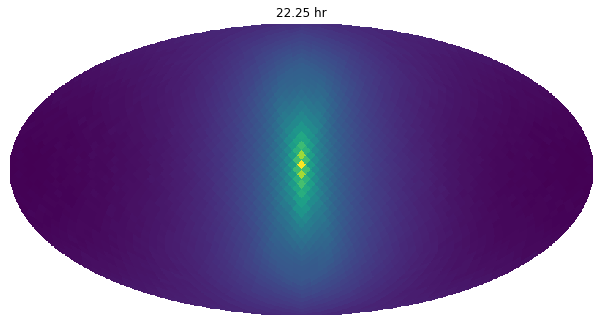

(3072, 3072)
(3072, 3072)
(3072, 3072)


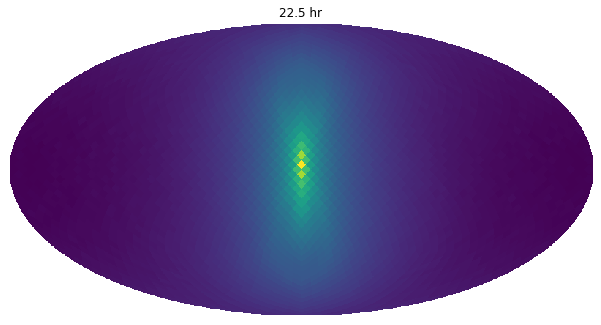

(3072, 3072)
(3072, 3072)
(3072, 3072)


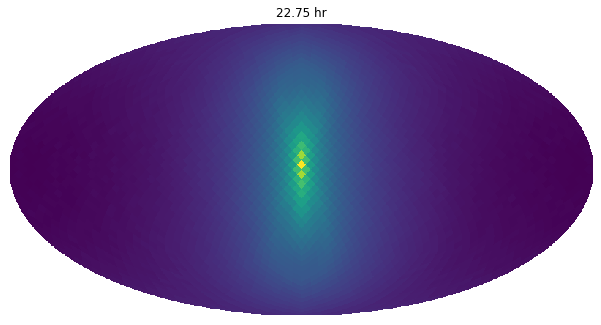

(3072, 3072)
(3072, 3072)
(3072, 3072)


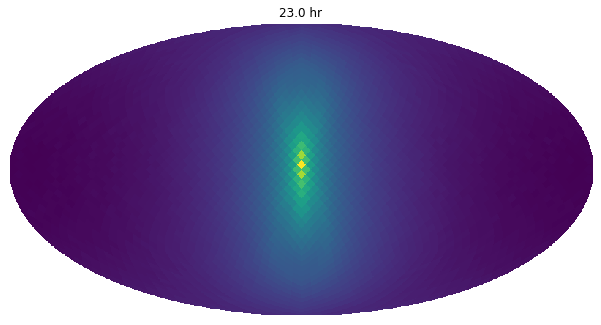

(3072, 3072)
(3072, 3072)
(3072, 3072)


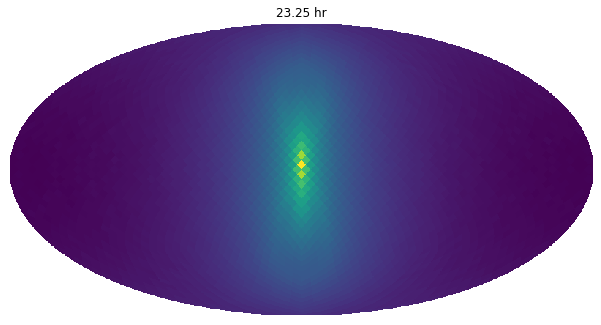

(3072, 3072)
(3072, 3072)
(3072, 3072)


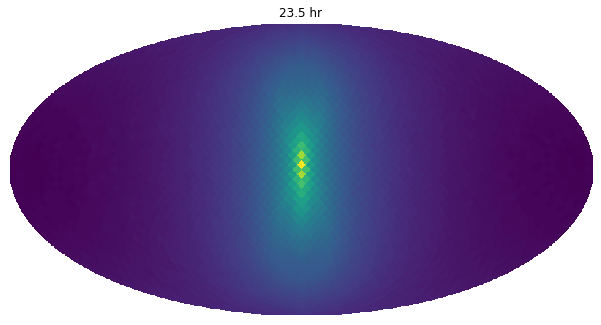

(3072, 3072)
(3072, 3072)
(3072, 3072)


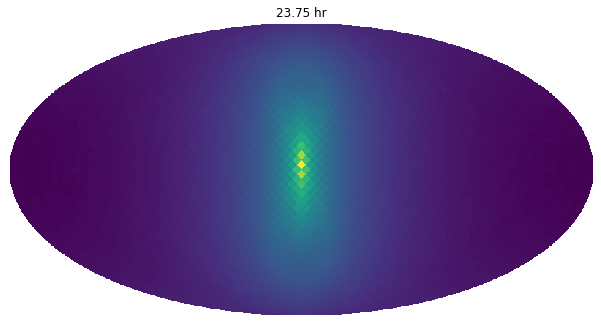

In [23]:
#cumulative_dirty = np.zeros(hp.nside2npix(nside), dtype="complex128")
cumulative_fisher = np.zeros((hp.nside2npix(nside), hp.nside2npix(nside)), dtype="complex128")
dx_IJ = [x_H-x_L, x_H-x_V, x_L-x_V]
for i, t in enumerate(np.arange(0, 86400, 900)):
    for dx in dx_IJ:
        orf = [np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(dx, t=t, t0=0), n_hat(theta, phi))/c)\
               for f in freqs]
        orf_star = np.conjugate(orf)
        cumulative_fisher += simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
    cumulative_dirty = np.einsum("ij,j", cumulative_fisher, source)
    hp.mollview(cumulative_dirty, title = f"{t/3600} hr", cbar = False)
    
    #if i<100 and i>10:
    #    num = f"0{i}"
    #elif i<10:
    #    num = f"00{i}"
    #else:
    num = f"{i}"
    
    plt.savefig(f"./Animation/Broadband_HLV/{num}.svg", bbox_inches='tight')
    plt.savefig(f"./Animation/Broadband_HLV/{num}.png", dpi = 300, bbox_inches='tight')
    plt.show()
    plt.close()

# Testing

(786432, 2)


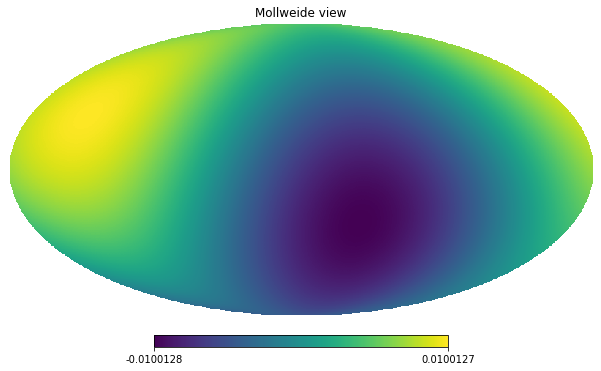

In [18]:
time_delay_HL = time_delay(x1 = x_H, x2 = x_L, nside = 256, t=0, t0=0)
print(np.shape(time_delay_HL.reshape(12*256**2,1)*np.array([0,1])))
hp.mollview(time_delay_HL, flip = "astro")

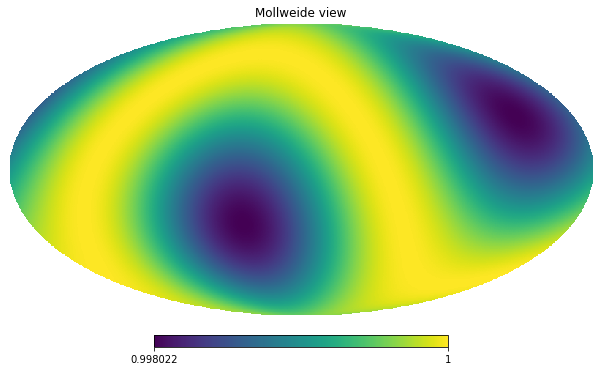

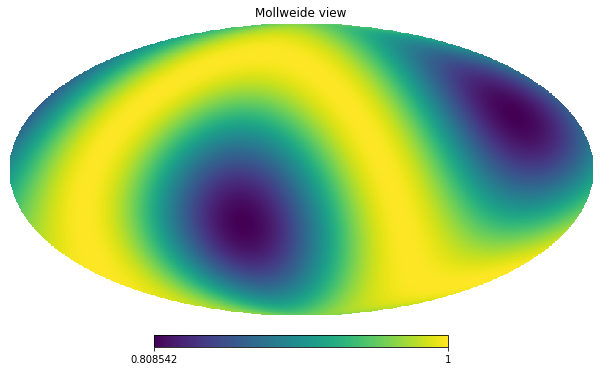

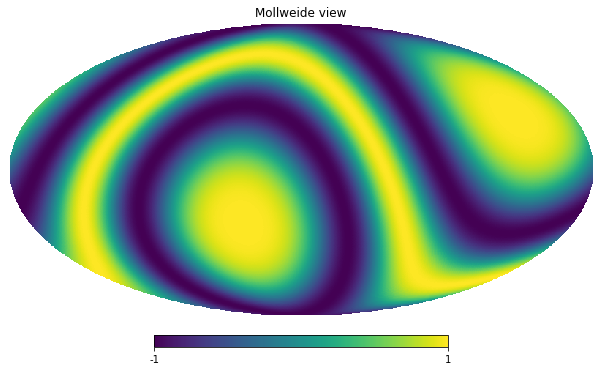

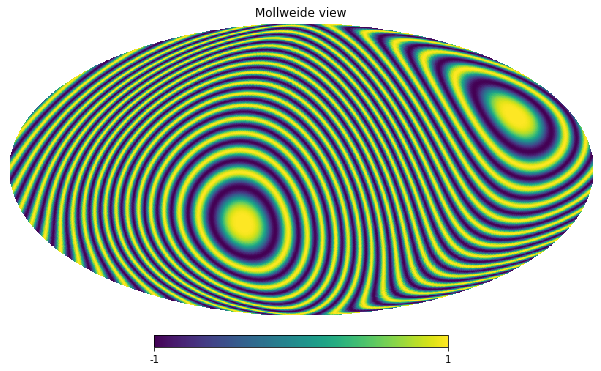

In [24]:
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*1), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*10), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*100), flip = "geo")
hp.mollview(np.exp(2*np.pi*1j*time_delay_HL*1000), flip = "geo")
#hp.mollview(np.sum(np.exp(2*np.pi*1j*time_delay_HL.reshape(12*256**2,1)*np.logspace(0,3, 100)), axis =1), flip = "astro")

In [16]:
np.shape(simple_fisher(x1 = x_H, x2 = x_L, t=[0,1], f = 1, nside = 8, t0=0))

(768, 768)

In [17]:
nside=8
f = 100
times = np.arange(0, day_s, 360)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [18]:
#HL_simple_fisher_f = simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0)
HL_simple_fisher_f = np.sum([simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0)\
                           for f in tqdm(np.logspace(0,3, 100))], axis=0)

HL_simple_fisher_f_diag =np.diag(HL_simple_fisher_f)

100%|██████████| 100/100 [03:02<00:00,  1.82s/it]


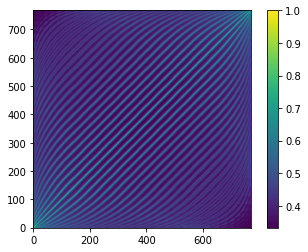

In [19]:
plt.imshow(np.real(HL_simple_fisher_f)/np.max(np.abs(HL_simple_fisher_f)), origin="lower")
plt.colorbar()
plt.show()
plt.close()

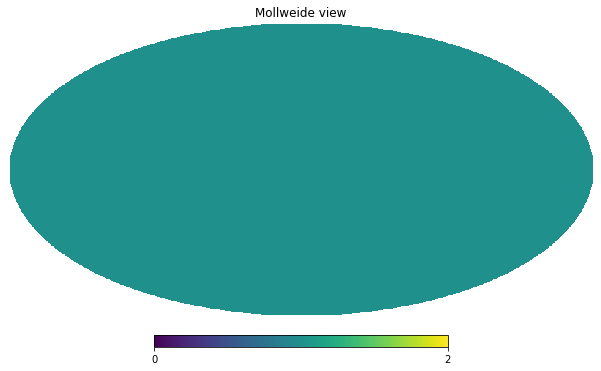

In [20]:
hp.mollview(np.real(HL_simple_fisher_f_diag)/np.max(np.abs(HL_simple_fisher_f_diag)), flip = "astro")

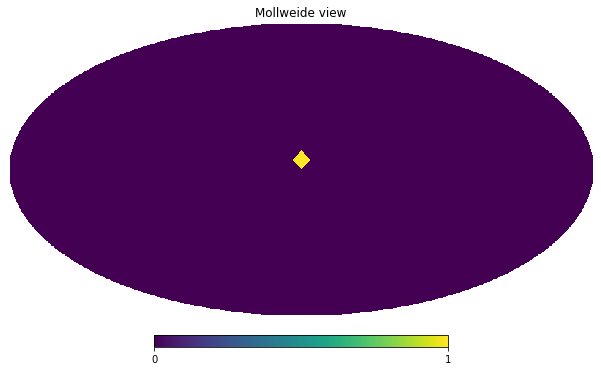

In [21]:
intensity = 1
source = np.zeros(np.shape(theta))
#print(np.pi/2,theta[theta<np.pi/2])
source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.1) & (phi==0.)]=intensity #ok for nside >8
#source[(np.abs(theta)<np.pi/2) &(theta>np.pi/2-0.2) & (phi==0.)]=intensity #ok for nside <=8
#print(source[source ==intensity])

hp.mollview(source)

/home/delillo/.local/lib/python3.8/site-packages/healpy/projector.py:201: ComplexWarning: Casting complex values to real discards the imaginary part
  img[w] = mpix


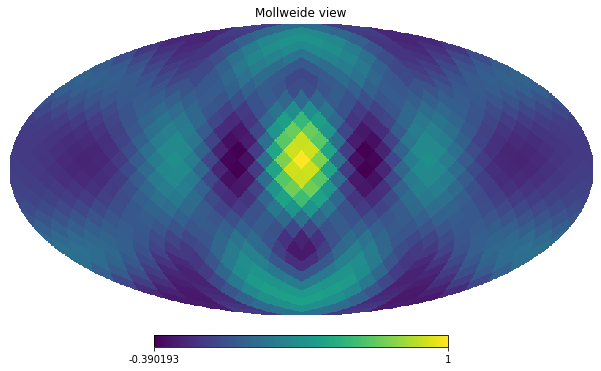

In [22]:
HL_simple_dirty_f = simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f, nside = nside, t0=0, injection=source)
hp.mollview(HL_simple_dirty_f/np.max(np.abs(HL_simple_dirty_f)), rot=(0,0,0), flip = "astro")

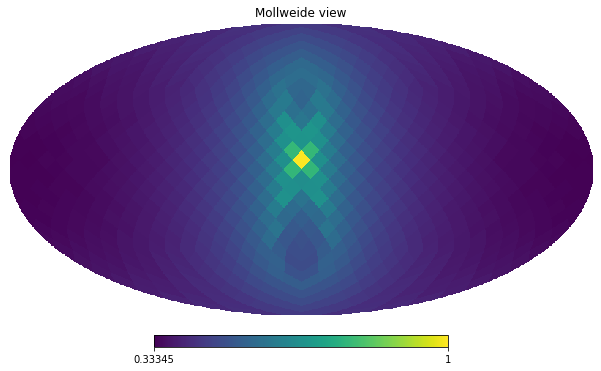

In [23]:
HL_simple_dirty = np.einsum("ij,j",HL_simple_fisher_f, source)

hp.mollview(HL_simple_dirty/np.max(np.abs(HL_simple_dirty)), rot=(0,0,0), flip = "astro")

100%|██████████| 100/100 [00:45<00:00,  2.19it/s]


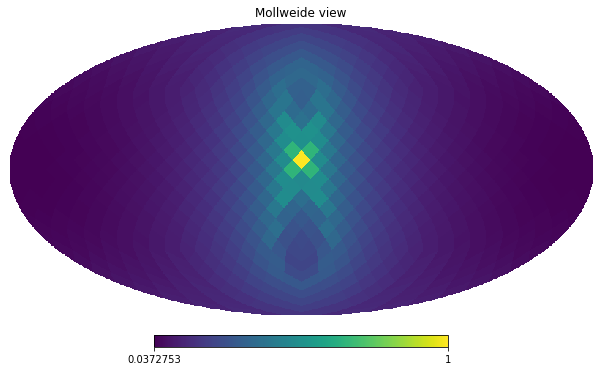

In [24]:
#HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
#                                                nside = nside, t0=0, injection=source)\
#                                                for f in [10,100,1000]], axis = 0)

HL_simple_dirty_broad = np.sum([simple_dirty_injection(x1 = x_H, x2 = x_L, t=times, f = f,\
                                                nside = nside, t0=0, injection=source)\
                                                for f in tqdm(np.logspace(1,3, 100))], axis = 0)


hp.mollview(HL_simple_dirty_broad/np.max(np.abs(HL_simple_dirty_broad)), rot=(0,0,0), flip = "astro")#, norm="log")

In [171]:
nside=16
f = 100
freqs = np.logspace(0,3, 100)
times = np.arange(0, day_s, 3600)
theta, phi = hp.pix2ang(nside, range(0, int(12*nside**2)))

In [172]:
orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=0, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(3072,) (3072,)


In [176]:
simple_fisher_numba_single_time_delay(list(orf), list(orf_star))[2][-1]

(0.9786615148615603-0.2054790483939326j)

In [177]:
simple_fisher(x1 = x_H, x2 = x_L, t=0, f = f, nside = 16, t0=0)[2][-1]

(0.9786615148615603-0.2054790483939326j)

In [59]:
%timeit simple_fisher_numba_single_time_delay(list(orf), list(orf_star))
%timeit simple_fisher(x1 = x_H, x2 = x_L, t=0, f = f, nside = 16, t0=0)

511 ms ± 58.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
103 ms ± 10.9 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [60]:
orf = np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf))

(24, 3072) (24, 3072)


In [61]:
%timeit simple_fisher_numba_multiple_time_delay(list(orf), list(orf_star))
%timeit simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = 16, t0=0)

2.41 s ± 118 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
4.37 s ± 178 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [62]:
orf = np.array([np.exp(-2*np.pi*1j*f*np.einsum("...k,kj", vector_earth_rotation(x_H-x_L, t=times, t0=0), n_hat(theta, phi))/c)\
                for f in [1,10,100,1000]])
orf_star = np.conjugate(orf)
print(np.shape(orf), np.shape(orf_star))
print(np.shape(orf.reshape(-1, *orf.shape[-1:])))

(4, 24, 3072) (4, 24, 3072)
(96, 3072)


In [63]:
%timeit simple_fisher_numba_multiple_time_delay(list(orf.reshape(-1, *orf.shape[-1:])), list(orf_star.reshape(-1, *orf_star.shape[-1:])))
%timeit [simple_fisher(x1 = x_H, x2 = x_L, t=times, f = f, nside = 16, t0=0) for f in [1,10,100,1000]]

6.45 s ± 1.04 s per loop (mean ± std. dev. of 7 runs, 1 loop each)
15.9 s ± 912 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [156]:
a= [[0. + 0.j for i in range(0,3)] for i in range(0,3)]
print(a)
a[0][0] += 1
print(a)

[[0j, 0j, 0j], [0j, 0j, 0j], [0j, 0j, 0j]]
[[(1+0j), 0j, 0j], [0j, 0j, 0j], [0j, 0j, 0j]]


In [150]:
a=[[1, 2, 3], [4, 5, 6], [7,8,9]]
print(a[0], a[0][0])

[1, 2, 3] 1


In [198]:
%time HL_simple_fisher_broad = simple_fisher_numba_multiple_time_delay(list(orf.reshape(-1, *orf.shape[-1:])), list(orf_star.reshape(-1, *orf_star.shape[-1:])))

(768, 768)
CPU times: user 12.6 s, sys: 64.9 ms, total: 12.6 s
Wall time: 12.5 s


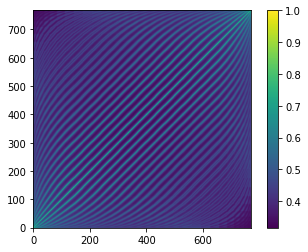

In [199]:
plt.imshow(np.real(HL_simple_fisher_broad)/np.max(np.abs(HL_simple_fisher_broad)), origin="lower")
plt.colorbar()
plt.show()
plt.close()